# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

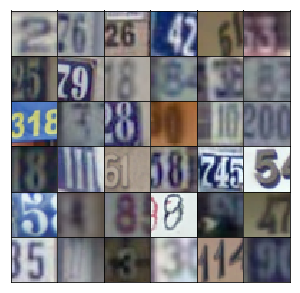

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, is_training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        
        x = tf.reshape(x, (-1, 4, 4, 512))
        x = tf.layers.batch_normalization(x, training=is_training)
        x = tf.maximum(alpha * x, x) # leaky ReLU
        # -> 4x4x512
        
        x = tf.layers.conv2d_transpose(x, 256, 5, strides=(2,2), padding='same')
        x = tf.layers.batch_normalization(x, training=is_training)
        x = tf.maximum(alpha * x, x)
        # -> 8x8x256
        
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=(2,2), padding='same')
        x = tf.layers.batch_normalization(x, training=is_training)
        x = tf.maximum(alpha * x, x)
        # 16x16x128
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x, output_dim, 5, strides=(2,2), padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=(2,2), padding='same')
        x = tf.maximum(alpha * x, x)
        # -> 16x16x64
        
        x = tf.layers.conv2d(x, 128, 5, strides=(2,2), padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        # -> 8x8x128
        
        x = tf.layers.conv2d(x, 256, 5, strides=(2,2), padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        # -> 4x4x256
        
        # flatten
        x = tf.reshape(x, (-1, 4*4*256))
        logits = tf.layers.dense(x, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, is_training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1482... Generator Loss: 0.8068
Epoch 1/25... Discriminator Loss: 0.3830... Generator Loss: 2.1107
Epoch 1/25... Discriminator Loss: 0.2015... Generator Loss: 2.0728
Epoch 1/25... Discriminator Loss: 0.1287... Generator Loss: 2.8434
Epoch 1/25... Discriminator Loss: 0.2142... Generator Loss: 2.3575
Epoch 1/25... Discriminator Loss: 0.1264... Generator Loss: 2.9162
Epoch 1/25... Discriminator Loss: 0.2179... Generator Loss: 2.3272
Epoch 1/25... Discriminator Loss: 0.1059... Generator Loss: 3.7139
Epoch 1/25... Discriminator Loss: 0.1069... Generator Loss: 3.3289
Epoch 1/25... Discriminator Loss: 0.1181... Generator Loss: 3.0683


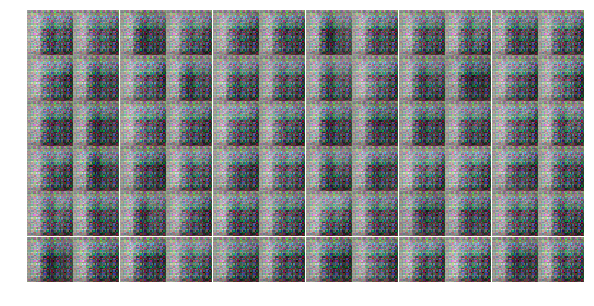

Epoch 1/25... Discriminator Loss: 0.1509... Generator Loss: 2.7189
Epoch 1/25... Discriminator Loss: 1.0334... Generator Loss: 1.5653
Epoch 1/25... Discriminator Loss: 0.9136... Generator Loss: 0.7666
Epoch 1/25... Discriminator Loss: 0.5216... Generator Loss: 1.8154
Epoch 1/25... Discriminator Loss: 0.4765... Generator Loss: 2.9665
Epoch 1/25... Discriminator Loss: 0.3453... Generator Loss: 2.3724
Epoch 1/25... Discriminator Loss: 0.3551... Generator Loss: 2.1062
Epoch 1/25... Discriminator Loss: 0.2085... Generator Loss: 3.7850
Epoch 1/25... Discriminator Loss: 0.3819... Generator Loss: 1.8569
Epoch 1/25... Discriminator Loss: 0.2583... Generator Loss: 2.2988


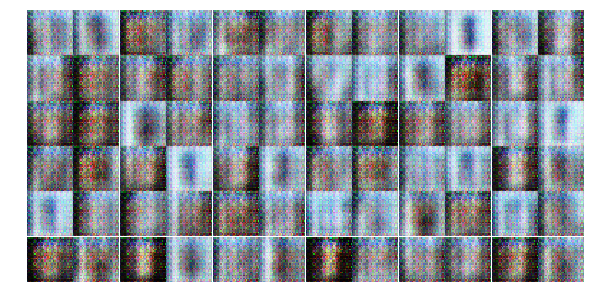

Epoch 1/25... Discriminator Loss: 1.1683... Generator Loss: 2.3119
Epoch 1/25... Discriminator Loss: 0.2556... Generator Loss: 2.1634
Epoch 1/25... Discriminator Loss: 0.4466... Generator Loss: 1.6413
Epoch 1/25... Discriminator Loss: 1.0351... Generator Loss: 1.0464
Epoch 1/25... Discriminator Loss: 0.1599... Generator Loss: 4.5896
Epoch 1/25... Discriminator Loss: 1.1663... Generator Loss: 0.5414
Epoch 1/25... Discriminator Loss: 0.3664... Generator Loss: 1.4712
Epoch 1/25... Discriminator Loss: 1.2661... Generator Loss: 0.5540
Epoch 1/25... Discriminator Loss: 0.6383... Generator Loss: 1.2071
Epoch 1/25... Discriminator Loss: 0.7332... Generator Loss: 0.8831


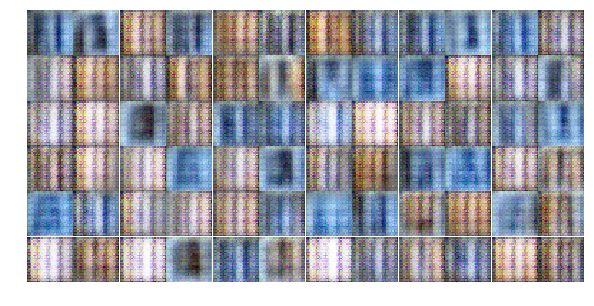

Epoch 1/25... Discriminator Loss: 0.8124... Generator Loss: 1.1284
Epoch 1/25... Discriminator Loss: 0.6249... Generator Loss: 1.5457
Epoch 1/25... Discriminator Loss: 0.7406... Generator Loss: 1.2611
Epoch 1/25... Discriminator Loss: 1.1933... Generator Loss: 0.7438
Epoch 1/25... Discriminator Loss: 0.5598... Generator Loss: 1.7842
Epoch 1/25... Discriminator Loss: 0.4181... Generator Loss: 2.0064
Epoch 1/25... Discriminator Loss: 0.5883... Generator Loss: 1.6633
Epoch 1/25... Discriminator Loss: 0.3286... Generator Loss: 2.9778
Epoch 1/25... Discriminator Loss: 0.3828... Generator Loss: 1.5793
Epoch 1/25... Discriminator Loss: 0.5068... Generator Loss: 2.5483


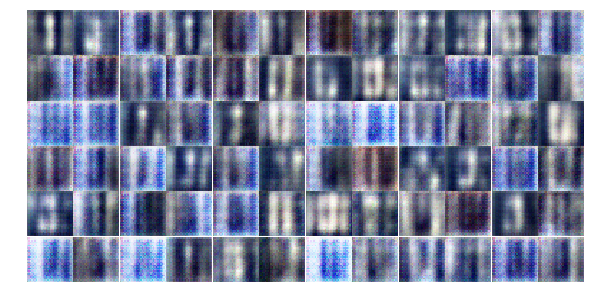

Epoch 1/25... Discriminator Loss: 0.6771... Generator Loss: 1.4670
Epoch 1/25... Discriminator Loss: 0.6984... Generator Loss: 1.4498
Epoch 1/25... Discriminator Loss: 0.3073... Generator Loss: 2.4585
Epoch 1/25... Discriminator Loss: 0.6255... Generator Loss: 2.1543
Epoch 1/25... Discriminator Loss: 0.5441... Generator Loss: 1.1053
Epoch 1/25... Discriminator Loss: 0.2831... Generator Loss: 3.9403
Epoch 1/25... Discriminator Loss: 0.3924... Generator Loss: 1.8849
Epoch 1/25... Discriminator Loss: 0.4166... Generator Loss: 1.5279
Epoch 1/25... Discriminator Loss: 0.6925... Generator Loss: 3.0856
Epoch 1/25... Discriminator Loss: 0.4973... Generator Loss: 3.0110


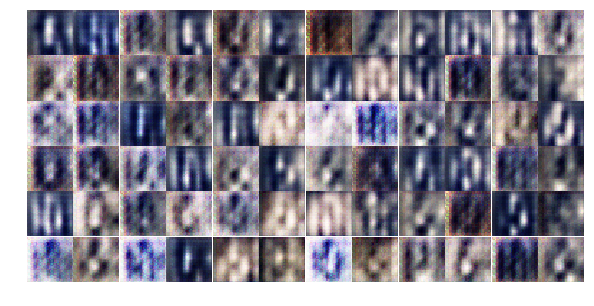

Epoch 1/25... Discriminator Loss: 1.0393... Generator Loss: 0.9389
Epoch 1/25... Discriminator Loss: 0.5079... Generator Loss: 1.4148
Epoch 1/25... Discriminator Loss: 0.5312... Generator Loss: 1.6912
Epoch 1/25... Discriminator Loss: 0.8144... Generator Loss: 1.0007
Epoch 1/25... Discriminator Loss: 1.3208... Generator Loss: 5.3052
Epoch 1/25... Discriminator Loss: 0.7595... Generator Loss: 1.3013
Epoch 1/25... Discriminator Loss: 0.5070... Generator Loss: 1.4795
Epoch 2/25... Discriminator Loss: 0.5010... Generator Loss: 2.4868
Epoch 2/25... Discriminator Loss: 0.5587... Generator Loss: 1.7947
Epoch 2/25... Discriminator Loss: 0.6250... Generator Loss: 1.5712


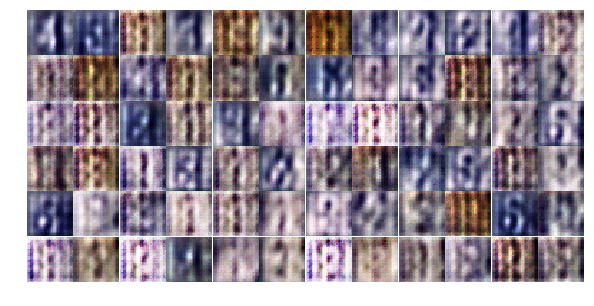

Epoch 2/25... Discriminator Loss: 0.4653... Generator Loss: 1.8545
Epoch 2/25... Discriminator Loss: 0.6712... Generator Loss: 1.1682
Epoch 2/25... Discriminator Loss: 0.7929... Generator Loss: 1.1657
Epoch 2/25... Discriminator Loss: 0.6534... Generator Loss: 1.8589
Epoch 2/25... Discriminator Loss: 0.5784... Generator Loss: 2.3410
Epoch 2/25... Discriminator Loss: 0.6393... Generator Loss: 1.7562
Epoch 2/25... Discriminator Loss: 0.7252... Generator Loss: 1.3441
Epoch 2/25... Discriminator Loss: 0.7959... Generator Loss: 1.7712
Epoch 2/25... Discriminator Loss: 0.8259... Generator Loss: 1.2397
Epoch 2/25... Discriminator Loss: 0.7905... Generator Loss: 1.7037


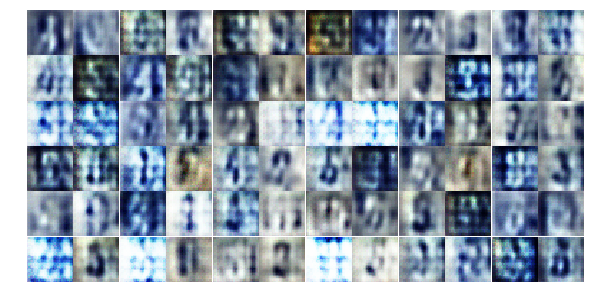

Epoch 2/25... Discriminator Loss: 0.7897... Generator Loss: 1.1823
Epoch 2/25... Discriminator Loss: 0.6035... Generator Loss: 2.0818
Epoch 2/25... Discriminator Loss: 1.4387... Generator Loss: 0.4562
Epoch 2/25... Discriminator Loss: 0.7903... Generator Loss: 1.5557
Epoch 2/25... Discriminator Loss: 0.7321... Generator Loss: 1.4669
Epoch 2/25... Discriminator Loss: 0.8341... Generator Loss: 1.3231
Epoch 2/25... Discriminator Loss: 0.9296... Generator Loss: 0.9817
Epoch 2/25... Discriminator Loss: 1.0375... Generator Loss: 1.2603
Epoch 2/25... Discriminator Loss: 0.8197... Generator Loss: 1.3758
Epoch 2/25... Discriminator Loss: 0.8748... Generator Loss: 0.9010


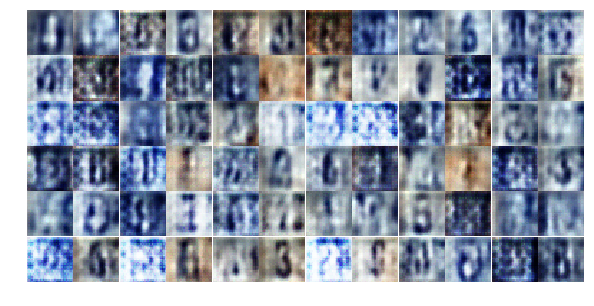

Epoch 2/25... Discriminator Loss: 0.9442... Generator Loss: 1.0571
Epoch 2/25... Discriminator Loss: 0.8279... Generator Loss: 1.2877
Epoch 2/25... Discriminator Loss: 0.7185... Generator Loss: 1.4421
Epoch 2/25... Discriminator Loss: 0.9411... Generator Loss: 1.3554
Epoch 2/25... Discriminator Loss: 1.0459... Generator Loss: 1.2595
Epoch 2/25... Discriminator Loss: 0.7786... Generator Loss: 1.4503
Epoch 2/25... Discriminator Loss: 0.6129... Generator Loss: 1.4089
Epoch 2/25... Discriminator Loss: 0.8459... Generator Loss: 1.4597
Epoch 2/25... Discriminator Loss: 1.2824... Generator Loss: 0.7301
Epoch 2/25... Discriminator Loss: 0.9456... Generator Loss: 1.2739


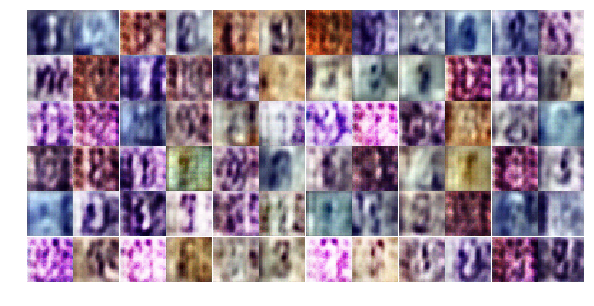

Epoch 2/25... Discriminator Loss: 1.0059... Generator Loss: 0.8946
Epoch 2/25... Discriminator Loss: 0.9139... Generator Loss: 1.1623
Epoch 2/25... Discriminator Loss: 1.0129... Generator Loss: 0.8034
Epoch 2/25... Discriminator Loss: 0.9601... Generator Loss: 0.9480
Epoch 2/25... Discriminator Loss: 1.1473... Generator Loss: 1.4254
Epoch 2/25... Discriminator Loss: 0.9118... Generator Loss: 1.1604
Epoch 2/25... Discriminator Loss: 1.0328... Generator Loss: 0.9837
Epoch 2/25... Discriminator Loss: 0.8279... Generator Loss: 1.2052
Epoch 2/25... Discriminator Loss: 0.8973... Generator Loss: 1.1429
Epoch 2/25... Discriminator Loss: 0.7021... Generator Loss: 1.4533


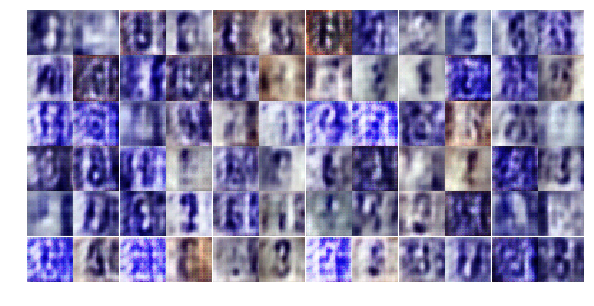

Epoch 2/25... Discriminator Loss: 0.8386... Generator Loss: 1.5040
Epoch 2/25... Discriminator Loss: 1.5606... Generator Loss: 0.8253
Epoch 2/25... Discriminator Loss: 1.0492... Generator Loss: 0.9738
Epoch 2/25... Discriminator Loss: 1.0012... Generator Loss: 0.8765
Epoch 2/25... Discriminator Loss: 1.0300... Generator Loss: 0.9805
Epoch 2/25... Discriminator Loss: 0.9756... Generator Loss: 0.8317
Epoch 2/25... Discriminator Loss: 0.8881... Generator Loss: 1.5827
Epoch 2/25... Discriminator Loss: 0.9026... Generator Loss: 1.2800
Epoch 2/25... Discriminator Loss: 0.7391... Generator Loss: 1.5259
Epoch 2/25... Discriminator Loss: 0.8508... Generator Loss: 1.7112


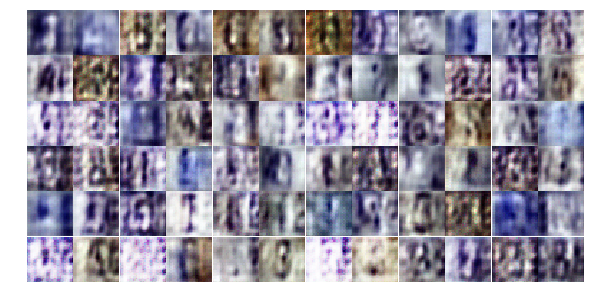

Epoch 2/25... Discriminator Loss: 0.7742... Generator Loss: 1.5411
Epoch 2/25... Discriminator Loss: 1.1517... Generator Loss: 0.7921
Epoch 2/25... Discriminator Loss: 1.1747... Generator Loss: 0.6796
Epoch 2/25... Discriminator Loss: 0.7682... Generator Loss: 1.1030
Epoch 3/25... Discriminator Loss: 0.7982... Generator Loss: 1.9188
Epoch 3/25... Discriminator Loss: 0.9551... Generator Loss: 0.8995
Epoch 3/25... Discriminator Loss: 0.7016... Generator Loss: 1.5795
Epoch 3/25... Discriminator Loss: 1.0626... Generator Loss: 0.6819
Epoch 3/25... Discriminator Loss: 0.6941... Generator Loss: 1.3778
Epoch 3/25... Discriminator Loss: 0.9565... Generator Loss: 1.2725


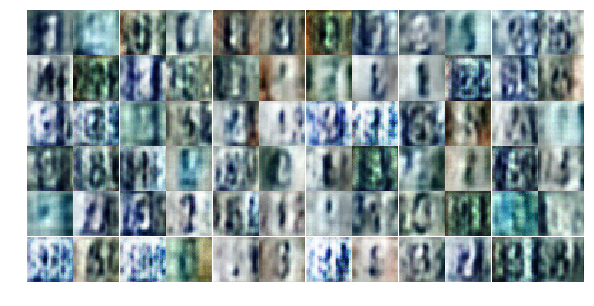

Epoch 3/25... Discriminator Loss: 0.7041... Generator Loss: 1.4417
Epoch 3/25... Discriminator Loss: 0.5899... Generator Loss: 1.7599
Epoch 3/25... Discriminator Loss: 0.8430... Generator Loss: 0.9666
Epoch 3/25... Discriminator Loss: 0.6624... Generator Loss: 1.4257
Epoch 3/25... Discriminator Loss: 0.8692... Generator Loss: 0.8395
Epoch 3/25... Discriminator Loss: 0.7245... Generator Loss: 1.1407
Epoch 3/25... Discriminator Loss: 0.5873... Generator Loss: 1.2373
Epoch 3/25... Discriminator Loss: 0.7258... Generator Loss: 1.3247
Epoch 3/25... Discriminator Loss: 0.9062... Generator Loss: 2.1346
Epoch 3/25... Discriminator Loss: 0.8085... Generator Loss: 0.9188


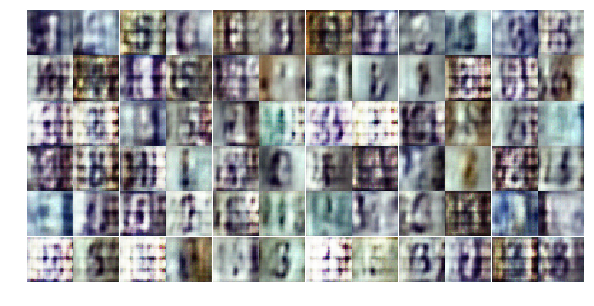

Epoch 3/25... Discriminator Loss: 0.8093... Generator Loss: 2.0699
Epoch 3/25... Discriminator Loss: 0.8487... Generator Loss: 1.3252
Epoch 3/25... Discriminator Loss: 0.4970... Generator Loss: 1.6892
Epoch 3/25... Discriminator Loss: 0.6589... Generator Loss: 2.7706
Epoch 3/25... Discriminator Loss: 1.1528... Generator Loss: 2.8340
Epoch 3/25... Discriminator Loss: 0.7610... Generator Loss: 1.1447
Epoch 3/25... Discriminator Loss: 1.0439... Generator Loss: 0.5820
Epoch 3/25... Discriminator Loss: 0.7681... Generator Loss: 1.9384
Epoch 3/25... Discriminator Loss: 0.4012... Generator Loss: 2.1638
Epoch 3/25... Discriminator Loss: 0.7220... Generator Loss: 1.1242


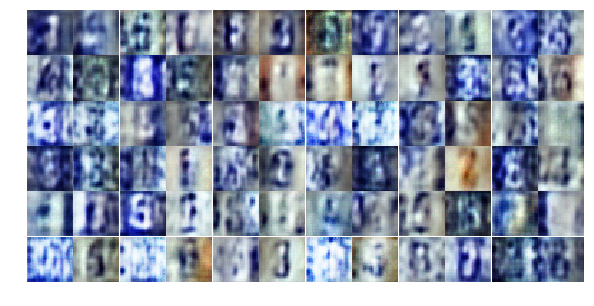

Epoch 3/25... Discriminator Loss: 0.4574... Generator Loss: 1.5394
Epoch 3/25... Discriminator Loss: 0.5212... Generator Loss: 1.4308
Epoch 3/25... Discriminator Loss: 0.3055... Generator Loss: 2.0381
Epoch 3/25... Discriminator Loss: 0.8092... Generator Loss: 2.3939
Epoch 3/25... Discriminator Loss: 0.5975... Generator Loss: 1.9583
Epoch 3/25... Discriminator Loss: 0.7638... Generator Loss: 0.9283
Epoch 3/25... Discriminator Loss: 0.8198... Generator Loss: 1.0136
Epoch 3/25... Discriminator Loss: 0.6465... Generator Loss: 1.4808
Epoch 3/25... Discriminator Loss: 0.4358... Generator Loss: 2.2239
Epoch 3/25... Discriminator Loss: 0.7941... Generator Loss: 0.9159


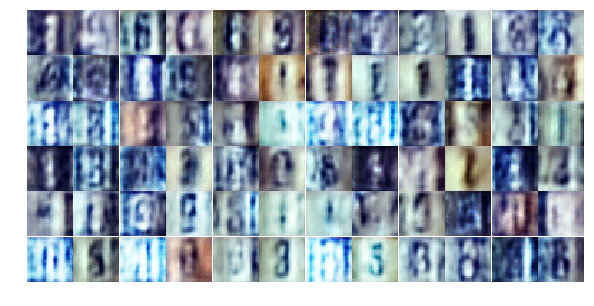

Epoch 3/25... Discriminator Loss: 0.5708... Generator Loss: 2.2447
Epoch 3/25... Discriminator Loss: 0.3604... Generator Loss: 1.9043
Epoch 3/25... Discriminator Loss: 0.7783... Generator Loss: 1.0765
Epoch 3/25... Discriminator Loss: 0.6029... Generator Loss: 1.9387
Epoch 3/25... Discriminator Loss: 0.6995... Generator Loss: 2.2499
Epoch 3/25... Discriminator Loss: 0.5567... Generator Loss: 1.7221
Epoch 3/25... Discriminator Loss: 0.6323... Generator Loss: 1.7957
Epoch 3/25... Discriminator Loss: 0.4529... Generator Loss: 2.0436
Epoch 3/25... Discriminator Loss: 0.9937... Generator Loss: 0.7337
Epoch 3/25... Discriminator Loss: 0.4840... Generator Loss: 1.6101


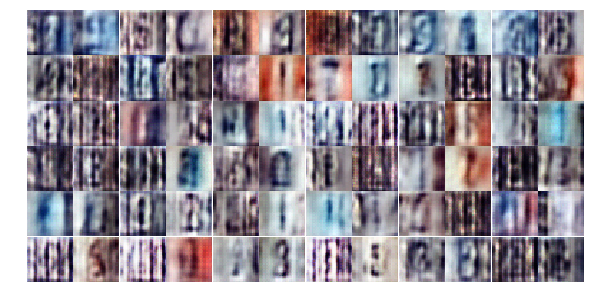

Epoch 3/25... Discriminator Loss: 1.0063... Generator Loss: 0.8722
Epoch 3/25... Discriminator Loss: 0.4258... Generator Loss: 1.5005
Epoch 3/25... Discriminator Loss: 1.0499... Generator Loss: 2.7306
Epoch 3/25... Discriminator Loss: 0.2944... Generator Loss: 2.1495
Epoch 3/25... Discriminator Loss: 1.0863... Generator Loss: 3.3804
Epoch 3/25... Discriminator Loss: 0.5085... Generator Loss: 1.6975
Epoch 3/25... Discriminator Loss: 0.5445... Generator Loss: 1.4789
Epoch 3/25... Discriminator Loss: 0.3832... Generator Loss: 2.3997
Epoch 3/25... Discriminator Loss: 0.5565... Generator Loss: 1.3274
Epoch 3/25... Discriminator Loss: 0.3421... Generator Loss: 2.3010


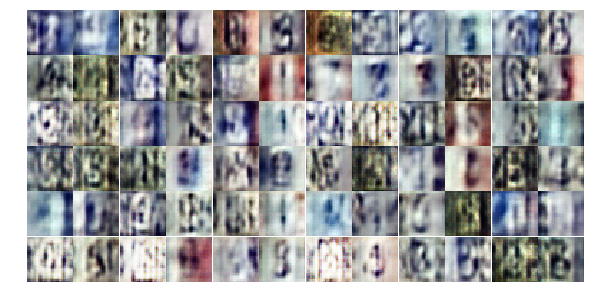

Epoch 3/25... Discriminator Loss: 0.6517... Generator Loss: 1.1812
Epoch 4/25... Discriminator Loss: 0.6436... Generator Loss: 1.5266
Epoch 4/25... Discriminator Loss: 0.3881... Generator Loss: 1.9837
Epoch 4/25... Discriminator Loss: 0.5786... Generator Loss: 1.2937
Epoch 4/25... Discriminator Loss: 0.4319... Generator Loss: 1.8215
Epoch 4/25... Discriminator Loss: 0.3072... Generator Loss: 2.1439
Epoch 4/25... Discriminator Loss: 1.2468... Generator Loss: 0.6631
Epoch 4/25... Discriminator Loss: 0.8132... Generator Loss: 1.2601
Epoch 4/25... Discriminator Loss: 0.5041... Generator Loss: 1.5425
Epoch 4/25... Discriminator Loss: 0.4978... Generator Loss: 1.9529


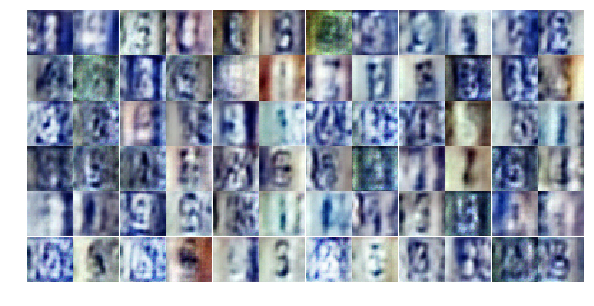

Epoch 4/25... Discriminator Loss: 0.5008... Generator Loss: 1.4401
Epoch 4/25... Discriminator Loss: 0.9588... Generator Loss: 0.6966
Epoch 4/25... Discriminator Loss: 0.6609... Generator Loss: 1.2304
Epoch 4/25... Discriminator Loss: 0.4188... Generator Loss: 1.8223
Epoch 4/25... Discriminator Loss: 0.4511... Generator Loss: 1.9719
Epoch 4/25... Discriminator Loss: 1.1048... Generator Loss: 0.5347
Epoch 4/25... Discriminator Loss: 0.5184... Generator Loss: 1.4958
Epoch 4/25... Discriminator Loss: 0.4244... Generator Loss: 1.5302
Epoch 4/25... Discriminator Loss: 0.7180... Generator Loss: 0.9080
Epoch 4/25... Discriminator Loss: 0.5291... Generator Loss: 2.2431


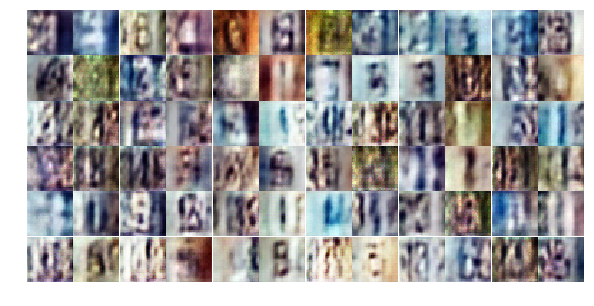

Epoch 4/25... Discriminator Loss: 0.5400... Generator Loss: 1.2609
Epoch 4/25... Discriminator Loss: 0.3289... Generator Loss: 2.1600
Epoch 4/25... Discriminator Loss: 0.1859... Generator Loss: 2.4612
Epoch 4/25... Discriminator Loss: 1.1207... Generator Loss: 0.8910
Epoch 4/25... Discriminator Loss: 0.7030... Generator Loss: 1.0883
Epoch 4/25... Discriminator Loss: 0.3860... Generator Loss: 1.9188
Epoch 4/25... Discriminator Loss: 0.6879... Generator Loss: 1.0843
Epoch 4/25... Discriminator Loss: 1.1889... Generator Loss: 0.5873
Epoch 4/25... Discriminator Loss: 0.4937... Generator Loss: 1.4340
Epoch 4/25... Discriminator Loss: 0.9628... Generator Loss: 0.6353


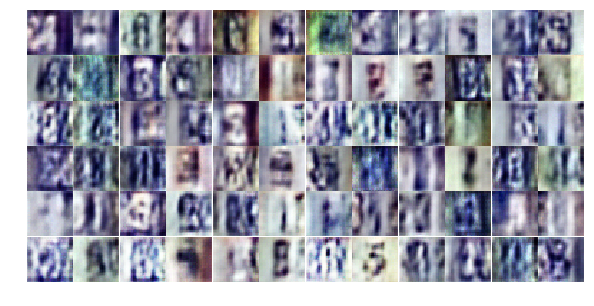

Epoch 4/25... Discriminator Loss: 0.4880... Generator Loss: 1.7088
Epoch 4/25... Discriminator Loss: 0.5807... Generator Loss: 1.6184
Epoch 4/25... Discriminator Loss: 0.7199... Generator Loss: 1.0490
Epoch 4/25... Discriminator Loss: 0.5018... Generator Loss: 1.5876
Epoch 4/25... Discriminator Loss: 0.3231... Generator Loss: 2.3320
Epoch 4/25... Discriminator Loss: 0.5320... Generator Loss: 1.3822
Epoch 4/25... Discriminator Loss: 0.7780... Generator Loss: 2.4336
Epoch 4/25... Discriminator Loss: 0.8099... Generator Loss: 0.7982
Epoch 4/25... Discriminator Loss: 0.6639... Generator Loss: 1.0252
Epoch 4/25... Discriminator Loss: 0.4998... Generator Loss: 1.4762


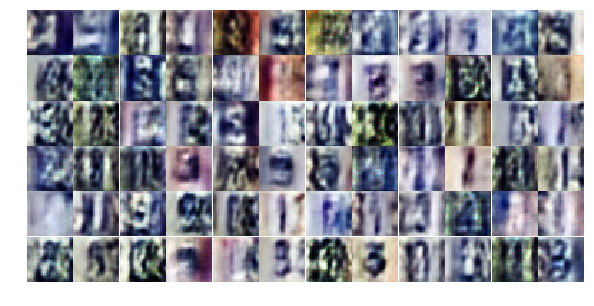

Epoch 4/25... Discriminator Loss: 0.5118... Generator Loss: 1.6805
Epoch 4/25... Discriminator Loss: 0.3595... Generator Loss: 1.5810
Epoch 4/25... Discriminator Loss: 0.6506... Generator Loss: 1.0211
Epoch 4/25... Discriminator Loss: 0.7326... Generator Loss: 0.8813
Epoch 4/25... Discriminator Loss: 0.3817... Generator Loss: 2.2090
Epoch 4/25... Discriminator Loss: 0.4973... Generator Loss: 1.7463
Epoch 4/25... Discriminator Loss: 0.4729... Generator Loss: 1.3907
Epoch 4/25... Discriminator Loss: 0.5612... Generator Loss: 1.3321
Epoch 4/25... Discriminator Loss: 0.8834... Generator Loss: 2.6461
Epoch 4/25... Discriminator Loss: 0.4310... Generator Loss: 1.8074


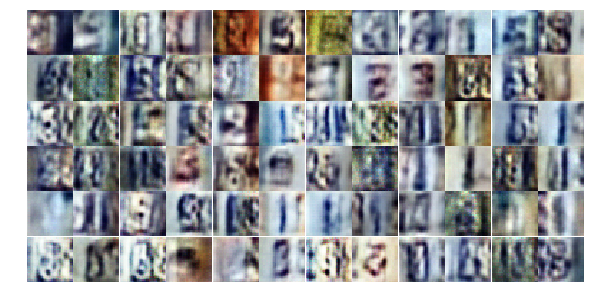

Epoch 4/25... Discriminator Loss: 0.5840... Generator Loss: 1.1710
Epoch 4/25... Discriminator Loss: 0.3968... Generator Loss: 2.0780
Epoch 4/25... Discriminator Loss: 0.5181... Generator Loss: 1.2479
Epoch 4/25... Discriminator Loss: 0.6775... Generator Loss: 2.2938
Epoch 4/25... Discriminator Loss: 0.6523... Generator Loss: 1.0525
Epoch 4/25... Discriminator Loss: 0.7580... Generator Loss: 0.9844
Epoch 4/25... Discriminator Loss: 0.4650... Generator Loss: 1.4191
Epoch 4/25... Discriminator Loss: 0.8480... Generator Loss: 0.8577
Epoch 4/25... Discriminator Loss: 0.4600... Generator Loss: 2.2985
Epoch 5/25... Discriminator Loss: 0.4882... Generator Loss: 1.2996


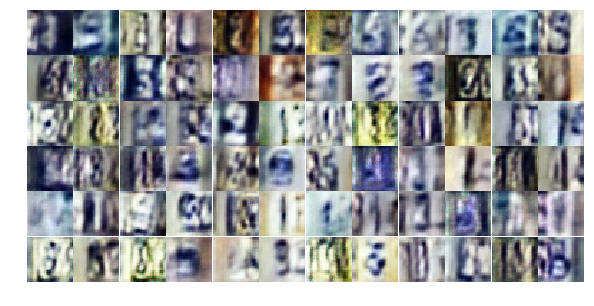

Epoch 5/25... Discriminator Loss: 0.4590... Generator Loss: 1.5831
Epoch 5/25... Discriminator Loss: 0.7510... Generator Loss: 1.0929
Epoch 5/25... Discriminator Loss: 0.4737... Generator Loss: 1.7917
Epoch 5/25... Discriminator Loss: 0.5920... Generator Loss: 1.0473
Epoch 5/25... Discriminator Loss: 0.3480... Generator Loss: 1.9736
Epoch 5/25... Discriminator Loss: 1.7671... Generator Loss: 0.3137
Epoch 5/25... Discriminator Loss: 0.5828... Generator Loss: 1.3707
Epoch 5/25... Discriminator Loss: 0.6981... Generator Loss: 0.9063
Epoch 5/25... Discriminator Loss: 0.7406... Generator Loss: 0.9299
Epoch 5/25... Discriminator Loss: 1.1859... Generator Loss: 0.6241


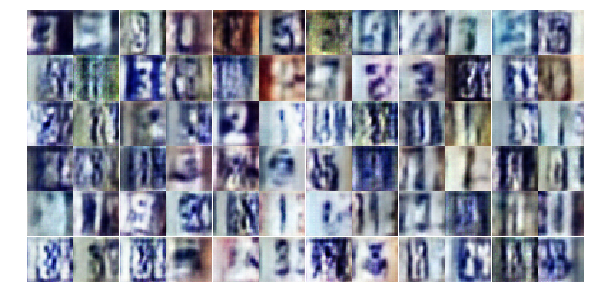

Epoch 5/25... Discriminator Loss: 0.8564... Generator Loss: 0.7640
Epoch 5/25... Discriminator Loss: 0.6298... Generator Loss: 1.1664
Epoch 5/25... Discriminator Loss: 0.6383... Generator Loss: 2.3156
Epoch 5/25... Discriminator Loss: 1.2139... Generator Loss: 0.5436
Epoch 5/25... Discriminator Loss: 0.6438... Generator Loss: 1.6137
Epoch 5/25... Discriminator Loss: 0.7246... Generator Loss: 0.9691
Epoch 5/25... Discriminator Loss: 0.6125... Generator Loss: 1.9594
Epoch 5/25... Discriminator Loss: 0.4104... Generator Loss: 1.8780
Epoch 5/25... Discriminator Loss: 0.4650... Generator Loss: 1.5941
Epoch 5/25... Discriminator Loss: 0.5509... Generator Loss: 1.2956


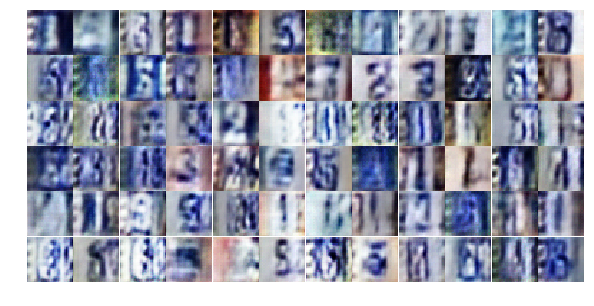

Epoch 5/25... Discriminator Loss: 0.4646... Generator Loss: 1.5097
Epoch 5/25... Discriminator Loss: 0.7331... Generator Loss: 1.2075
Epoch 5/25... Discriminator Loss: 0.7170... Generator Loss: 1.0296
Epoch 5/25... Discriminator Loss: 0.7269... Generator Loss: 0.8990
Epoch 5/25... Discriminator Loss: 0.6905... Generator Loss: 0.9531
Epoch 5/25... Discriminator Loss: 0.3939... Generator Loss: 1.8023
Epoch 5/25... Discriminator Loss: 0.8796... Generator Loss: 0.8027
Epoch 5/25... Discriminator Loss: 0.5926... Generator Loss: 1.2870
Epoch 5/25... Discriminator Loss: 1.0778... Generator Loss: 0.6590
Epoch 5/25... Discriminator Loss: 0.4748... Generator Loss: 1.3764


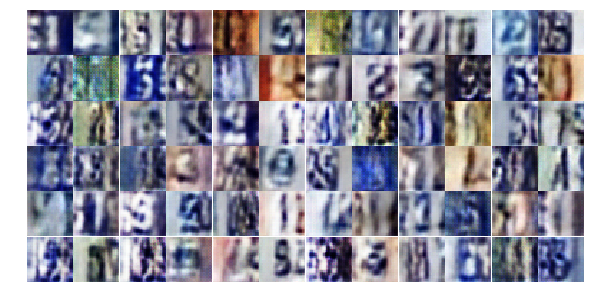

Epoch 5/25... Discriminator Loss: 0.5088... Generator Loss: 1.6045
Epoch 5/25... Discriminator Loss: 0.4489... Generator Loss: 2.3783
Epoch 5/25... Discriminator Loss: 0.5367... Generator Loss: 1.7122
Epoch 5/25... Discriminator Loss: 0.3626... Generator Loss: 1.7966
Epoch 5/25... Discriminator Loss: 0.8631... Generator Loss: 0.8754
Epoch 5/25... Discriminator Loss: 0.3820... Generator Loss: 2.4319
Epoch 5/25... Discriminator Loss: 0.9805... Generator Loss: 0.6339
Epoch 5/25... Discriminator Loss: 0.5940... Generator Loss: 1.1885
Epoch 5/25... Discriminator Loss: 1.1748... Generator Loss: 0.4742
Epoch 5/25... Discriminator Loss: 0.7040... Generator Loss: 0.9750


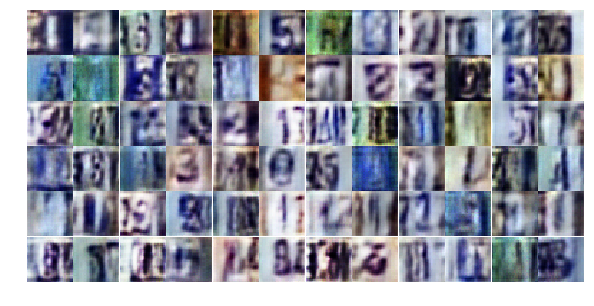

Epoch 5/25... Discriminator Loss: 0.4114... Generator Loss: 1.5710
Epoch 5/25... Discriminator Loss: 0.5301... Generator Loss: 1.2241
Epoch 5/25... Discriminator Loss: 1.3780... Generator Loss: 0.5291
Epoch 5/25... Discriminator Loss: 0.8847... Generator Loss: 2.1548
Epoch 5/25... Discriminator Loss: 0.9478... Generator Loss: 0.7868
Epoch 5/25... Discriminator Loss: 0.8468... Generator Loss: 0.8645
Epoch 5/25... Discriminator Loss: 0.5458... Generator Loss: 1.4265
Epoch 5/25... Discriminator Loss: 0.5004... Generator Loss: 1.4552
Epoch 5/25... Discriminator Loss: 0.4092... Generator Loss: 1.4411
Epoch 5/25... Discriminator Loss: 0.4594... Generator Loss: 1.5145


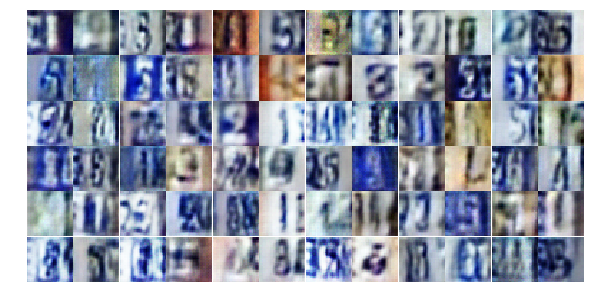

Epoch 5/25... Discriminator Loss: 0.7965... Generator Loss: 0.8395
Epoch 5/25... Discriminator Loss: 0.6085... Generator Loss: 1.0570
Epoch 5/25... Discriminator Loss: 0.8215... Generator Loss: 2.1800
Epoch 5/25... Discriminator Loss: 0.6627... Generator Loss: 0.9905
Epoch 5/25... Discriminator Loss: 0.4584... Generator Loss: 1.4923
Epoch 5/25... Discriminator Loss: 0.6170... Generator Loss: 1.5017
Epoch 6/25... Discriminator Loss: 0.5960... Generator Loss: 1.9116
Epoch 6/25... Discriminator Loss: 0.4734... Generator Loss: 1.8761
Epoch 6/25... Discriminator Loss: 0.6641... Generator Loss: 1.5320
Epoch 6/25... Discriminator Loss: 0.6953... Generator Loss: 1.1229


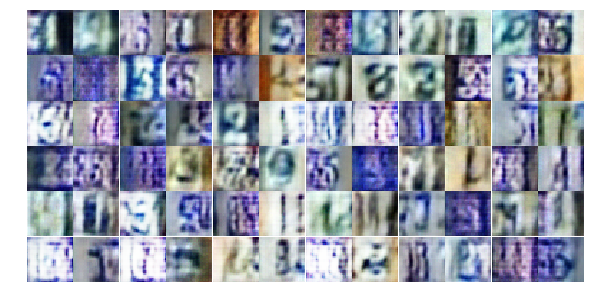

Epoch 6/25... Discriminator Loss: 0.6243... Generator Loss: 1.1113
Epoch 6/25... Discriminator Loss: 0.8000... Generator Loss: 0.9938
Epoch 6/25... Discriminator Loss: 0.6350... Generator Loss: 1.2553
Epoch 6/25... Discriminator Loss: 0.6174... Generator Loss: 1.2167
Epoch 6/25... Discriminator Loss: 1.2528... Generator Loss: 0.4436
Epoch 6/25... Discriminator Loss: 0.9948... Generator Loss: 0.6746
Epoch 6/25... Discriminator Loss: 0.5615... Generator Loss: 2.0966
Epoch 6/25... Discriminator Loss: 1.0554... Generator Loss: 0.6748
Epoch 6/25... Discriminator Loss: 0.6081... Generator Loss: 1.0963
Epoch 6/25... Discriminator Loss: 0.6346... Generator Loss: 1.2271


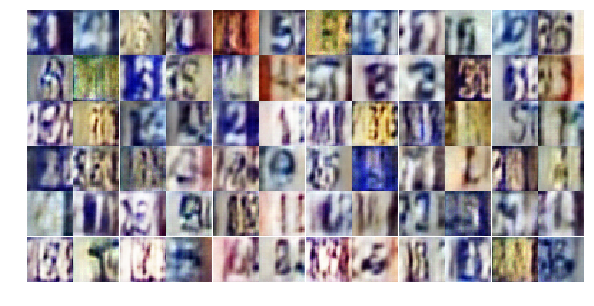

Epoch 6/25... Discriminator Loss: 0.5116... Generator Loss: 1.8051
Epoch 6/25... Discriminator Loss: 0.5703... Generator Loss: 1.8544
Epoch 6/25... Discriminator Loss: 1.0657... Generator Loss: 0.6780
Epoch 6/25... Discriminator Loss: 1.2033... Generator Loss: 0.5003
Epoch 6/25... Discriminator Loss: 0.4178... Generator Loss: 2.2308
Epoch 6/25... Discriminator Loss: 0.4030... Generator Loss: 1.7926
Epoch 6/25... Discriminator Loss: 0.5573... Generator Loss: 1.2177
Epoch 6/25... Discriminator Loss: 0.7958... Generator Loss: 0.8622
Epoch 6/25... Discriminator Loss: 1.0724... Generator Loss: 3.4024
Epoch 6/25... Discriminator Loss: 0.9106... Generator Loss: 0.7017


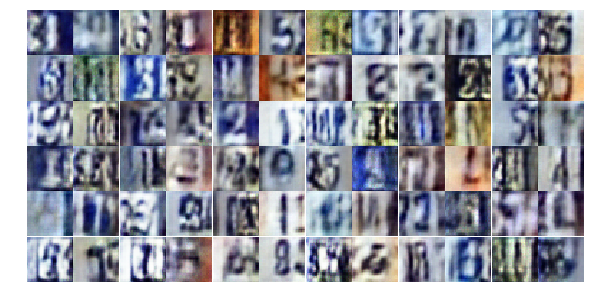

Epoch 6/25... Discriminator Loss: 0.8150... Generator Loss: 0.8518
Epoch 6/25... Discriminator Loss: 0.6949... Generator Loss: 1.3086
Epoch 6/25... Discriminator Loss: 0.7968... Generator Loss: 0.9524
Epoch 6/25... Discriminator Loss: 0.8712... Generator Loss: 0.7446
Epoch 6/25... Discriminator Loss: 0.5464... Generator Loss: 1.1570
Epoch 6/25... Discriminator Loss: 1.0967... Generator Loss: 0.6096
Epoch 6/25... Discriminator Loss: 0.3962... Generator Loss: 1.8751
Epoch 6/25... Discriminator Loss: 0.3176... Generator Loss: 1.8226
Epoch 6/25... Discriminator Loss: 0.6000... Generator Loss: 1.9984
Epoch 6/25... Discriminator Loss: 0.5503... Generator Loss: 1.3473


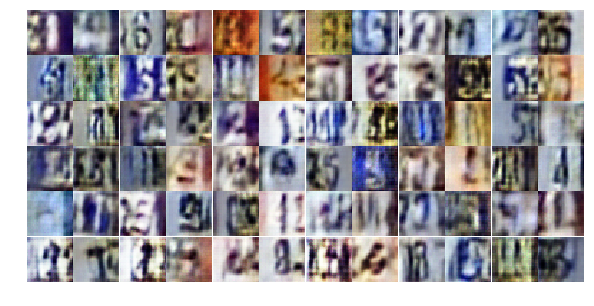

Epoch 6/25... Discriminator Loss: 0.9714... Generator Loss: 0.6941
Epoch 6/25... Discriminator Loss: 0.5408... Generator Loss: 1.4760
Epoch 6/25... Discriminator Loss: 1.4238... Generator Loss: 0.4018
Epoch 6/25... Discriminator Loss: 0.6497... Generator Loss: 1.2818
Epoch 6/25... Discriminator Loss: 0.6019... Generator Loss: 1.1867
Epoch 6/25... Discriminator Loss: 0.4527... Generator Loss: 1.6341
Epoch 6/25... Discriminator Loss: 0.3924... Generator Loss: 1.7716
Epoch 6/25... Discriminator Loss: 0.4507... Generator Loss: 1.5136
Epoch 6/25... Discriminator Loss: 0.8364... Generator Loss: 0.7991
Epoch 6/25... Discriminator Loss: 1.0953... Generator Loss: 0.7694


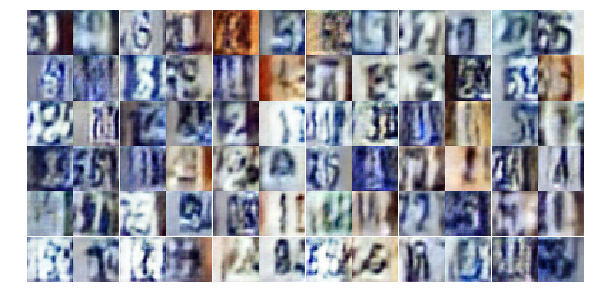

Epoch 6/25... Discriminator Loss: 0.8320... Generator Loss: 0.9199
Epoch 6/25... Discriminator Loss: 0.6180... Generator Loss: 1.3821
Epoch 6/25... Discriminator Loss: 0.8052... Generator Loss: 0.9959
Epoch 6/25... Discriminator Loss: 0.5330... Generator Loss: 1.2822
Epoch 6/25... Discriminator Loss: 0.5236... Generator Loss: 1.1617
Epoch 6/25... Discriminator Loss: 0.3836... Generator Loss: 1.7579
Epoch 6/25... Discriminator Loss: 0.8866... Generator Loss: 0.6771
Epoch 6/25... Discriminator Loss: 0.8854... Generator Loss: 0.6850
Epoch 6/25... Discriminator Loss: 0.8317... Generator Loss: 0.7876
Epoch 6/25... Discriminator Loss: 1.2139... Generator Loss: 0.4573


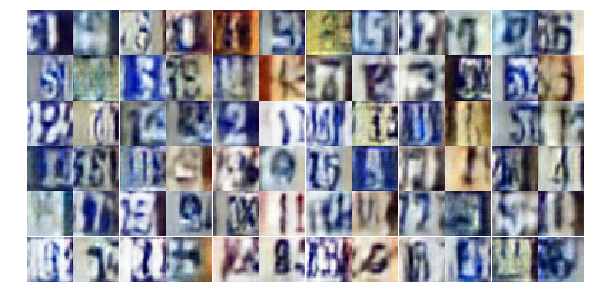

Epoch 6/25... Discriminator Loss: 0.5522... Generator Loss: 1.7875
Epoch 6/25... Discriminator Loss: 0.5227... Generator Loss: 1.9289
Epoch 6/25... Discriminator Loss: 0.9359... Generator Loss: 0.8018
Epoch 7/25... Discriminator Loss: 0.9443... Generator Loss: 0.7360
Epoch 7/25... Discriminator Loss: 0.6889... Generator Loss: 1.3809
Epoch 7/25... Discriminator Loss: 0.6342... Generator Loss: 1.4676
Epoch 7/25... Discriminator Loss: 0.4194... Generator Loss: 1.7746
Epoch 7/25... Discriminator Loss: 0.5130... Generator Loss: 1.5295
Epoch 7/25... Discriminator Loss: 0.5494... Generator Loss: 1.3030
Epoch 7/25... Discriminator Loss: 0.4596... Generator Loss: 1.4739


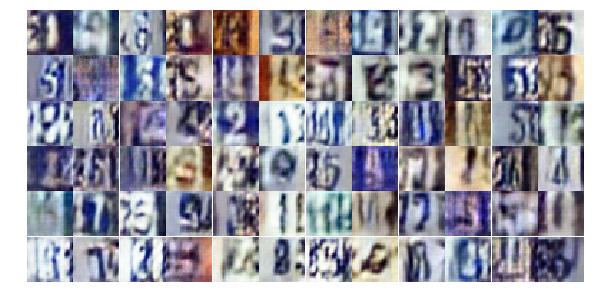

Epoch 7/25... Discriminator Loss: 0.4115... Generator Loss: 1.8002
Epoch 7/25... Discriminator Loss: 0.4822... Generator Loss: 1.3104
Epoch 7/25... Discriminator Loss: 0.8596... Generator Loss: 0.7612
Epoch 7/25... Discriminator Loss: 0.4844... Generator Loss: 2.3542
Epoch 7/25... Discriminator Loss: 0.5910... Generator Loss: 1.3405
Epoch 7/25... Discriminator Loss: 0.5695... Generator Loss: 1.2592
Epoch 7/25... Discriminator Loss: 0.7230... Generator Loss: 2.2321
Epoch 7/25... Discriminator Loss: 0.8486... Generator Loss: 1.8456
Epoch 7/25... Discriminator Loss: 0.7020... Generator Loss: 2.3036
Epoch 7/25... Discriminator Loss: 0.5289... Generator Loss: 1.6959


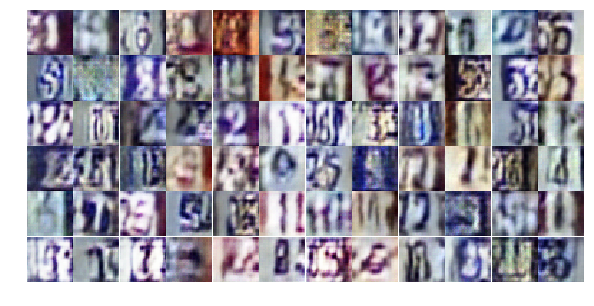

Epoch 7/25... Discriminator Loss: 0.5510... Generator Loss: 1.4485
Epoch 7/25... Discriminator Loss: 0.4058... Generator Loss: 1.8213
Epoch 7/25... Discriminator Loss: 1.3099... Generator Loss: 0.4117
Epoch 7/25... Discriminator Loss: 0.6254... Generator Loss: 1.2114
Epoch 7/25... Discriminator Loss: 0.5231... Generator Loss: 1.2420
Epoch 7/25... Discriminator Loss: 0.5199... Generator Loss: 1.2864
Epoch 7/25... Discriminator Loss: 0.3904... Generator Loss: 1.5327
Epoch 7/25... Discriminator Loss: 1.0679... Generator Loss: 0.5841
Epoch 7/25... Discriminator Loss: 0.4548... Generator Loss: 1.5587
Epoch 7/25... Discriminator Loss: 0.4410... Generator Loss: 2.0792


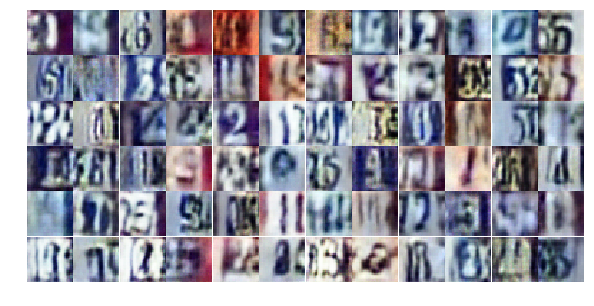

Epoch 7/25... Discriminator Loss: 1.2697... Generator Loss: 0.4652
Epoch 7/25... Discriminator Loss: 0.8623... Generator Loss: 0.9042
Epoch 7/25... Discriminator Loss: 0.4746... Generator Loss: 1.4810
Epoch 7/25... Discriminator Loss: 0.5027... Generator Loss: 1.7170
Epoch 7/25... Discriminator Loss: 0.5207... Generator Loss: 1.4486
Epoch 7/25... Discriminator Loss: 0.8604... Generator Loss: 0.7757
Epoch 7/25... Discriminator Loss: 0.3317... Generator Loss: 1.9134
Epoch 7/25... Discriminator Loss: 0.7820... Generator Loss: 0.9378
Epoch 7/25... Discriminator Loss: 1.0648... Generator Loss: 0.6121
Epoch 7/25... Discriminator Loss: 0.4547... Generator Loss: 2.1894


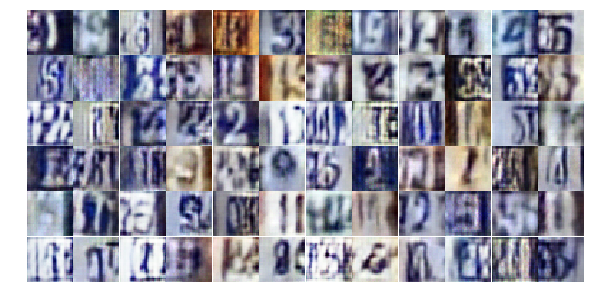

Epoch 7/25... Discriminator Loss: 0.6673... Generator Loss: 1.6149
Epoch 7/25... Discriminator Loss: 0.5130... Generator Loss: 1.5696
Epoch 7/25... Discriminator Loss: 0.3831... Generator Loss: 1.9932
Epoch 7/25... Discriminator Loss: 0.7105... Generator Loss: 2.5603
Epoch 7/25... Discriminator Loss: 0.6020... Generator Loss: 1.2328
Epoch 7/25... Discriminator Loss: 0.2643... Generator Loss: 2.0048
Epoch 7/25... Discriminator Loss: 0.4194... Generator Loss: 1.4418
Epoch 7/25... Discriminator Loss: 0.7772... Generator Loss: 1.0740
Epoch 7/25... Discriminator Loss: 0.5126... Generator Loss: 3.0378
Epoch 7/25... Discriminator Loss: 0.6052... Generator Loss: 1.1882


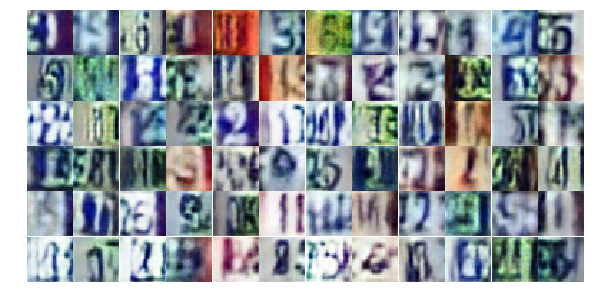

Epoch 7/25... Discriminator Loss: 0.2732... Generator Loss: 1.9241
Epoch 7/25... Discriminator Loss: 0.8156... Generator Loss: 0.7863
Epoch 7/25... Discriminator Loss: 0.5548... Generator Loss: 1.7062
Epoch 7/25... Discriminator Loss: 0.5871... Generator Loss: 1.1623
Epoch 7/25... Discriminator Loss: 0.5985... Generator Loss: 1.1156
Epoch 7/25... Discriminator Loss: 0.6623... Generator Loss: 1.0394
Epoch 7/25... Discriminator Loss: 1.1464... Generator Loss: 0.4839
Epoch 7/25... Discriminator Loss: 0.6938... Generator Loss: 1.1176
Epoch 7/25... Discriminator Loss: 0.8397... Generator Loss: 0.8337
Epoch 7/25... Discriminator Loss: 0.9863... Generator Loss: 0.6638


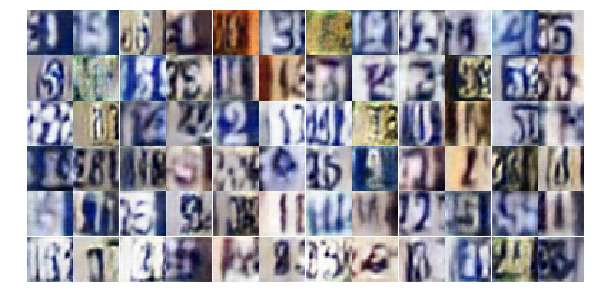

Epoch 7/25... Discriminator Loss: 0.8265... Generator Loss: 2.7784
Epoch 8/25... Discriminator Loss: 0.7362... Generator Loss: 0.9608
Epoch 8/25... Discriminator Loss: 0.5705... Generator Loss: 1.1571
Epoch 8/25... Discriminator Loss: 0.6697... Generator Loss: 0.9865
Epoch 8/25... Discriminator Loss: 0.4554... Generator Loss: 1.5475
Epoch 8/25... Discriminator Loss: 0.9609... Generator Loss: 0.8197
Epoch 8/25... Discriminator Loss: 1.2487... Generator Loss: 0.4724
Epoch 8/25... Discriminator Loss: 0.4335... Generator Loss: 2.4645
Epoch 8/25... Discriminator Loss: 0.7213... Generator Loss: 1.0766
Epoch 8/25... Discriminator Loss: 0.6930... Generator Loss: 0.9348


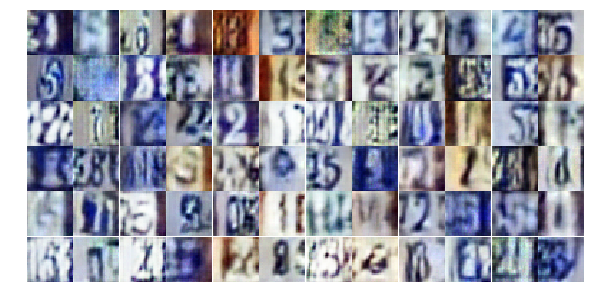

Epoch 8/25... Discriminator Loss: 0.4553... Generator Loss: 1.7396
Epoch 8/25... Discriminator Loss: 0.4415... Generator Loss: 1.4250
Epoch 8/25... Discriminator Loss: 0.5826... Generator Loss: 1.1920
Epoch 8/25... Discriminator Loss: 0.3139... Generator Loss: 1.8664
Epoch 8/25... Discriminator Loss: 0.7911... Generator Loss: 0.8133
Epoch 8/25... Discriminator Loss: 0.3786... Generator Loss: 2.0180
Epoch 8/25... Discriminator Loss: 0.3975... Generator Loss: 1.9061
Epoch 8/25... Discriminator Loss: 0.4590... Generator Loss: 1.5578
Epoch 8/25... Discriminator Loss: 0.6794... Generator Loss: 1.1393
Epoch 8/25... Discriminator Loss: 1.8717... Generator Loss: 0.2471


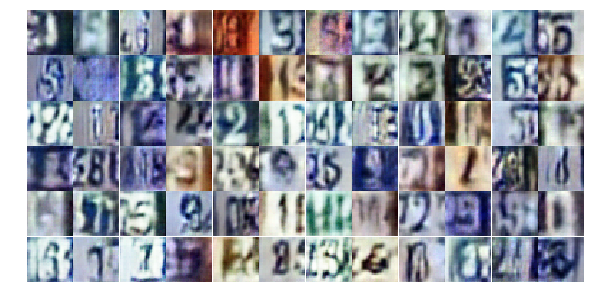

Epoch 8/25... Discriminator Loss: 0.4422... Generator Loss: 1.6240
Epoch 8/25... Discriminator Loss: 0.3787... Generator Loss: 2.3063
Epoch 8/25... Discriminator Loss: 0.6907... Generator Loss: 2.1478
Epoch 8/25... Discriminator Loss: 0.6183... Generator Loss: 1.5132
Epoch 8/25... Discriminator Loss: 0.4017... Generator Loss: 1.7079
Epoch 8/25... Discriminator Loss: 0.5914... Generator Loss: 1.1186
Epoch 8/25... Discriminator Loss: 0.5109... Generator Loss: 1.3892
Epoch 8/25... Discriminator Loss: 0.4237... Generator Loss: 1.3086
Epoch 8/25... Discriminator Loss: 0.8660... Generator Loss: 2.4148
Epoch 8/25... Discriminator Loss: 2.7264... Generator Loss: 5.6405


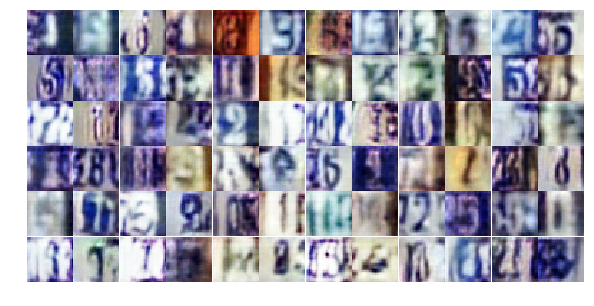

Epoch 8/25... Discriminator Loss: 0.8918... Generator Loss: 0.8908
Epoch 8/25... Discriminator Loss: 0.8774... Generator Loss: 0.7466
Epoch 8/25... Discriminator Loss: 0.5450... Generator Loss: 1.5318
Epoch 8/25... Discriminator Loss: 0.5469... Generator Loss: 1.3182
Epoch 8/25... Discriminator Loss: 0.7836... Generator Loss: 0.9017
Epoch 8/25... Discriminator Loss: 0.8970... Generator Loss: 0.8076
Epoch 8/25... Discriminator Loss: 0.5271... Generator Loss: 1.2900
Epoch 8/25... Discriminator Loss: 0.3251... Generator Loss: 2.0548
Epoch 8/25... Discriminator Loss: 0.6772... Generator Loss: 1.0482
Epoch 8/25... Discriminator Loss: 0.5224... Generator Loss: 1.2170


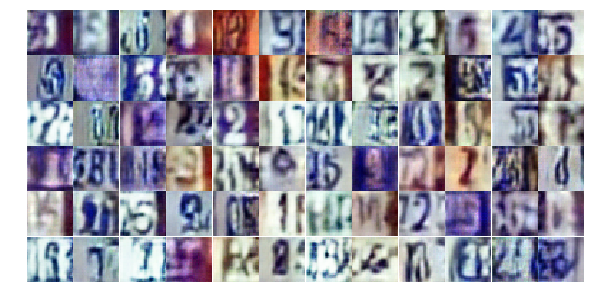

Epoch 8/25... Discriminator Loss: 0.4310... Generator Loss: 1.4424
Epoch 8/25... Discriminator Loss: 0.9522... Generator Loss: 0.8062
Epoch 8/25... Discriminator Loss: 0.4625... Generator Loss: 1.4140
Epoch 8/25... Discriminator Loss: 0.4452... Generator Loss: 1.6636
Epoch 8/25... Discriminator Loss: 3.5067... Generator Loss: 5.0276
Epoch 8/25... Discriminator Loss: 1.3652... Generator Loss: 0.4550
Epoch 8/25... Discriminator Loss: 0.9720... Generator Loss: 0.6784
Epoch 8/25... Discriminator Loss: 0.7695... Generator Loss: 0.9800
Epoch 8/25... Discriminator Loss: 0.6227... Generator Loss: 1.1228
Epoch 8/25... Discriminator Loss: 0.6167... Generator Loss: 1.1144


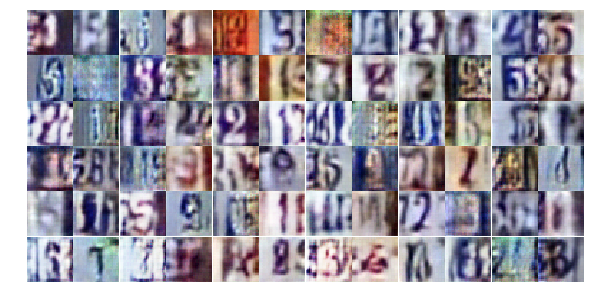

Epoch 8/25... Discriminator Loss: 0.5048... Generator Loss: 1.3393
Epoch 8/25... Discriminator Loss: 0.3491... Generator Loss: 1.8267
Epoch 8/25... Discriminator Loss: 0.8939... Generator Loss: 3.0537
Epoch 8/25... Discriminator Loss: 0.9727... Generator Loss: 2.8470
Epoch 8/25... Discriminator Loss: 0.3974... Generator Loss: 2.0122
Epoch 8/25... Discriminator Loss: 0.7435... Generator Loss: 1.1340
Epoch 8/25... Discriminator Loss: 0.6940... Generator Loss: 0.9053
Epoch 8/25... Discriminator Loss: 0.3657... Generator Loss: 2.3258
Epoch 9/25... Discriminator Loss: 0.8610... Generator Loss: 1.0059
Epoch 9/25... Discriminator Loss: 0.6104... Generator Loss: 1.0658


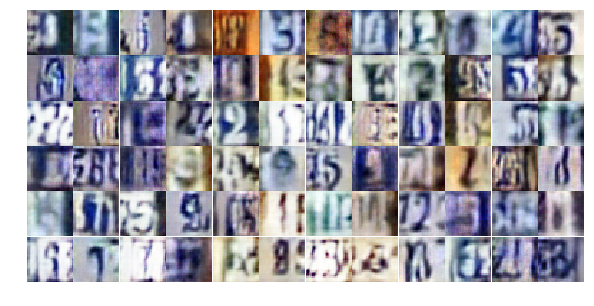

Epoch 9/25... Discriminator Loss: 0.5465... Generator Loss: 1.5007
Epoch 9/25... Discriminator Loss: 0.4595... Generator Loss: 1.4668
Epoch 9/25... Discriminator Loss: 0.7875... Generator Loss: 0.8881
Epoch 9/25... Discriminator Loss: 0.3979... Generator Loss: 2.1613
Epoch 9/25... Discriminator Loss: 1.1040... Generator Loss: 0.5716
Epoch 9/25... Discriminator Loss: 0.5193... Generator Loss: 2.1453
Epoch 9/25... Discriminator Loss: 0.7331... Generator Loss: 1.4335
Epoch 9/25... Discriminator Loss: 0.3982... Generator Loss: 1.6381
Epoch 9/25... Discriminator Loss: 0.8964... Generator Loss: 0.7954
Epoch 9/25... Discriminator Loss: 0.7395... Generator Loss: 1.5020


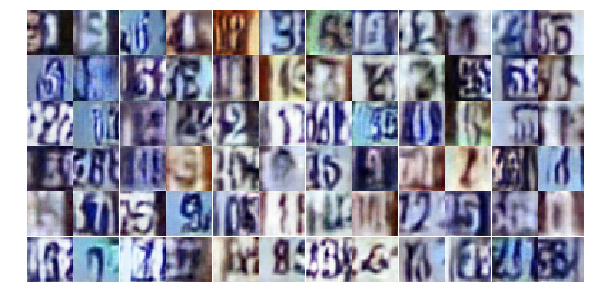

Epoch 9/25... Discriminator Loss: 0.5539... Generator Loss: 1.5811
Epoch 9/25... Discriminator Loss: 0.8563... Generator Loss: 2.4900
Epoch 9/25... Discriminator Loss: 0.8647... Generator Loss: 0.7577
Epoch 9/25... Discriminator Loss: 1.5047... Generator Loss: 0.3413
Epoch 9/25... Discriminator Loss: 0.5192... Generator Loss: 1.3975
Epoch 9/25... Discriminator Loss: 0.7246... Generator Loss: 1.0062
Epoch 9/25... Discriminator Loss: 0.8375... Generator Loss: 0.8223
Epoch 9/25... Discriminator Loss: 0.7850... Generator Loss: 0.8774
Epoch 9/25... Discriminator Loss: 1.3191... Generator Loss: 0.4359
Epoch 9/25... Discriminator Loss: 1.1261... Generator Loss: 0.5141


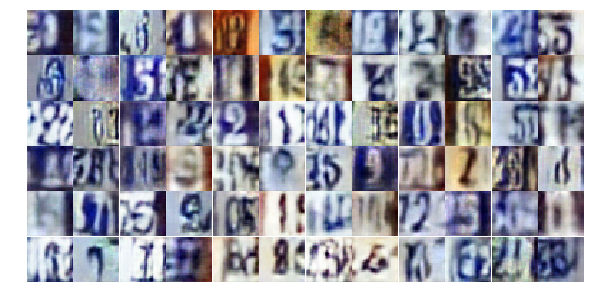

Epoch 9/25... Discriminator Loss: 0.7783... Generator Loss: 0.9390
Epoch 9/25... Discriminator Loss: 0.7172... Generator Loss: 0.8947
Epoch 9/25... Discriminator Loss: 0.5758... Generator Loss: 1.3077
Epoch 9/25... Discriminator Loss: 0.4403... Generator Loss: 1.7640
Epoch 9/25... Discriminator Loss: 0.5134... Generator Loss: 1.3252
Epoch 9/25... Discriminator Loss: 0.4261... Generator Loss: 1.4463
Epoch 9/25... Discriminator Loss: 0.5879... Generator Loss: 1.2328
Epoch 9/25... Discriminator Loss: 0.6442... Generator Loss: 1.0860
Epoch 9/25... Discriminator Loss: 0.5598... Generator Loss: 1.2323
Epoch 9/25... Discriminator Loss: 0.4188... Generator Loss: 1.3516


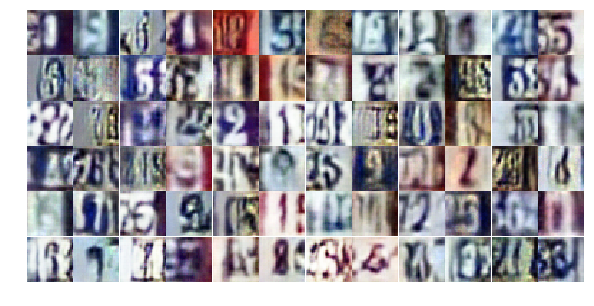

Epoch 9/25... Discriminator Loss: 0.5566... Generator Loss: 1.1853
Epoch 9/25... Discriminator Loss: 0.7496... Generator Loss: 0.8685
Epoch 9/25... Discriminator Loss: 0.7384... Generator Loss: 1.0202
Epoch 9/25... Discriminator Loss: 0.4996... Generator Loss: 2.4152
Epoch 9/25... Discriminator Loss: 0.8743... Generator Loss: 2.3276
Epoch 9/25... Discriminator Loss: 0.6040... Generator Loss: 1.2967
Epoch 9/25... Discriminator Loss: 0.6446... Generator Loss: 1.3663
Epoch 9/25... Discriminator Loss: 0.3379... Generator Loss: 1.7282
Epoch 9/25... Discriminator Loss: 0.7108... Generator Loss: 0.9348
Epoch 9/25... Discriminator Loss: 0.6543... Generator Loss: 1.0273


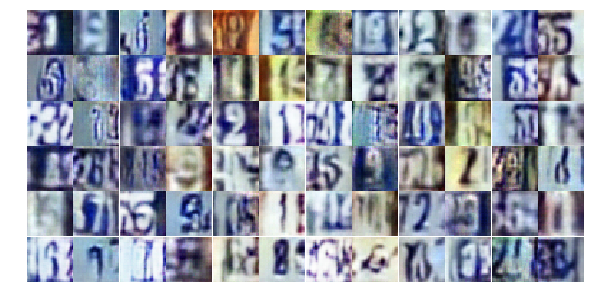

Epoch 9/25... Discriminator Loss: 0.4520... Generator Loss: 1.5414
Epoch 9/25... Discriminator Loss: 0.5623... Generator Loss: 1.3255
Epoch 9/25... Discriminator Loss: 0.5035... Generator Loss: 2.4109
Epoch 9/25... Discriminator Loss: 0.6553... Generator Loss: 1.1001
Epoch 9/25... Discriminator Loss: 0.4136... Generator Loss: 2.1684
Epoch 9/25... Discriminator Loss: 0.8626... Generator Loss: 0.7257
Epoch 9/25... Discriminator Loss: 1.0717... Generator Loss: 3.0917
Epoch 9/25... Discriminator Loss: 0.6725... Generator Loss: 1.0279
Epoch 9/25... Discriminator Loss: 0.5856... Generator Loss: 1.5300
Epoch 9/25... Discriminator Loss: 0.5142... Generator Loss: 1.6880


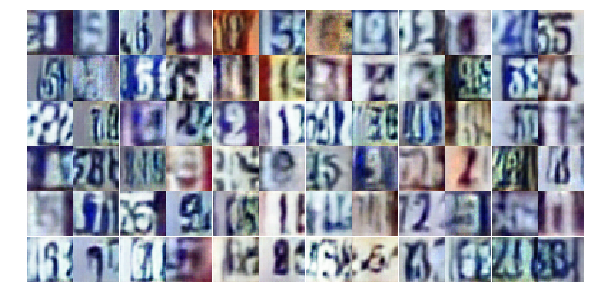

Epoch 9/25... Discriminator Loss: 0.5847... Generator Loss: 1.2227
Epoch 9/25... Discriminator Loss: 0.7368... Generator Loss: 2.1035
Epoch 9/25... Discriminator Loss: 0.7189... Generator Loss: 0.9760
Epoch 9/25... Discriminator Loss: 1.1567... Generator Loss: 0.5144
Epoch 9/25... Discriminator Loss: 0.5208... Generator Loss: 1.4016
Epoch 10/25... Discriminator Loss: 1.0233... Generator Loss: 0.5589
Epoch 10/25... Discriminator Loss: 0.7805... Generator Loss: 0.9116
Epoch 10/25... Discriminator Loss: 0.6249... Generator Loss: 1.1594
Epoch 10/25... Discriminator Loss: 0.7217... Generator Loss: 0.9458
Epoch 10/25... Discriminator Loss: 1.1389... Generator Loss: 0.5056


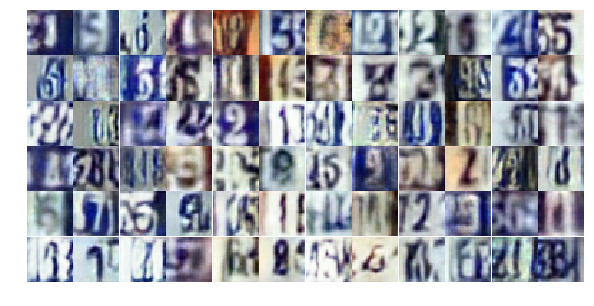

Epoch 10/25... Discriminator Loss: 1.1864... Generator Loss: 0.4600
Epoch 10/25... Discriminator Loss: 0.7928... Generator Loss: 0.8346
Epoch 10/25... Discriminator Loss: 0.5206... Generator Loss: 1.2508
Epoch 10/25... Discriminator Loss: 0.5467... Generator Loss: 1.2723
Epoch 10/25... Discriminator Loss: 0.8045... Generator Loss: 3.1794
Epoch 10/25... Discriminator Loss: 0.6624... Generator Loss: 1.7050
Epoch 10/25... Discriminator Loss: 0.4647... Generator Loss: 1.4845
Epoch 10/25... Discriminator Loss: 1.2160... Generator Loss: 0.5278
Epoch 10/25... Discriminator Loss: 2.6039... Generator Loss: 2.0561
Epoch 10/25... Discriminator Loss: 0.7412... Generator Loss: 1.1180


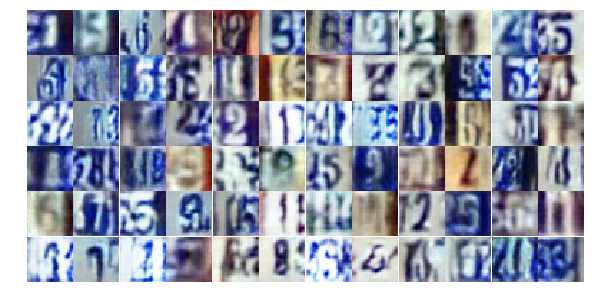

Epoch 10/25... Discriminator Loss: 0.4887... Generator Loss: 1.4550
Epoch 10/25... Discriminator Loss: 1.0035... Generator Loss: 0.6639
Epoch 10/25... Discriminator Loss: 0.6798... Generator Loss: 0.9978
Epoch 10/25... Discriminator Loss: 1.0488... Generator Loss: 0.6602
Epoch 10/25... Discriminator Loss: 0.9574... Generator Loss: 1.6091
Epoch 10/25... Discriminator Loss: 0.7247... Generator Loss: 0.9066
Epoch 10/25... Discriminator Loss: 0.6803... Generator Loss: 1.0557
Epoch 10/25... Discriminator Loss: 0.4783... Generator Loss: 1.2990
Epoch 10/25... Discriminator Loss: 0.6389... Generator Loss: 1.0465
Epoch 10/25... Discriminator Loss: 0.3970... Generator Loss: 2.3697


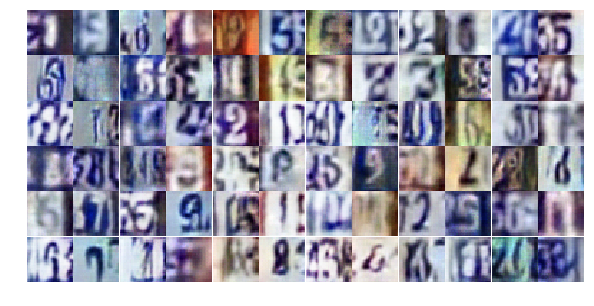

Epoch 10/25... Discriminator Loss: 1.0502... Generator Loss: 0.5992
Epoch 10/25... Discriminator Loss: 0.7214... Generator Loss: 1.0064
Epoch 10/25... Discriminator Loss: 0.3794... Generator Loss: 1.9213
Epoch 10/25... Discriminator Loss: 1.1241... Generator Loss: 2.9659
Epoch 10/25... Discriminator Loss: 1.1612... Generator Loss: 0.6005
Epoch 10/25... Discriminator Loss: 0.7339... Generator Loss: 0.9121
Epoch 10/25... Discriminator Loss: 0.3596... Generator Loss: 1.7030
Epoch 10/25... Discriminator Loss: 0.6586... Generator Loss: 1.1047
Epoch 10/25... Discriminator Loss: 0.6465... Generator Loss: 1.0552
Epoch 10/25... Discriminator Loss: 1.0617... Generator Loss: 0.6343


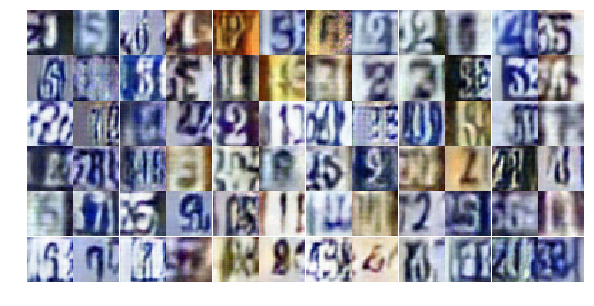

Epoch 10/25... Discriminator Loss: 0.5378... Generator Loss: 1.5157
Epoch 10/25... Discriminator Loss: 1.3146... Generator Loss: 0.4773
Epoch 10/25... Discriminator Loss: 0.7137... Generator Loss: 1.6447
Epoch 10/25... Discriminator Loss: 0.6811... Generator Loss: 1.9968
Epoch 10/25... Discriminator Loss: 0.7343... Generator Loss: 0.9832
Epoch 10/25... Discriminator Loss: 1.1116... Generator Loss: 0.6481
Epoch 10/25... Discriminator Loss: 0.6888... Generator Loss: 1.0365
Epoch 10/25... Discriminator Loss: 1.2271... Generator Loss: 0.5197
Epoch 10/25... Discriminator Loss: 0.8665... Generator Loss: 0.7171
Epoch 10/25... Discriminator Loss: 0.4828... Generator Loss: 1.7962


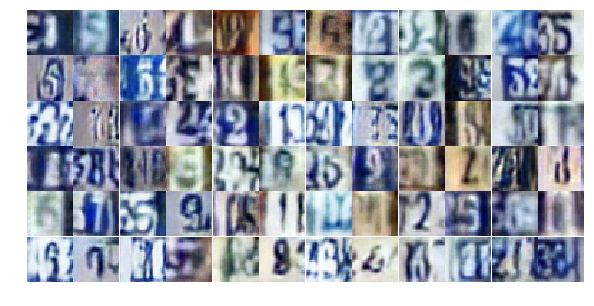

Epoch 10/25... Discriminator Loss: 0.9231... Generator Loss: 0.7530
Epoch 10/25... Discriminator Loss: 0.7175... Generator Loss: 1.3707
Epoch 10/25... Discriminator Loss: 0.5929... Generator Loss: 1.1751
Epoch 10/25... Discriminator Loss: 0.7483... Generator Loss: 0.8903
Epoch 10/25... Discriminator Loss: 0.4762... Generator Loss: 1.6982
Epoch 10/25... Discriminator Loss: 0.4731... Generator Loss: 1.3945
Epoch 10/25... Discriminator Loss: 0.6905... Generator Loss: 0.9769
Epoch 10/25... Discriminator Loss: 0.3887... Generator Loss: 1.8214
Epoch 10/25... Discriminator Loss: 0.7381... Generator Loss: 2.3402
Epoch 10/25... Discriminator Loss: 0.5503... Generator Loss: 1.2819


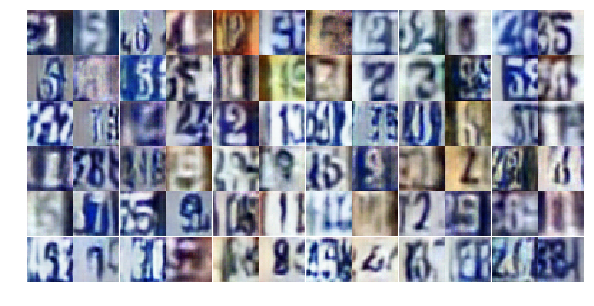

Epoch 10/25... Discriminator Loss: 0.5702... Generator Loss: 1.4320
Epoch 10/25... Discriminator Loss: 0.5086... Generator Loss: 1.4395
Epoch 10/25... Discriminator Loss: 0.3192... Generator Loss: 1.8264
Epoch 11/25... Discriminator Loss: 1.1598... Generator Loss: 0.5332
Epoch 11/25... Discriminator Loss: 0.7042... Generator Loss: 0.9287
Epoch 11/25... Discriminator Loss: 1.5674... Generator Loss: 0.3126
Epoch 11/25... Discriminator Loss: 1.0614... Generator Loss: 0.6046
Epoch 11/25... Discriminator Loss: 0.8786... Generator Loss: 0.9447
Epoch 11/25... Discriminator Loss: 1.6222... Generator Loss: 0.3511
Epoch 11/25... Discriminator Loss: 0.4169... Generator Loss: 1.8518


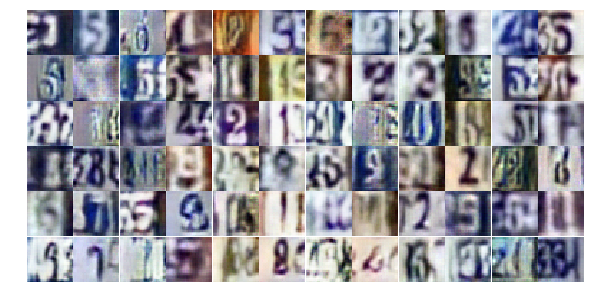

Epoch 11/25... Discriminator Loss: 0.3667... Generator Loss: 1.8769
Epoch 11/25... Discriminator Loss: 0.7828... Generator Loss: 0.8980
Epoch 11/25... Discriminator Loss: 0.4365... Generator Loss: 1.6979
Epoch 11/25... Discriminator Loss: 0.8932... Generator Loss: 0.7195
Epoch 11/25... Discriminator Loss: 0.7149... Generator Loss: 1.4052
Epoch 11/25... Discriminator Loss: 0.4406... Generator Loss: 1.6860
Epoch 11/25... Discriminator Loss: 0.6871... Generator Loss: 2.1912
Epoch 11/25... Discriminator Loss: 0.4202... Generator Loss: 1.7717
Epoch 11/25... Discriminator Loss: 1.2645... Generator Loss: 0.4942
Epoch 11/25... Discriminator Loss: 1.2738... Generator Loss: 0.4487


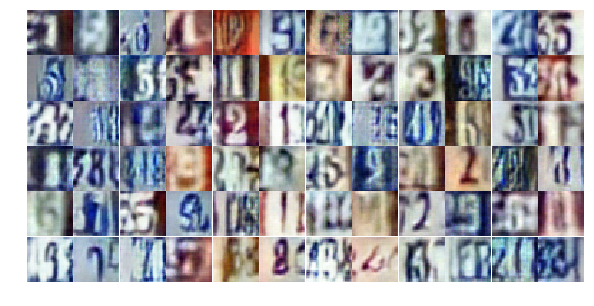

Epoch 11/25... Discriminator Loss: 0.9193... Generator Loss: 0.7438
Epoch 11/25... Discriminator Loss: 0.3596... Generator Loss: 1.9547
Epoch 11/25... Discriminator Loss: 0.7899... Generator Loss: 0.8986
Epoch 11/25... Discriminator Loss: 0.5508... Generator Loss: 1.2214
Epoch 11/25... Discriminator Loss: 0.3671... Generator Loss: 2.0818
Epoch 11/25... Discriminator Loss: 0.5213... Generator Loss: 1.6605
Epoch 11/25... Discriminator Loss: 0.3791... Generator Loss: 1.6652
Epoch 11/25... Discriminator Loss: 0.8476... Generator Loss: 1.2246
Epoch 11/25... Discriminator Loss: 0.5170... Generator Loss: 1.7332
Epoch 11/25... Discriminator Loss: 0.9512... Generator Loss: 0.6581


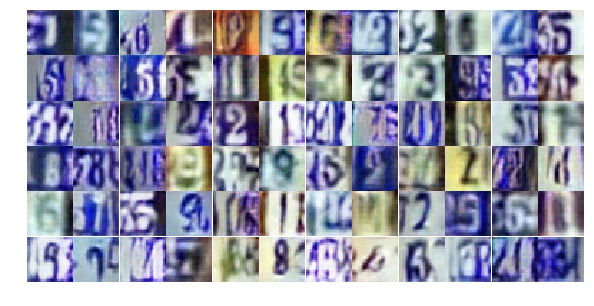

Epoch 11/25... Discriminator Loss: 1.8609... Generator Loss: 0.2763
Epoch 11/25... Discriminator Loss: 0.6707... Generator Loss: 1.3705
Epoch 11/25... Discriminator Loss: 0.7184... Generator Loss: 1.3451
Epoch 11/25... Discriminator Loss: 0.5361... Generator Loss: 1.5652
Epoch 11/25... Discriminator Loss: 0.6046... Generator Loss: 1.0934
Epoch 11/25... Discriminator Loss: 1.2130... Generator Loss: 0.4847
Epoch 11/25... Discriminator Loss: 1.4903... Generator Loss: 0.4147
Epoch 11/25... Discriminator Loss: 1.1018... Generator Loss: 0.5669
Epoch 11/25... Discriminator Loss: 0.5471... Generator Loss: 1.3321
Epoch 11/25... Discriminator Loss: 0.9878... Generator Loss: 0.6389


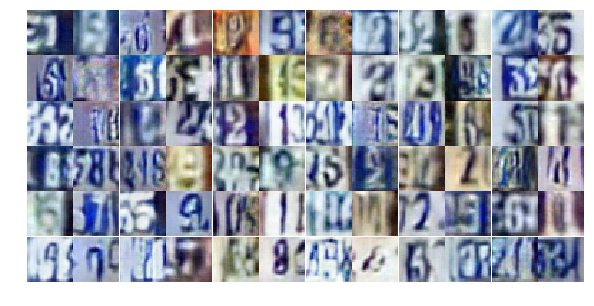

Epoch 11/25... Discriminator Loss: 0.5134... Generator Loss: 1.5288
Epoch 11/25... Discriminator Loss: 0.7498... Generator Loss: 0.8876
Epoch 11/25... Discriminator Loss: 0.6021... Generator Loss: 1.1940
Epoch 11/25... Discriminator Loss: 0.8094... Generator Loss: 1.0984
Epoch 11/25... Discriminator Loss: 0.8500... Generator Loss: 0.7522
Epoch 11/25... Discriminator Loss: 0.7782... Generator Loss: 0.8893
Epoch 11/25... Discriminator Loss: 0.3427... Generator Loss: 2.7624
Epoch 11/25... Discriminator Loss: 0.9732... Generator Loss: 0.6495
Epoch 11/25... Discriminator Loss: 1.2629... Generator Loss: 0.4632
Epoch 11/25... Discriminator Loss: 0.5365... Generator Loss: 1.3515


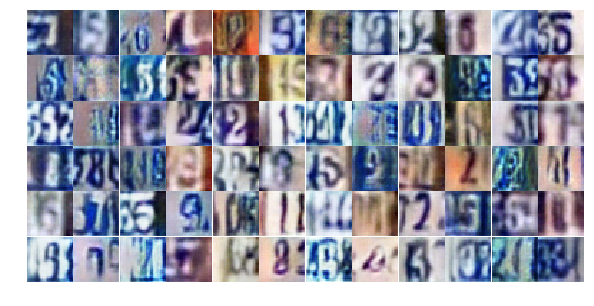

Epoch 11/25... Discriminator Loss: 0.6648... Generator Loss: 1.1707
Epoch 11/25... Discriminator Loss: 0.3541... Generator Loss: 2.1209
Epoch 11/25... Discriminator Loss: 0.8099... Generator Loss: 0.8559
Epoch 11/25... Discriminator Loss: 0.9138... Generator Loss: 0.6816
Epoch 11/25... Discriminator Loss: 1.3840... Generator Loss: 0.4237
Epoch 11/25... Discriminator Loss: 0.6451... Generator Loss: 1.2143
Epoch 11/25... Discriminator Loss: 0.5372... Generator Loss: 1.6851
Epoch 11/25... Discriminator Loss: 0.5632... Generator Loss: 1.7071
Epoch 11/25... Discriminator Loss: 1.1232... Generator Loss: 0.5420
Epoch 11/25... Discriminator Loss: 0.6183... Generator Loss: 1.2558


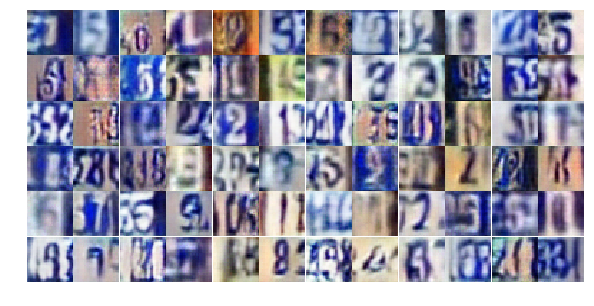

Epoch 12/25... Discriminator Loss: 0.6509... Generator Loss: 1.1719
Epoch 12/25... Discriminator Loss: 0.6675... Generator Loss: 1.3186
Epoch 12/25... Discriminator Loss: 0.9774... Generator Loss: 0.7037
Epoch 12/25... Discriminator Loss: 0.4899... Generator Loss: 1.5287
Epoch 12/25... Discriminator Loss: 0.7277... Generator Loss: 0.8502
Epoch 12/25... Discriminator Loss: 1.5513... Generator Loss: 0.3559
Epoch 12/25... Discriminator Loss: 0.6146... Generator Loss: 1.5412
Epoch 12/25... Discriminator Loss: 0.6010... Generator Loss: 1.3652
Epoch 12/25... Discriminator Loss: 0.6800... Generator Loss: 1.1469
Epoch 12/25... Discriminator Loss: 1.1208... Generator Loss: 0.5864


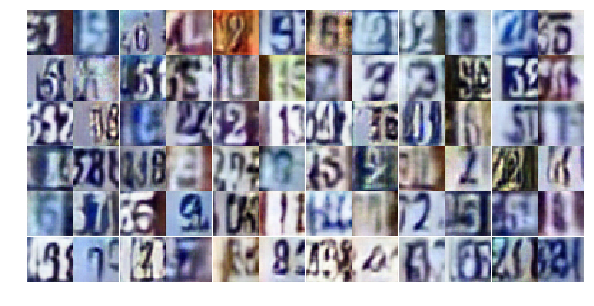

Epoch 12/25... Discriminator Loss: 0.5099... Generator Loss: 1.3117
Epoch 12/25... Discriminator Loss: 0.7976... Generator Loss: 0.8202
Epoch 12/25... Discriminator Loss: 0.5777... Generator Loss: 2.1312
Epoch 12/25... Discriminator Loss: 0.9686... Generator Loss: 0.6881
Epoch 12/25... Discriminator Loss: 0.5116... Generator Loss: 2.0025
Epoch 12/25... Discriminator Loss: 1.0006... Generator Loss: 0.7225
Epoch 12/25... Discriminator Loss: 2.0043... Generator Loss: 0.2054
Epoch 12/25... Discriminator Loss: 0.5940... Generator Loss: 1.5648
Epoch 12/25... Discriminator Loss: 0.5237... Generator Loss: 1.4781
Epoch 12/25... Discriminator Loss: 0.8462... Generator Loss: 0.8163


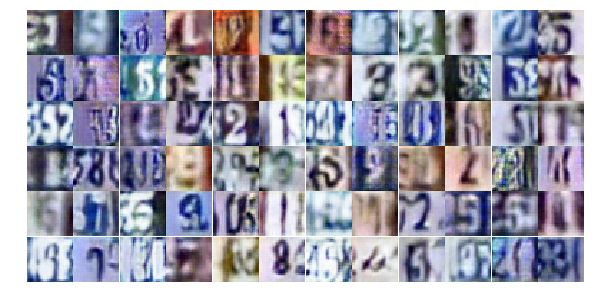

Epoch 12/25... Discriminator Loss: 0.4141... Generator Loss: 1.4663
Epoch 12/25... Discriminator Loss: 0.5056... Generator Loss: 1.4277
Epoch 12/25... Discriminator Loss: 0.7008... Generator Loss: 1.0200
Epoch 12/25... Discriminator Loss: 0.4531... Generator Loss: 1.4679
Epoch 12/25... Discriminator Loss: 0.5543... Generator Loss: 1.9980
Epoch 12/25... Discriminator Loss: 0.5288... Generator Loss: 1.2824
Epoch 12/25... Discriminator Loss: 0.5460... Generator Loss: 1.2808
Epoch 12/25... Discriminator Loss: 0.3577... Generator Loss: 1.6217
Epoch 12/25... Discriminator Loss: 0.5148... Generator Loss: 1.2962
Epoch 12/25... Discriminator Loss: 0.6949... Generator Loss: 0.9220


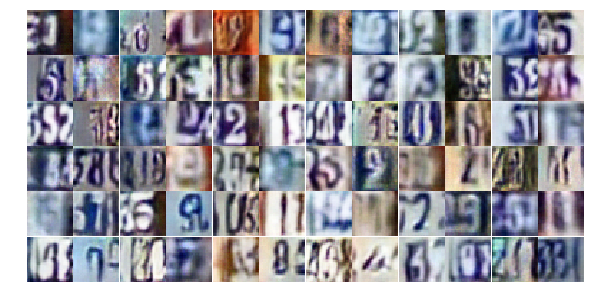

Epoch 12/25... Discriminator Loss: 0.5760... Generator Loss: 1.1210
Epoch 12/25... Discriminator Loss: 1.0031... Generator Loss: 0.6114
Epoch 12/25... Discriminator Loss: 0.7923... Generator Loss: 0.9030
Epoch 12/25... Discriminator Loss: 1.7470... Generator Loss: 0.2812
Epoch 12/25... Discriminator Loss: 0.5322... Generator Loss: 1.8145
Epoch 12/25... Discriminator Loss: 0.5793... Generator Loss: 1.4136
Epoch 12/25... Discriminator Loss: 1.0028... Generator Loss: 0.6448
Epoch 12/25... Discriminator Loss: 0.6894... Generator Loss: 1.0863
Epoch 12/25... Discriminator Loss: 0.5899... Generator Loss: 1.3708
Epoch 12/25... Discriminator Loss: 0.3251... Generator Loss: 1.9631


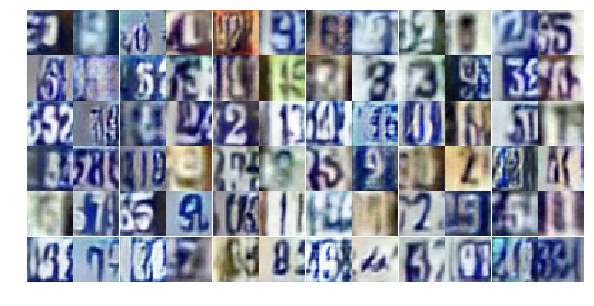

Epoch 12/25... Discriminator Loss: 0.5530... Generator Loss: 2.0867
Epoch 12/25... Discriminator Loss: 0.5115... Generator Loss: 1.2286
Epoch 12/25... Discriminator Loss: 0.5381... Generator Loss: 1.1118
Epoch 12/25... Discriminator Loss: 0.7290... Generator Loss: 1.2716
Epoch 12/25... Discriminator Loss: 0.8841... Generator Loss: 0.7534
Epoch 12/25... Discriminator Loss: 1.4764... Generator Loss: 0.4025
Epoch 12/25... Discriminator Loss: 0.9062... Generator Loss: 0.8313
Epoch 12/25... Discriminator Loss: 0.8603... Generator Loss: 0.7553
Epoch 12/25... Discriminator Loss: 0.4983... Generator Loss: 1.3581
Epoch 12/25... Discriminator Loss: 0.6085... Generator Loss: 1.1097


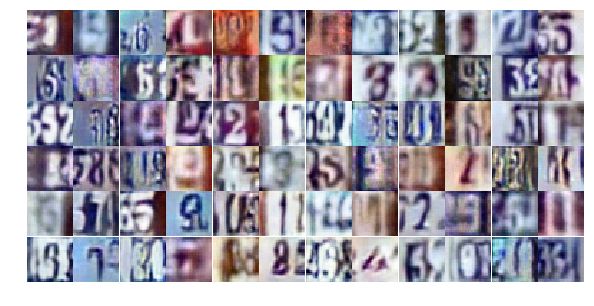

Epoch 12/25... Discriminator Loss: 0.7156... Generator Loss: 0.9943
Epoch 12/25... Discriminator Loss: 0.5829... Generator Loss: 1.2226
Epoch 12/25... Discriminator Loss: 0.8398... Generator Loss: 1.6669
Epoch 12/25... Discriminator Loss: 1.2541... Generator Loss: 0.4685
Epoch 12/25... Discriminator Loss: 0.5775... Generator Loss: 1.1045
Epoch 12/25... Discriminator Loss: 0.6526... Generator Loss: 1.3649
Epoch 12/25... Discriminator Loss: 0.7335... Generator Loss: 0.9711
Epoch 13/25... Discriminator Loss: 0.6045... Generator Loss: 1.1268
Epoch 13/25... Discriminator Loss: 0.5147... Generator Loss: 1.3095
Epoch 13/25... Discriminator Loss: 0.6933... Generator Loss: 0.9559


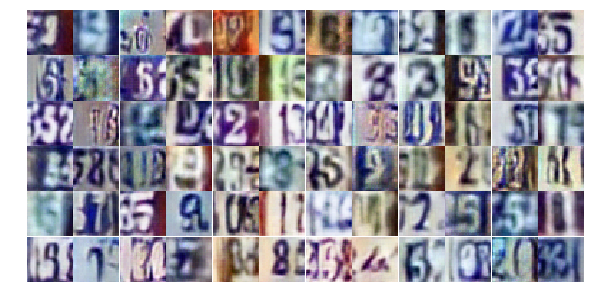

Epoch 13/25... Discriminator Loss: 0.5681... Generator Loss: 1.2267
Epoch 13/25... Discriminator Loss: 0.5860... Generator Loss: 1.2044
Epoch 13/25... Discriminator Loss: 1.1722... Generator Loss: 0.5512
Epoch 13/25... Discriminator Loss: 1.8169... Generator Loss: 0.2744
Epoch 13/25... Discriminator Loss: 0.6792... Generator Loss: 1.0834
Epoch 13/25... Discriminator Loss: 0.6200... Generator Loss: 1.1628
Epoch 13/25... Discriminator Loss: 0.3226... Generator Loss: 1.7500
Epoch 13/25... Discriminator Loss: 0.5499... Generator Loss: 1.1432
Epoch 13/25... Discriminator Loss: 0.4631... Generator Loss: 1.4014
Epoch 13/25... Discriminator Loss: 0.6877... Generator Loss: 0.9774


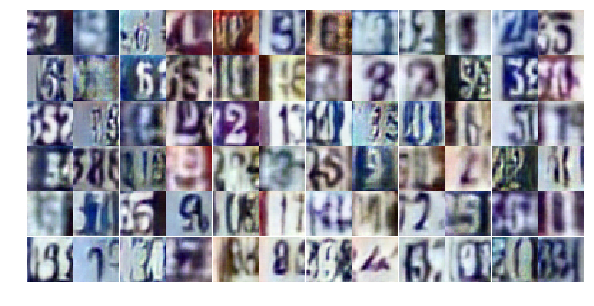

Epoch 13/25... Discriminator Loss: 0.6269... Generator Loss: 1.1817
Epoch 13/25... Discriminator Loss: 0.7123... Generator Loss: 0.8734
Epoch 13/25... Discriminator Loss: 1.5387... Generator Loss: 0.3645
Epoch 13/25... Discriminator Loss: 0.7513... Generator Loss: 1.8076
Epoch 13/25... Discriminator Loss: 0.6227... Generator Loss: 1.2448
Epoch 13/25... Discriminator Loss: 0.8312... Generator Loss: 0.7944
Epoch 13/25... Discriminator Loss: 0.6316... Generator Loss: 1.0883
Epoch 13/25... Discriminator Loss: 0.8467... Generator Loss: 0.8672
Epoch 13/25... Discriminator Loss: 0.4796... Generator Loss: 1.4033
Epoch 13/25... Discriminator Loss: 0.8765... Generator Loss: 0.7195


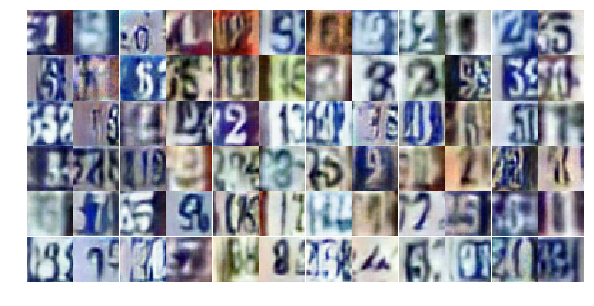

Epoch 13/25... Discriminator Loss: 0.7555... Generator Loss: 0.9112
Epoch 13/25... Discriminator Loss: 0.7717... Generator Loss: 0.9276
Epoch 13/25... Discriminator Loss: 0.4230... Generator Loss: 1.7006
Epoch 13/25... Discriminator Loss: 0.6861... Generator Loss: 0.9971
Epoch 13/25... Discriminator Loss: 0.7912... Generator Loss: 0.9326
Epoch 13/25... Discriminator Loss: 2.0636... Generator Loss: 0.2481
Epoch 13/25... Discriminator Loss: 0.9027... Generator Loss: 1.7655
Epoch 13/25... Discriminator Loss: 0.5864... Generator Loss: 1.1438
Epoch 13/25... Discriminator Loss: 0.6583... Generator Loss: 1.1029
Epoch 13/25... Discriminator Loss: 0.7701... Generator Loss: 1.0224


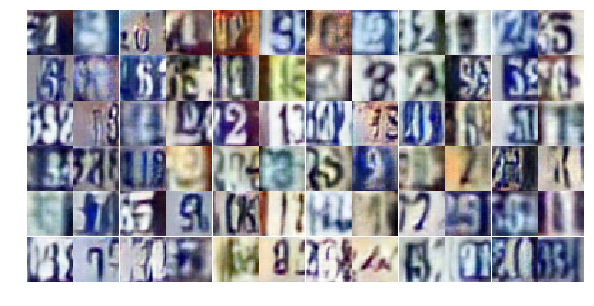

Epoch 13/25... Discriminator Loss: 0.8898... Generator Loss: 0.7655
Epoch 13/25... Discriminator Loss: 0.8140... Generator Loss: 0.9021
Epoch 13/25... Discriminator Loss: 1.1365... Generator Loss: 0.5479
Epoch 13/25... Discriminator Loss: 1.2409... Generator Loss: 0.4877
Epoch 13/25... Discriminator Loss: 0.5605... Generator Loss: 1.4674
Epoch 13/25... Discriminator Loss: 0.3672... Generator Loss: 1.6812
Epoch 13/25... Discriminator Loss: 0.5609... Generator Loss: 1.2327
Epoch 13/25... Discriminator Loss: 0.7452... Generator Loss: 1.0641
Epoch 13/25... Discriminator Loss: 0.6679... Generator Loss: 1.2249
Epoch 13/25... Discriminator Loss: 0.6276... Generator Loss: 1.1060


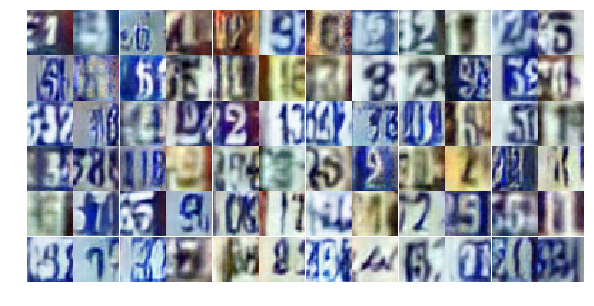

Epoch 13/25... Discriminator Loss: 0.4292... Generator Loss: 1.9653
Epoch 13/25... Discriminator Loss: 0.8382... Generator Loss: 2.6599
Epoch 13/25... Discriminator Loss: 0.7286... Generator Loss: 1.1332
Epoch 13/25... Discriminator Loss: 0.5927... Generator Loss: 1.1726
Epoch 13/25... Discriminator Loss: 1.4038... Generator Loss: 0.4134
Epoch 13/25... Discriminator Loss: 0.7837... Generator Loss: 0.8240
Epoch 13/25... Discriminator Loss: 0.8313... Generator Loss: 0.9191
Epoch 13/25... Discriminator Loss: 0.6542... Generator Loss: 1.2344
Epoch 13/25... Discriminator Loss: 0.7422... Generator Loss: 0.9812
Epoch 13/25... Discriminator Loss: 0.4875... Generator Loss: 1.2620


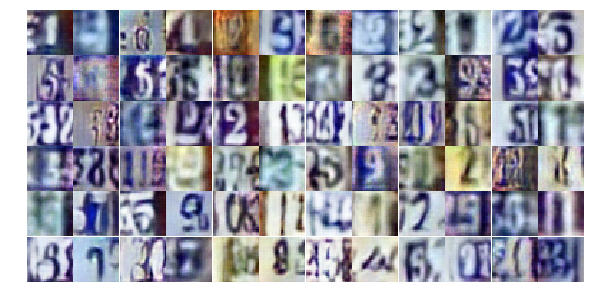

Epoch 13/25... Discriminator Loss: 0.2383... Generator Loss: 2.1912
Epoch 13/25... Discriminator Loss: 1.4149... Generator Loss: 0.3823
Epoch 13/25... Discriminator Loss: 0.6723... Generator Loss: 1.1730
Epoch 13/25... Discriminator Loss: 0.9326... Generator Loss: 0.7001
Epoch 14/25... Discriminator Loss: 0.9770... Generator Loss: 0.7383
Epoch 14/25... Discriminator Loss: 0.8369... Generator Loss: 1.0209
Epoch 14/25... Discriminator Loss: 0.9253... Generator Loss: 0.7720
Epoch 14/25... Discriminator Loss: 0.6124... Generator Loss: 1.7213
Epoch 14/25... Discriminator Loss: 0.5174... Generator Loss: 1.2940
Epoch 14/25... Discriminator Loss: 0.5494... Generator Loss: 1.2682


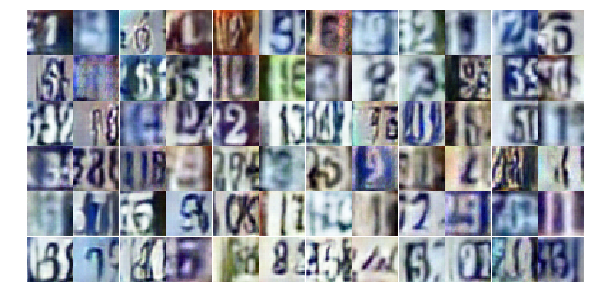

Epoch 14/25... Discriminator Loss: 0.8552... Generator Loss: 1.4372
Epoch 14/25... Discriminator Loss: 1.4806... Generator Loss: 0.4405
Epoch 14/25... Discriminator Loss: 0.7758... Generator Loss: 0.9871
Epoch 14/25... Discriminator Loss: 0.6793... Generator Loss: 1.0470
Epoch 14/25... Discriminator Loss: 0.8701... Generator Loss: 0.8148
Epoch 14/25... Discriminator Loss: 0.3642... Generator Loss: 1.5159
Epoch 14/25... Discriminator Loss: 0.4430... Generator Loss: 2.1586
Epoch 14/25... Discriminator Loss: 1.4824... Generator Loss: 0.3388
Epoch 14/25... Discriminator Loss: 0.8993... Generator Loss: 0.8353
Epoch 14/25... Discriminator Loss: 1.1846... Generator Loss: 0.5246


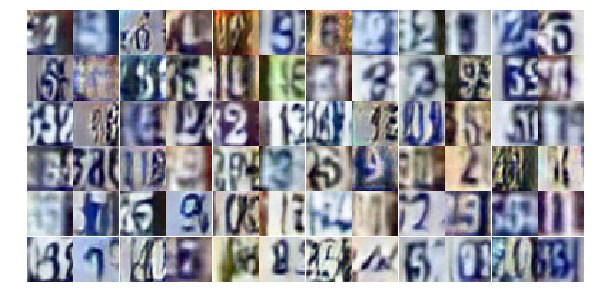

Epoch 14/25... Discriminator Loss: 0.5915... Generator Loss: 1.0516
Epoch 14/25... Discriminator Loss: 0.6293... Generator Loss: 2.0338
Epoch 14/25... Discriminator Loss: 1.0173... Generator Loss: 0.6461
Epoch 14/25... Discriminator Loss: 0.4921... Generator Loss: 1.8592
Epoch 14/25... Discriminator Loss: 0.6556... Generator Loss: 1.5331
Epoch 14/25... Discriminator Loss: 0.6689... Generator Loss: 1.2046
Epoch 14/25... Discriminator Loss: 0.5927... Generator Loss: 1.2429
Epoch 14/25... Discriminator Loss: 0.5639... Generator Loss: 1.2860
Epoch 14/25... Discriminator Loss: 0.7384... Generator Loss: 0.8693
Epoch 14/25... Discriminator Loss: 0.5212... Generator Loss: 1.6492


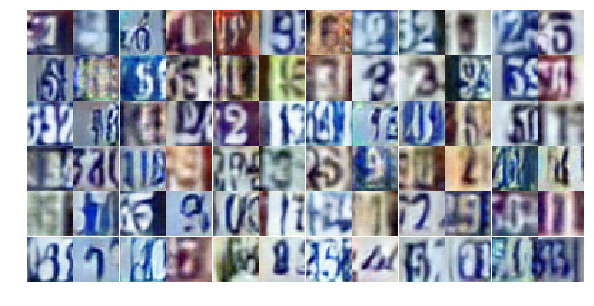

Epoch 14/25... Discriminator Loss: 1.8722... Generator Loss: 0.2848
Epoch 14/25... Discriminator Loss: 0.4697... Generator Loss: 2.1459
Epoch 14/25... Discriminator Loss: 0.3679... Generator Loss: 2.5980
Epoch 14/25... Discriminator Loss: 0.5256... Generator Loss: 1.3254
Epoch 14/25... Discriminator Loss: 0.4846... Generator Loss: 1.4118
Epoch 14/25... Discriminator Loss: 0.9762... Generator Loss: 0.7239
Epoch 14/25... Discriminator Loss: 0.7541... Generator Loss: 0.9670
Epoch 14/25... Discriminator Loss: 0.3562... Generator Loss: 1.8751
Epoch 14/25... Discriminator Loss: 0.5294... Generator Loss: 2.2079
Epoch 14/25... Discriminator Loss: 0.7087... Generator Loss: 0.9976


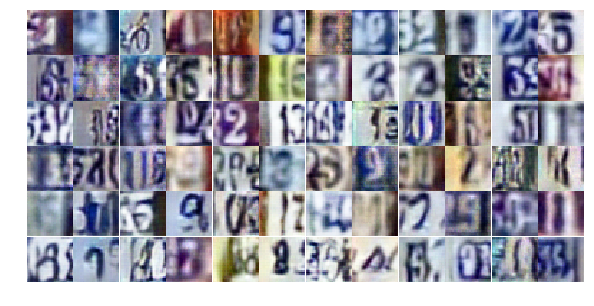

Epoch 14/25... Discriminator Loss: 1.4316... Generator Loss: 0.3890
Epoch 14/25... Discriminator Loss: 0.9653... Generator Loss: 0.7072
Epoch 14/25... Discriminator Loss: 1.2374... Generator Loss: 0.4480
Epoch 14/25... Discriminator Loss: 0.8293... Generator Loss: 0.8572
Epoch 14/25... Discriminator Loss: 0.9632... Generator Loss: 0.6508
Epoch 14/25... Discriminator Loss: 0.6175... Generator Loss: 1.3630
Epoch 14/25... Discriminator Loss: 0.6483... Generator Loss: 1.1996
Epoch 14/25... Discriminator Loss: 0.6790... Generator Loss: 1.0684
Epoch 14/25... Discriminator Loss: 0.9574... Generator Loss: 0.6967
Epoch 14/25... Discriminator Loss: 1.1548... Generator Loss: 0.5341


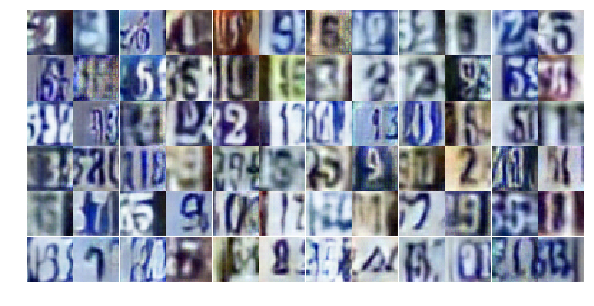

Epoch 14/25... Discriminator Loss: 0.8583... Generator Loss: 1.0434
Epoch 14/25... Discriminator Loss: 1.2576... Generator Loss: 0.4793
Epoch 14/25... Discriminator Loss: 0.6642... Generator Loss: 1.1211
Epoch 14/25... Discriminator Loss: 0.8446... Generator Loss: 0.7945
Epoch 14/25... Discriminator Loss: 0.6012... Generator Loss: 1.1821
Epoch 14/25... Discriminator Loss: 0.5166... Generator Loss: 1.4150
Epoch 14/25... Discriminator Loss: 0.6066... Generator Loss: 1.1789
Epoch 14/25... Discriminator Loss: 0.7092... Generator Loss: 0.9436
Epoch 14/25... Discriminator Loss: 1.1992... Generator Loss: 2.9388
Epoch 14/25... Discriminator Loss: 1.1494... Generator Loss: 0.4896


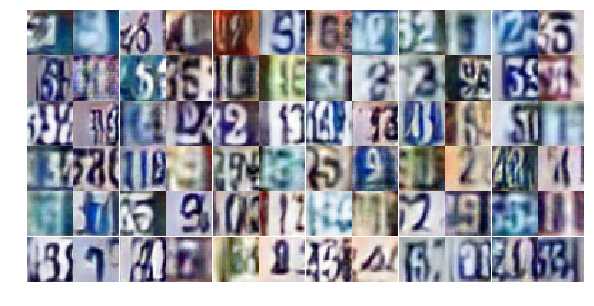

Epoch 14/25... Discriminator Loss: 0.9638... Generator Loss: 1.9924
Epoch 14/25... Discriminator Loss: 1.3569... Generator Loss: 0.4646
Epoch 15/25... Discriminator Loss: 0.9421... Generator Loss: 0.7130
Epoch 15/25... Discriminator Loss: 0.5437... Generator Loss: 1.8777
Epoch 15/25... Discriminator Loss: 0.6031... Generator Loss: 1.1728
Epoch 15/25... Discriminator Loss: 0.9369... Generator Loss: 0.7629
Epoch 15/25... Discriminator Loss: 0.7332... Generator Loss: 0.8621
Epoch 15/25... Discriminator Loss: 0.5250... Generator Loss: 1.7245
Epoch 15/25... Discriminator Loss: 1.3073... Generator Loss: 0.4884
Epoch 15/25... Discriminator Loss: 0.7687... Generator Loss: 0.8806


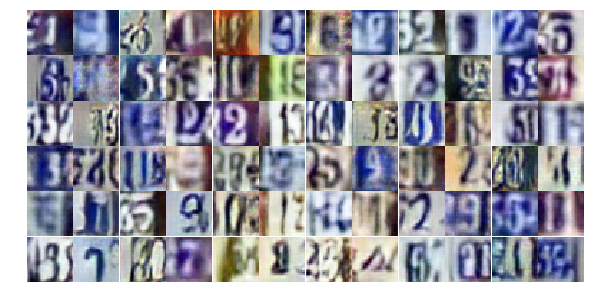

Epoch 15/25... Discriminator Loss: 0.7958... Generator Loss: 0.8715
Epoch 15/25... Discriminator Loss: 0.5597... Generator Loss: 1.7303
Epoch 15/25... Discriminator Loss: 0.6876... Generator Loss: 1.2210
Epoch 15/25... Discriminator Loss: 0.7930... Generator Loss: 0.8503
Epoch 15/25... Discriminator Loss: 1.0399... Generator Loss: 0.6522
Epoch 15/25... Discriminator Loss: 0.5925... Generator Loss: 1.2016
Epoch 15/25... Discriminator Loss: 1.1917... Generator Loss: 0.5236
Epoch 15/25... Discriminator Loss: 0.6823... Generator Loss: 1.8230
Epoch 15/25... Discriminator Loss: 1.0055... Generator Loss: 3.1067
Epoch 15/25... Discriminator Loss: 1.8370... Generator Loss: 0.2379


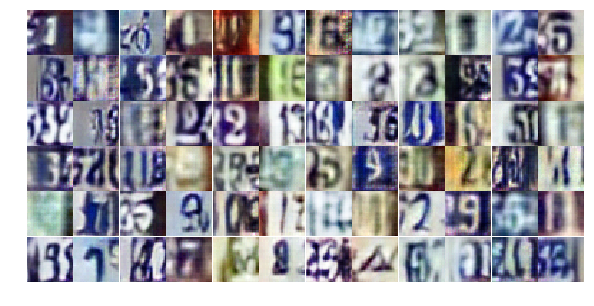

Epoch 15/25... Discriminator Loss: 0.9838... Generator Loss: 0.8176
Epoch 15/25... Discriminator Loss: 0.6440... Generator Loss: 1.1073
Epoch 15/25... Discriminator Loss: 0.4053... Generator Loss: 1.9506
Epoch 15/25... Discriminator Loss: 0.9053... Generator Loss: 0.7706
Epoch 15/25... Discriminator Loss: 1.0902... Generator Loss: 0.5710
Epoch 15/25... Discriminator Loss: 0.6388... Generator Loss: 1.2068
Epoch 15/25... Discriminator Loss: 0.6766... Generator Loss: 1.1041
Epoch 15/25... Discriminator Loss: 0.6480... Generator Loss: 1.1486
Epoch 15/25... Discriminator Loss: 0.5596... Generator Loss: 1.2039
Epoch 15/25... Discriminator Loss: 1.1762... Generator Loss: 0.6092


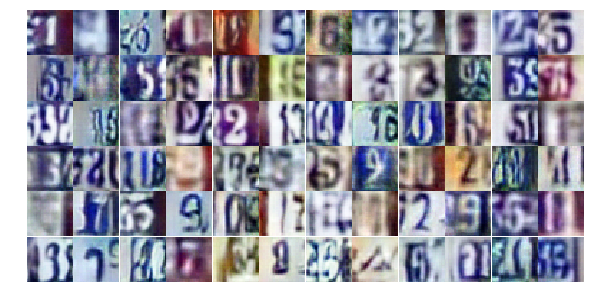

Epoch 15/25... Discriminator Loss: 0.6426... Generator Loss: 1.0404
Epoch 15/25... Discriminator Loss: 0.5314... Generator Loss: 1.6177
Epoch 15/25... Discriminator Loss: 0.4718... Generator Loss: 1.3286
Epoch 15/25... Discriminator Loss: 0.7300... Generator Loss: 1.0024
Epoch 15/25... Discriminator Loss: 0.7182... Generator Loss: 1.5702
Epoch 15/25... Discriminator Loss: 0.7138... Generator Loss: 1.8730
Epoch 15/25... Discriminator Loss: 0.4188... Generator Loss: 1.8785
Epoch 15/25... Discriminator Loss: 0.9194... Generator Loss: 0.6913
Epoch 15/25... Discriminator Loss: 0.4566... Generator Loss: 1.6220
Epoch 15/25... Discriminator Loss: 0.6767... Generator Loss: 1.0077


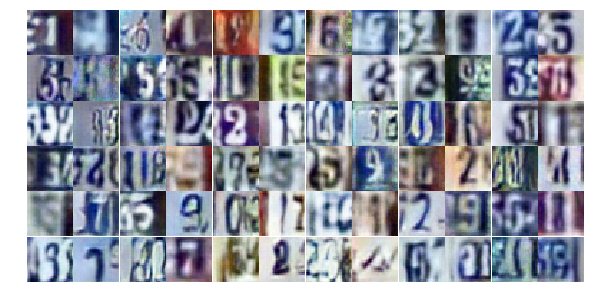

Epoch 15/25... Discriminator Loss: 0.7702... Generator Loss: 0.8649
Epoch 15/25... Discriminator Loss: 1.5783... Generator Loss: 0.3320
Epoch 15/25... Discriminator Loss: 0.7974... Generator Loss: 0.8212
Epoch 15/25... Discriminator Loss: 0.5385... Generator Loss: 1.1837
Epoch 15/25... Discriminator Loss: 0.5548... Generator Loss: 1.2162
Epoch 15/25... Discriminator Loss: 1.5747... Generator Loss: 2.6217
Epoch 15/25... Discriminator Loss: 0.5142... Generator Loss: 1.2746
Epoch 15/25... Discriminator Loss: 0.6373... Generator Loss: 1.8095
Epoch 15/25... Discriminator Loss: 0.7348... Generator Loss: 0.9337
Epoch 15/25... Discriminator Loss: 0.8602... Generator Loss: 1.0487


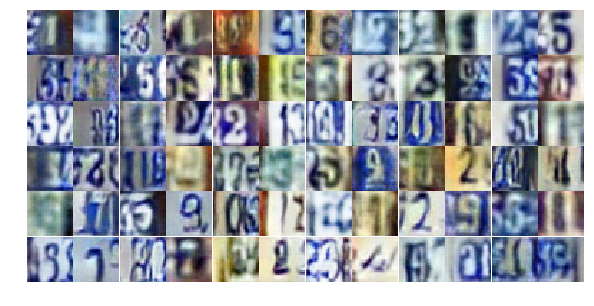

Epoch 15/25... Discriminator Loss: 0.9420... Generator Loss: 0.6718
Epoch 15/25... Discriminator Loss: 0.9980... Generator Loss: 0.7528
Epoch 15/25... Discriminator Loss: 0.3994... Generator Loss: 1.5032
Epoch 15/25... Discriminator Loss: 2.1802... Generator Loss: 0.2340
Epoch 15/25... Discriminator Loss: 1.4953... Generator Loss: 0.5891
Epoch 15/25... Discriminator Loss: 0.8420... Generator Loss: 0.9559
Epoch 15/25... Discriminator Loss: 1.4506... Generator Loss: 0.4251
Epoch 15/25... Discriminator Loss: 0.5437... Generator Loss: 1.5712
Epoch 15/25... Discriminator Loss: 1.3786... Generator Loss: 0.4057
Epoch 16/25... Discriminator Loss: 1.2608... Generator Loss: 0.5151


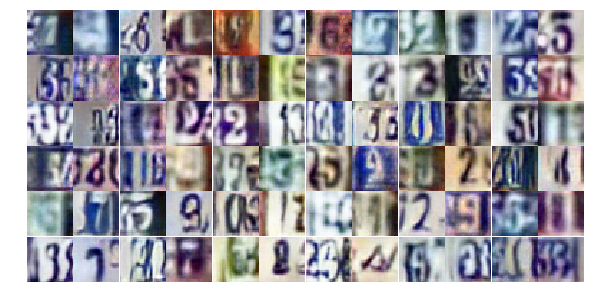

Epoch 16/25... Discriminator Loss: 0.6572... Generator Loss: 1.1574
Epoch 16/25... Discriminator Loss: 0.8603... Generator Loss: 0.8320
Epoch 16/25... Discriminator Loss: 1.1356... Generator Loss: 0.5661
Epoch 16/25... Discriminator Loss: 0.5969... Generator Loss: 1.3026
Epoch 16/25... Discriminator Loss: 0.6741... Generator Loss: 1.2889
Epoch 16/25... Discriminator Loss: 0.7533... Generator Loss: 1.0639
Epoch 16/25... Discriminator Loss: 1.8073... Generator Loss: 0.2554
Epoch 16/25... Discriminator Loss: 0.9017... Generator Loss: 0.7344
Epoch 16/25... Discriminator Loss: 0.5463... Generator Loss: 1.2432
Epoch 16/25... Discriminator Loss: 0.5209... Generator Loss: 1.2109


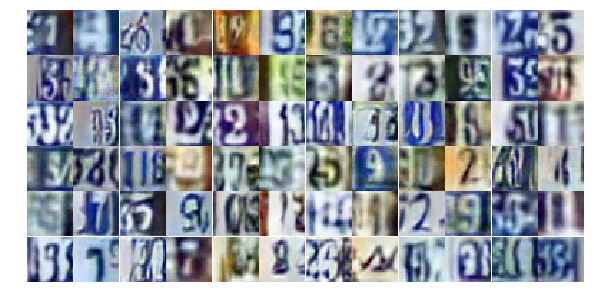

Epoch 16/25... Discriminator Loss: 1.3904... Generator Loss: 0.4422
Epoch 16/25... Discriminator Loss: 0.5998... Generator Loss: 1.3978
Epoch 16/25... Discriminator Loss: 0.8337... Generator Loss: 0.9767
Epoch 16/25... Discriminator Loss: 1.2925... Generator Loss: 0.4433
Epoch 16/25... Discriminator Loss: 0.5751... Generator Loss: 2.2445
Epoch 16/25... Discriminator Loss: 0.6043... Generator Loss: 1.2477
Epoch 16/25... Discriminator Loss: 0.9715... Generator Loss: 0.7462
Epoch 16/25... Discriminator Loss: 0.4101... Generator Loss: 1.7511
Epoch 16/25... Discriminator Loss: 0.4362... Generator Loss: 1.3997
Epoch 16/25... Discriminator Loss: 0.5240... Generator Loss: 1.3539


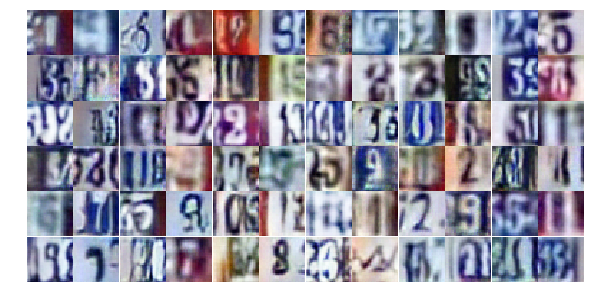

Epoch 16/25... Discriminator Loss: 0.5776... Generator Loss: 1.3436
Epoch 16/25... Discriminator Loss: 0.5614... Generator Loss: 1.3176
Epoch 16/25... Discriminator Loss: 0.6589... Generator Loss: 1.1110
Epoch 16/25... Discriminator Loss: 1.2635... Generator Loss: 0.4541
Epoch 16/25... Discriminator Loss: 0.9504... Generator Loss: 0.7478
Epoch 16/25... Discriminator Loss: 0.9151... Generator Loss: 0.8291
Epoch 16/25... Discriminator Loss: 1.7943... Generator Loss: 0.2536
Epoch 16/25... Discriminator Loss: 0.7860... Generator Loss: 0.9695
Epoch 16/25... Discriminator Loss: 0.9512... Generator Loss: 0.7699
Epoch 16/25... Discriminator Loss: 0.6285... Generator Loss: 1.2851


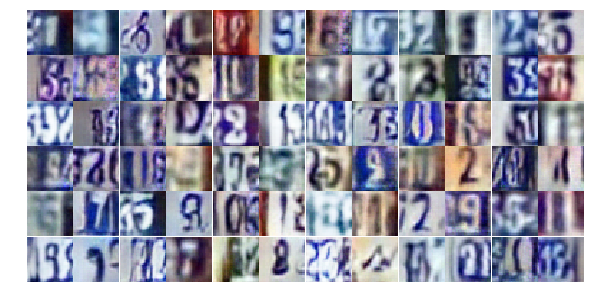

Epoch 16/25... Discriminator Loss: 0.6735... Generator Loss: 0.9457
Epoch 16/25... Discriminator Loss: 0.6037... Generator Loss: 1.1475
Epoch 16/25... Discriminator Loss: 0.6573... Generator Loss: 1.1529
Epoch 16/25... Discriminator Loss: 0.6472... Generator Loss: 1.1690
Epoch 16/25... Discriminator Loss: 1.2450... Generator Loss: 0.4890
Epoch 16/25... Discriminator Loss: 0.7621... Generator Loss: 1.2342
Epoch 16/25... Discriminator Loss: 1.1836... Generator Loss: 0.5195
Epoch 16/25... Discriminator Loss: 0.8995... Generator Loss: 0.7867
Epoch 16/25... Discriminator Loss: 0.7580... Generator Loss: 0.9007
Epoch 16/25... Discriminator Loss: 0.4396... Generator Loss: 1.4556


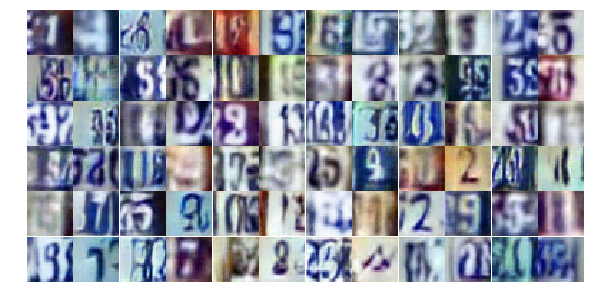

Epoch 16/25... Discriminator Loss: 0.6767... Generator Loss: 0.9854
Epoch 16/25... Discriminator Loss: 0.5980... Generator Loss: 1.5621
Epoch 16/25... Discriminator Loss: 1.4668... Generator Loss: 0.4563
Epoch 16/25... Discriminator Loss: 0.8538... Generator Loss: 0.9766
Epoch 16/25... Discriminator Loss: 0.8193... Generator Loss: 0.8887
Epoch 16/25... Discriminator Loss: 1.2006... Generator Loss: 0.4855
Epoch 16/25... Discriminator Loss: 0.5825... Generator Loss: 1.3483
Epoch 16/25... Discriminator Loss: 0.7079... Generator Loss: 0.9712
Epoch 16/25... Discriminator Loss: 0.5593... Generator Loss: 1.3037
Epoch 16/25... Discriminator Loss: 1.0341... Generator Loss: 0.6699


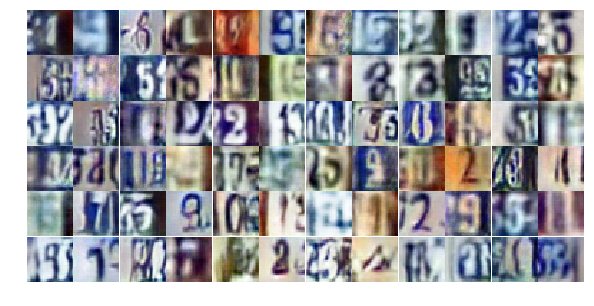

Epoch 16/25... Discriminator Loss: 1.2737... Generator Loss: 0.4461
Epoch 16/25... Discriminator Loss: 0.7829... Generator Loss: 1.2574
Epoch 16/25... Discriminator Loss: 1.0698... Generator Loss: 0.6280
Epoch 16/25... Discriminator Loss: 0.2916... Generator Loss: 2.3441
Epoch 16/25... Discriminator Loss: 0.5807... Generator Loss: 1.6418
Epoch 16/25... Discriminator Loss: 0.9827... Generator Loss: 0.7595
Epoch 17/25... Discriminator Loss: 0.6534... Generator Loss: 1.2180
Epoch 17/25... Discriminator Loss: 0.8836... Generator Loss: 0.8083
Epoch 17/25... Discriminator Loss: 0.7403... Generator Loss: 1.0151
Epoch 17/25... Discriminator Loss: 1.1291... Generator Loss: 0.5702


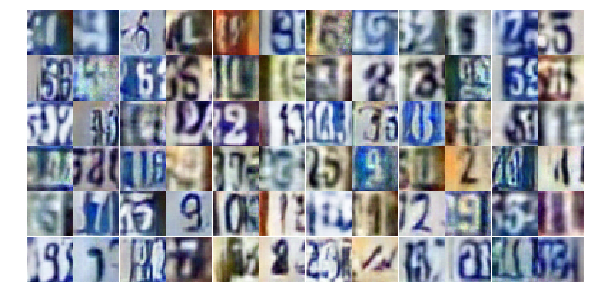

Epoch 17/25... Discriminator Loss: 0.5704... Generator Loss: 1.3806
Epoch 17/25... Discriminator Loss: 0.6477... Generator Loss: 1.1023
Epoch 17/25... Discriminator Loss: 0.9413... Generator Loss: 0.8462
Epoch 17/25... Discriminator Loss: 0.6994... Generator Loss: 1.0082
Epoch 17/25... Discriminator Loss: 1.5986... Generator Loss: 0.3158
Epoch 17/25... Discriminator Loss: 1.2323... Generator Loss: 0.5223
Epoch 17/25... Discriminator Loss: 1.0778... Generator Loss: 2.1264
Epoch 17/25... Discriminator Loss: 0.6940... Generator Loss: 1.0348
Epoch 17/25... Discriminator Loss: 0.4478... Generator Loss: 1.4987
Epoch 17/25... Discriminator Loss: 0.5984... Generator Loss: 1.2841


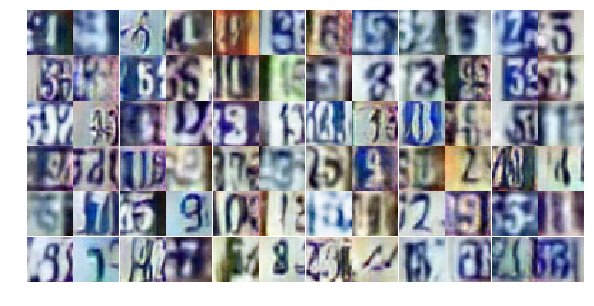

Epoch 17/25... Discriminator Loss: 1.1029... Generator Loss: 0.6303
Epoch 17/25... Discriminator Loss: 0.5122... Generator Loss: 1.6427
Epoch 17/25... Discriminator Loss: 0.5915... Generator Loss: 1.2300
Epoch 17/25... Discriminator Loss: 0.8174... Generator Loss: 1.2027
Epoch 17/25... Discriminator Loss: 0.5600... Generator Loss: 1.5834
Epoch 17/25... Discriminator Loss: 0.9225... Generator Loss: 0.7544
Epoch 17/25... Discriminator Loss: 0.5349... Generator Loss: 1.4288
Epoch 17/25... Discriminator Loss: 0.6234... Generator Loss: 1.1955
Epoch 17/25... Discriminator Loss: 0.7575... Generator Loss: 0.9797
Epoch 17/25... Discriminator Loss: 0.5546... Generator Loss: 1.2067


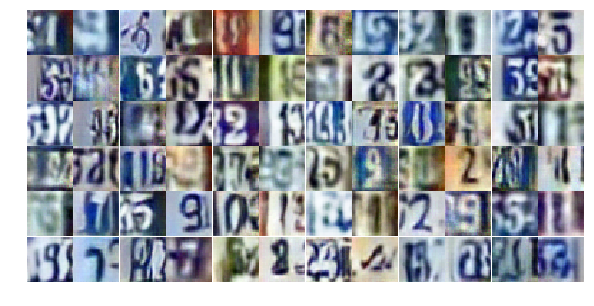

Epoch 17/25... Discriminator Loss: 1.4605... Generator Loss: 0.3648
Epoch 17/25... Discriminator Loss: 0.6303... Generator Loss: 1.2343
Epoch 17/25... Discriminator Loss: 0.4723... Generator Loss: 1.7707
Epoch 17/25... Discriminator Loss: 0.9976... Generator Loss: 0.6721
Epoch 17/25... Discriminator Loss: 1.3448... Generator Loss: 0.4790
Epoch 17/25... Discriminator Loss: 0.6603... Generator Loss: 1.0569
Epoch 17/25... Discriminator Loss: 0.7353... Generator Loss: 0.9527
Epoch 17/25... Discriminator Loss: 0.7328... Generator Loss: 1.0121
Epoch 17/25... Discriminator Loss: 1.0206... Generator Loss: 0.6044
Epoch 17/25... Discriminator Loss: 0.4877... Generator Loss: 1.4396


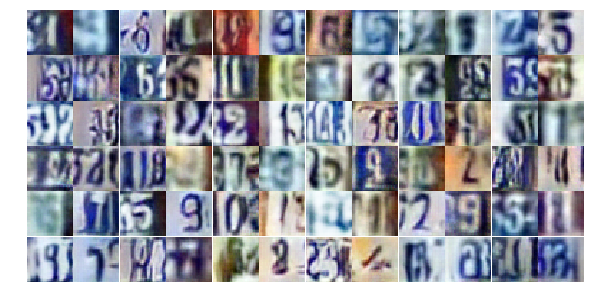

Epoch 17/25... Discriminator Loss: 0.5120... Generator Loss: 1.3785
Epoch 17/25... Discriminator Loss: 1.3663... Generator Loss: 0.4264
Epoch 17/25... Discriminator Loss: 0.5466... Generator Loss: 1.6657
Epoch 17/25... Discriminator Loss: 0.6794... Generator Loss: 1.2105
Epoch 17/25... Discriminator Loss: 1.0818... Generator Loss: 0.5851
Epoch 17/25... Discriminator Loss: 0.6970... Generator Loss: 1.5886
Epoch 17/25... Discriminator Loss: 0.9640... Generator Loss: 0.6650
Epoch 17/25... Discriminator Loss: 0.5149... Generator Loss: 1.4523
Epoch 17/25... Discriminator Loss: 0.3582... Generator Loss: 1.8309
Epoch 17/25... Discriminator Loss: 0.7506... Generator Loss: 1.0066


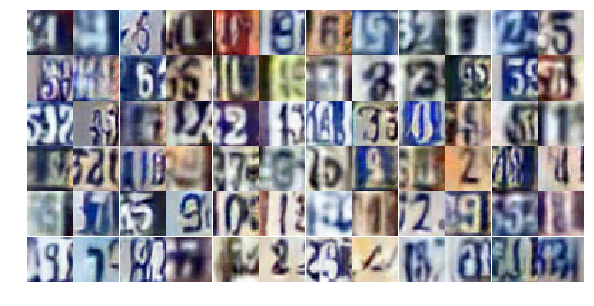

Epoch 17/25... Discriminator Loss: 1.5021... Generator Loss: 2.4610
Epoch 17/25... Discriminator Loss: 0.2700... Generator Loss: 2.2551
Epoch 17/25... Discriminator Loss: 0.7293... Generator Loss: 1.1746
Epoch 17/25... Discriminator Loss: 0.3909... Generator Loss: 1.6053
Epoch 17/25... Discriminator Loss: 0.8263... Generator Loss: 0.8071
Epoch 17/25... Discriminator Loss: 0.8429... Generator Loss: 0.7550
Epoch 17/25... Discriminator Loss: 1.2493... Generator Loss: 0.4701
Epoch 17/25... Discriminator Loss: 0.5768... Generator Loss: 1.2782
Epoch 17/25... Discriminator Loss: 0.9805... Generator Loss: 0.9846
Epoch 17/25... Discriminator Loss: 1.2983... Generator Loss: 0.5346


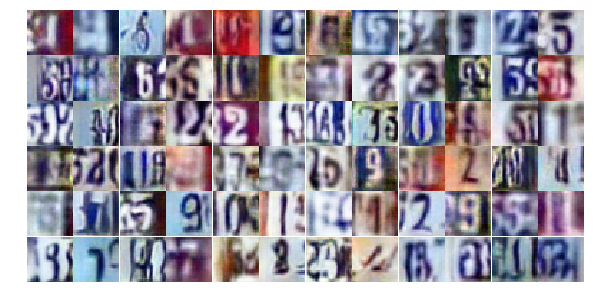

Epoch 17/25... Discriminator Loss: 0.7600... Generator Loss: 1.5978
Epoch 17/25... Discriminator Loss: 0.8526... Generator Loss: 0.8702
Epoch 17/25... Discriminator Loss: 0.4263... Generator Loss: 1.7495
Epoch 17/25... Discriminator Loss: 0.5662... Generator Loss: 1.2224
Epoch 18/25... Discriminator Loss: 1.1477... Generator Loss: 0.6440
Epoch 18/25... Discriminator Loss: 1.1160... Generator Loss: 0.6236
Epoch 18/25... Discriminator Loss: 0.7201... Generator Loss: 0.9610
Epoch 18/25... Discriminator Loss: 0.6895... Generator Loss: 0.9505
Epoch 18/25... Discriminator Loss: 1.1575... Generator Loss: 0.4978
Epoch 18/25... Discriminator Loss: 0.6146... Generator Loss: 1.1488


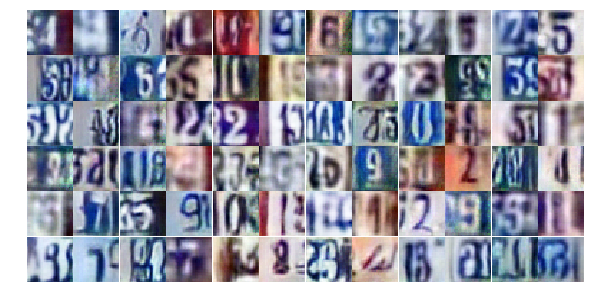

Epoch 18/25... Discriminator Loss: 0.3071... Generator Loss: 1.8829
Epoch 18/25... Discriminator Loss: 0.6375... Generator Loss: 1.1179
Epoch 18/25... Discriminator Loss: 0.7377... Generator Loss: 0.9771
Epoch 18/25... Discriminator Loss: 0.6020... Generator Loss: 1.1605
Epoch 18/25... Discriminator Loss: 0.7384... Generator Loss: 0.9907
Epoch 18/25... Discriminator Loss: 1.2804... Generator Loss: 0.4835
Epoch 18/25... Discriminator Loss: 0.7211... Generator Loss: 1.0437
Epoch 18/25... Discriminator Loss: 1.0650... Generator Loss: 0.5992
Epoch 18/25... Discriminator Loss: 0.5507... Generator Loss: 1.4884
Epoch 18/25... Discriminator Loss: 0.3157... Generator Loss: 2.1348


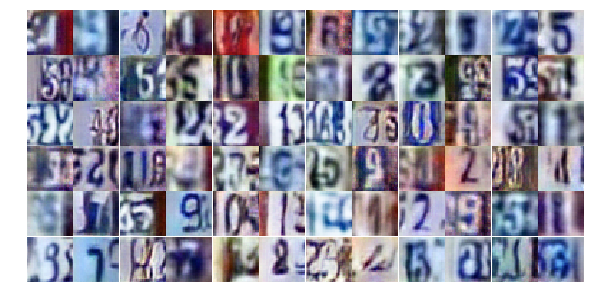

Epoch 18/25... Discriminator Loss: 1.5238... Generator Loss: 0.4326
Epoch 18/25... Discriminator Loss: 1.3635... Generator Loss: 4.8368
Epoch 18/25... Discriminator Loss: 1.1398... Generator Loss: 0.6321
Epoch 18/25... Discriminator Loss: 0.5798... Generator Loss: 1.3465
Epoch 18/25... Discriminator Loss: 1.0253... Generator Loss: 0.6586
Epoch 18/25... Discriminator Loss: 0.9340... Generator Loss: 0.7831
Epoch 18/25... Discriminator Loss: 0.9328... Generator Loss: 0.9340
Epoch 18/25... Discriminator Loss: 1.0787... Generator Loss: 0.6482
Epoch 18/25... Discriminator Loss: 1.1062... Generator Loss: 0.5857
Epoch 18/25... Discriminator Loss: 0.5323... Generator Loss: 1.3181


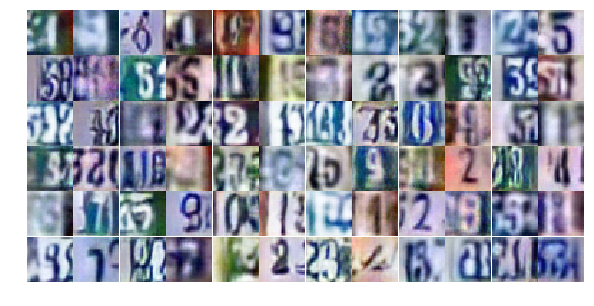

Epoch 18/25... Discriminator Loss: 0.6295... Generator Loss: 1.0102
Epoch 18/25... Discriminator Loss: 1.0530... Generator Loss: 0.6279
Epoch 18/25... Discriminator Loss: 0.6675... Generator Loss: 0.9939
Epoch 18/25... Discriminator Loss: 0.7359... Generator Loss: 1.0162
Epoch 18/25... Discriminator Loss: 0.9950... Generator Loss: 0.6431
Epoch 18/25... Discriminator Loss: 0.6045... Generator Loss: 1.2492
Epoch 18/25... Discriminator Loss: 0.5407... Generator Loss: 1.2463
Epoch 18/25... Discriminator Loss: 0.5339... Generator Loss: 1.6961
Epoch 18/25... Discriminator Loss: 0.5103... Generator Loss: 1.2976
Epoch 18/25... Discriminator Loss: 0.7062... Generator Loss: 0.9366


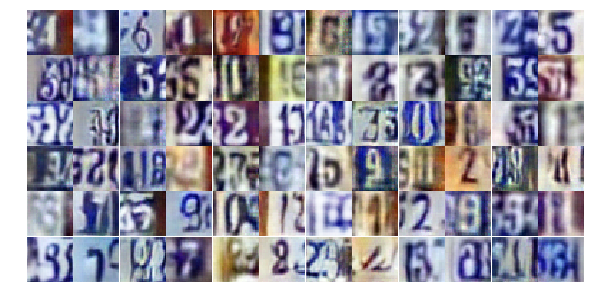

Epoch 18/25... Discriminator Loss: 0.5951... Generator Loss: 1.4300
Epoch 18/25... Discriminator Loss: 0.8569... Generator Loss: 0.8381
Epoch 18/25... Discriminator Loss: 0.5057... Generator Loss: 1.2628
Epoch 18/25... Discriminator Loss: 0.6104... Generator Loss: 1.0690
Epoch 18/25... Discriminator Loss: 0.8999... Generator Loss: 0.7338
Epoch 18/25... Discriminator Loss: 0.4293... Generator Loss: 1.3658
Epoch 18/25... Discriminator Loss: 1.2782... Generator Loss: 0.4474
Epoch 18/25... Discriminator Loss: 1.2804... Generator Loss: 2.9542
Epoch 18/25... Discriminator Loss: 1.0710... Generator Loss: 0.6467
Epoch 18/25... Discriminator Loss: 0.5569... Generator Loss: 1.2732


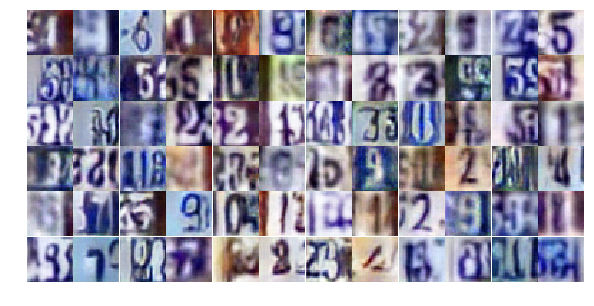

Epoch 18/25... Discriminator Loss: 0.7738... Generator Loss: 1.1382
Epoch 18/25... Discriminator Loss: 1.0269... Generator Loss: 0.6783
Epoch 18/25... Discriminator Loss: 0.7082... Generator Loss: 1.0436
Epoch 18/25... Discriminator Loss: 0.7757... Generator Loss: 1.0162
Epoch 18/25... Discriminator Loss: 0.6380... Generator Loss: 1.1792
Epoch 18/25... Discriminator Loss: 0.5996... Generator Loss: 1.7776
Epoch 18/25... Discriminator Loss: 0.5187... Generator Loss: 1.3426
Epoch 18/25... Discriminator Loss: 0.5518... Generator Loss: 1.5961
Epoch 18/25... Discriminator Loss: 0.9505... Generator Loss: 0.6998
Epoch 18/25... Discriminator Loss: 0.6033... Generator Loss: 1.0667


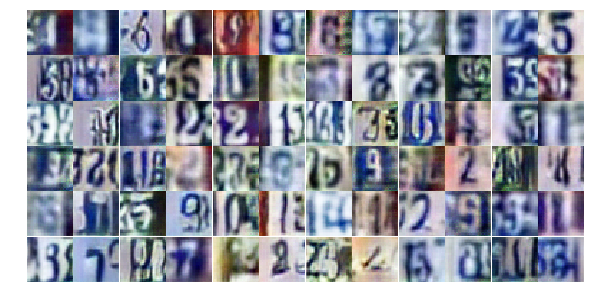

Epoch 18/25... Discriminator Loss: 0.6386... Generator Loss: 1.7098
Epoch 19/25... Discriminator Loss: 1.4303... Generator Loss: 0.3731
Epoch 19/25... Discriminator Loss: 1.4846... Generator Loss: 0.3653
Epoch 19/25... Discriminator Loss: 1.0020... Generator Loss: 0.7506
Epoch 19/25... Discriminator Loss: 0.7007... Generator Loss: 1.0300
Epoch 19/25... Discriminator Loss: 1.0293... Generator Loss: 0.6569
Epoch 19/25... Discriminator Loss: 0.5083... Generator Loss: 1.4715
Epoch 19/25... Discriminator Loss: 1.3421... Generator Loss: 0.4130
Epoch 19/25... Discriminator Loss: 0.5499... Generator Loss: 1.9434
Epoch 19/25... Discriminator Loss: 0.8755... Generator Loss: 0.8000


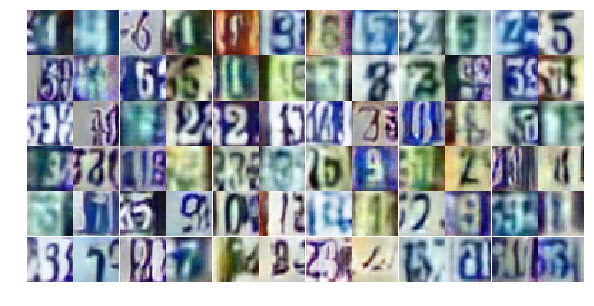

Epoch 19/25... Discriminator Loss: 0.6149... Generator Loss: 1.1309
Epoch 19/25... Discriminator Loss: 0.7318... Generator Loss: 0.9867
Epoch 19/25... Discriminator Loss: 0.7655... Generator Loss: 1.1625
Epoch 19/25... Discriminator Loss: 1.5588... Generator Loss: 0.3398
Epoch 19/25... Discriminator Loss: 1.3265... Generator Loss: 0.4883
Epoch 19/25... Discriminator Loss: 0.5990... Generator Loss: 1.9401
Epoch 19/25... Discriminator Loss: 1.0451... Generator Loss: 0.7279
Epoch 19/25... Discriminator Loss: 0.6467... Generator Loss: 1.4528
Epoch 19/25... Discriminator Loss: 0.7360... Generator Loss: 2.2073
Epoch 19/25... Discriminator Loss: 0.8137... Generator Loss: 0.8425


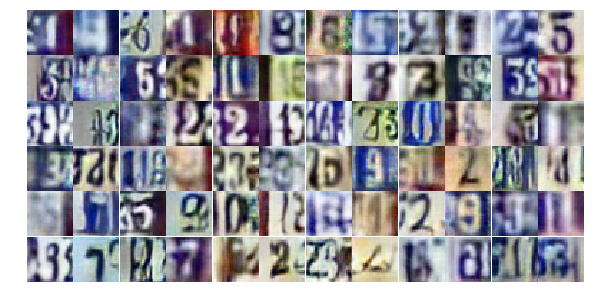

Epoch 19/25... Discriminator Loss: 0.9282... Generator Loss: 0.6639
Epoch 19/25... Discriminator Loss: 1.3340... Generator Loss: 0.4366
Epoch 19/25... Discriminator Loss: 1.8066... Generator Loss: 0.2615
Epoch 19/25... Discriminator Loss: 0.9038... Generator Loss: 0.8002
Epoch 19/25... Discriminator Loss: 1.1906... Generator Loss: 0.5928
Epoch 19/25... Discriminator Loss: 0.7065... Generator Loss: 0.9588
Epoch 19/25... Discriminator Loss: 0.8617... Generator Loss: 0.8124
Epoch 19/25... Discriminator Loss: 0.5195... Generator Loss: 1.4073
Epoch 19/25... Discriminator Loss: 0.7054... Generator Loss: 1.0869
Epoch 19/25... Discriminator Loss: 1.2747... Generator Loss: 0.4491


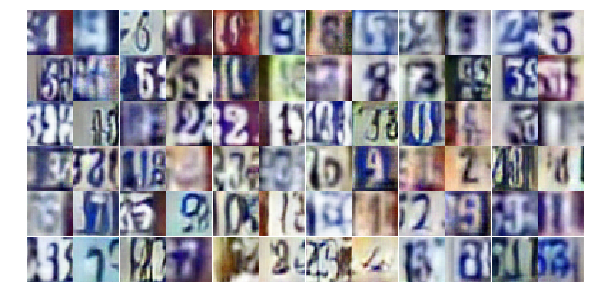

Epoch 19/25... Discriminator Loss: 1.2330... Generator Loss: 0.5041
Epoch 19/25... Discriminator Loss: 0.6635... Generator Loss: 0.9709
Epoch 19/25... Discriminator Loss: 0.9220... Generator Loss: 0.7314
Epoch 19/25... Discriminator Loss: 0.9150... Generator Loss: 0.8182
Epoch 19/25... Discriminator Loss: 0.7700... Generator Loss: 0.8893
Epoch 19/25... Discriminator Loss: 1.2725... Generator Loss: 0.4722
Epoch 19/25... Discriminator Loss: 0.6351... Generator Loss: 1.4098
Epoch 19/25... Discriminator Loss: 0.5108... Generator Loss: 1.5403
Epoch 19/25... Discriminator Loss: 0.6888... Generator Loss: 1.0542
Epoch 19/25... Discriminator Loss: 0.5886... Generator Loss: 1.0741


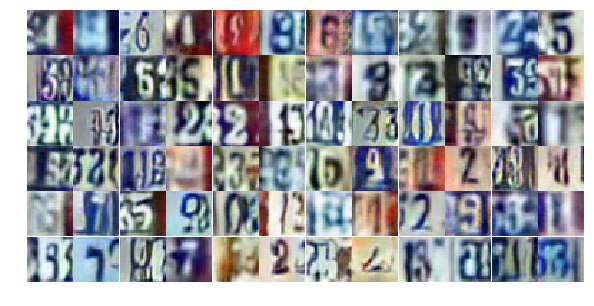

Epoch 19/25... Discriminator Loss: 0.3887... Generator Loss: 1.5315
Epoch 19/25... Discriminator Loss: 0.6487... Generator Loss: 1.1460
Epoch 19/25... Discriminator Loss: 0.8756... Generator Loss: 0.7866
Epoch 19/25... Discriminator Loss: 0.6852... Generator Loss: 0.9466
Epoch 19/25... Discriminator Loss: 0.7239... Generator Loss: 0.9629
Epoch 19/25... Discriminator Loss: 2.1035... Generator Loss: 3.3736
Epoch 19/25... Discriminator Loss: 1.2952... Generator Loss: 2.8508
Epoch 19/25... Discriminator Loss: 0.6906... Generator Loss: 2.0563
Epoch 19/25... Discriminator Loss: 0.9474... Generator Loss: 0.8035
Epoch 19/25... Discriminator Loss: 1.0235... Generator Loss: 0.6551


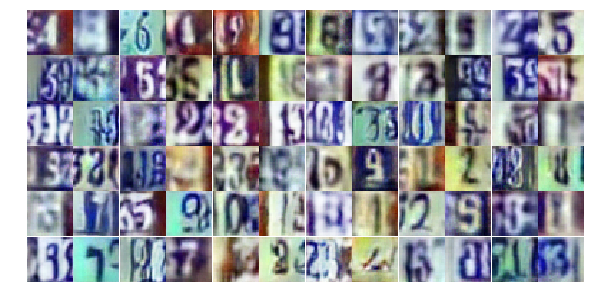

Epoch 19/25... Discriminator Loss: 0.9917... Generator Loss: 0.7045
Epoch 19/25... Discriminator Loss: 1.0536... Generator Loss: 0.6859
Epoch 19/25... Discriminator Loss: 0.6320... Generator Loss: 1.7107
Epoch 19/25... Discriminator Loss: 0.8098... Generator Loss: 0.9933
Epoch 19/25... Discriminator Loss: 0.9962... Generator Loss: 0.6146
Epoch 19/25... Discriminator Loss: 0.7661... Generator Loss: 1.6135
Epoch 19/25... Discriminator Loss: 1.8645... Generator Loss: 0.2617
Epoch 19/25... Discriminator Loss: 0.6670... Generator Loss: 1.0023
Epoch 20/25... Discriminator Loss: 0.6714... Generator Loss: 1.0887
Epoch 20/25... Discriminator Loss: 0.9709... Generator Loss: 0.7134


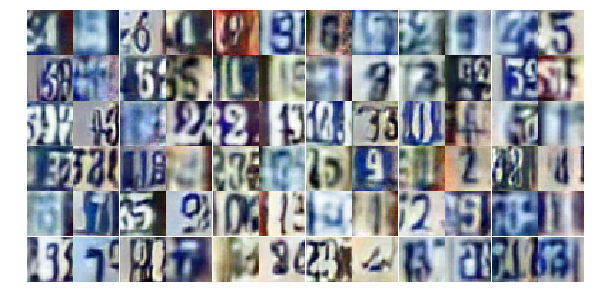

Epoch 20/25... Discriminator Loss: 0.7113... Generator Loss: 0.9661
Epoch 20/25... Discriminator Loss: 0.8113... Generator Loss: 0.9049
Epoch 20/25... Discriminator Loss: 0.9548... Generator Loss: 0.6985
Epoch 20/25... Discriminator Loss: 0.8028... Generator Loss: 0.9120
Epoch 20/25... Discriminator Loss: 0.5483... Generator Loss: 1.2797
Epoch 20/25... Discriminator Loss: 0.5887... Generator Loss: 1.1266
Epoch 20/25... Discriminator Loss: 0.6763... Generator Loss: 1.0238
Epoch 20/25... Discriminator Loss: 0.8695... Generator Loss: 0.8096
Epoch 20/25... Discriminator Loss: 0.7072... Generator Loss: 1.3315
Epoch 20/25... Discriminator Loss: 0.7559... Generator Loss: 0.9532


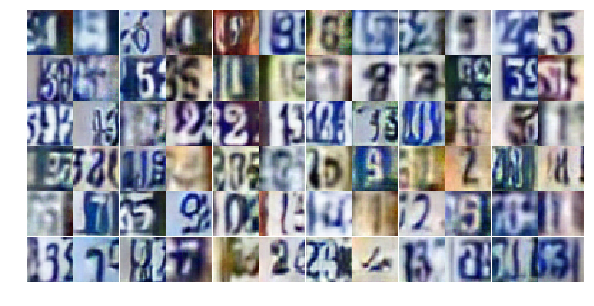

Epoch 20/25... Discriminator Loss: 1.2871... Generator Loss: 0.4985
Epoch 20/25... Discriminator Loss: 0.7595... Generator Loss: 1.0193
Epoch 20/25... Discriminator Loss: 0.5171... Generator Loss: 1.7779
Epoch 20/25... Discriminator Loss: 1.0761... Generator Loss: 0.6520
Epoch 20/25... Discriminator Loss: 0.9211... Generator Loss: 0.8135
Epoch 20/25... Discriminator Loss: 1.2760... Generator Loss: 0.4708
Epoch 20/25... Discriminator Loss: 0.9743... Generator Loss: 0.6798
Epoch 20/25... Discriminator Loss: 0.9439... Generator Loss: 0.6969
Epoch 20/25... Discriminator Loss: 0.4711... Generator Loss: 1.3518
Epoch 20/25... Discriminator Loss: 0.9554... Generator Loss: 0.7207


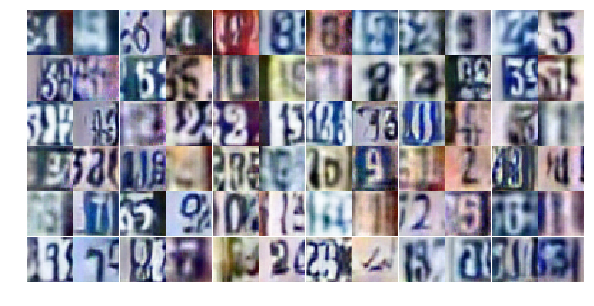

Epoch 20/25... Discriminator Loss: 0.6248... Generator Loss: 1.0570
Epoch 20/25... Discriminator Loss: 0.6451... Generator Loss: 1.1658
Epoch 20/25... Discriminator Loss: 0.2804... Generator Loss: 2.2080
Epoch 20/25... Discriminator Loss: 1.1409... Generator Loss: 0.5628
Epoch 20/25... Discriminator Loss: 0.9982... Generator Loss: 0.7121
Epoch 20/25... Discriminator Loss: 0.5326... Generator Loss: 1.1482
Epoch 20/25... Discriminator Loss: 0.6213... Generator Loss: 1.6051
Epoch 20/25... Discriminator Loss: 1.8845... Generator Loss: 0.2516
Epoch 20/25... Discriminator Loss: 1.1710... Generator Loss: 0.5337
Epoch 20/25... Discriminator Loss: 0.5518... Generator Loss: 1.1615


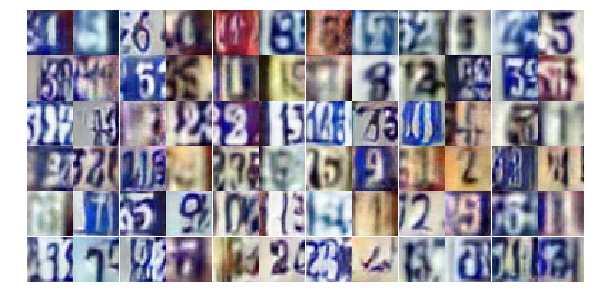

Epoch 20/25... Discriminator Loss: 0.6626... Generator Loss: 1.1895
Epoch 20/25... Discriminator Loss: 0.4268... Generator Loss: 1.5737
Epoch 20/25... Discriminator Loss: 0.9579... Generator Loss: 0.7093
Epoch 20/25... Discriminator Loss: 0.7544... Generator Loss: 1.1990
Epoch 20/25... Discriminator Loss: 0.9237... Generator Loss: 0.8244
Epoch 20/25... Discriminator Loss: 0.6565... Generator Loss: 1.0928
Epoch 20/25... Discriminator Loss: 0.8631... Generator Loss: 0.8474
Epoch 20/25... Discriminator Loss: 0.8285... Generator Loss: 0.7969
Epoch 20/25... Discriminator Loss: 0.6196... Generator Loss: 1.2761
Epoch 20/25... Discriminator Loss: 1.4016... Generator Loss: 0.4284


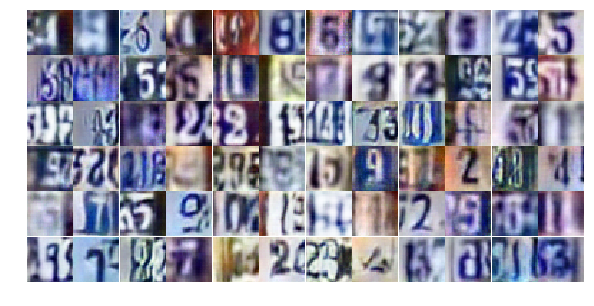

Epoch 20/25... Discriminator Loss: 0.7866... Generator Loss: 0.8684
Epoch 20/25... Discriminator Loss: 1.4199... Generator Loss: 0.4420
Epoch 20/25... Discriminator Loss: 0.5109... Generator Loss: 1.5576
Epoch 20/25... Discriminator Loss: 0.7664... Generator Loss: 0.9916
Epoch 20/25... Discriminator Loss: 1.5131... Generator Loss: 0.3683
Epoch 20/25... Discriminator Loss: 0.8031... Generator Loss: 0.8989
Epoch 20/25... Discriminator Loss: 0.9949... Generator Loss: 0.6724
Epoch 20/25... Discriminator Loss: 0.5622... Generator Loss: 1.4629
Epoch 20/25... Discriminator Loss: 0.5995... Generator Loss: 1.2069
Epoch 20/25... Discriminator Loss: 0.7983... Generator Loss: 0.8743


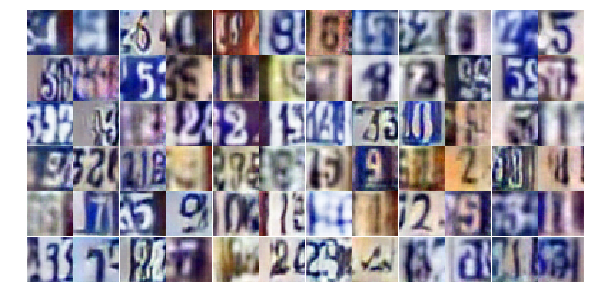

Epoch 20/25... Discriminator Loss: 0.3942... Generator Loss: 1.6489
Epoch 20/25... Discriminator Loss: 0.8463... Generator Loss: 0.8014
Epoch 20/25... Discriminator Loss: 0.4880... Generator Loss: 1.6664
Epoch 20/25... Discriminator Loss: 0.8708... Generator Loss: 1.1373
Epoch 20/25... Discriminator Loss: 0.9007... Generator Loss: 4.6737
Epoch 20/25... Discriminator Loss: 0.8896... Generator Loss: 0.7530
Epoch 21/25... Discriminator Loss: 1.1338... Generator Loss: 0.6485
Epoch 21/25... Discriminator Loss: 1.0207... Generator Loss: 0.6396
Epoch 21/25... Discriminator Loss: 1.4148... Generator Loss: 0.3921
Epoch 21/25... Discriminator Loss: 1.0784... Generator Loss: 0.6004


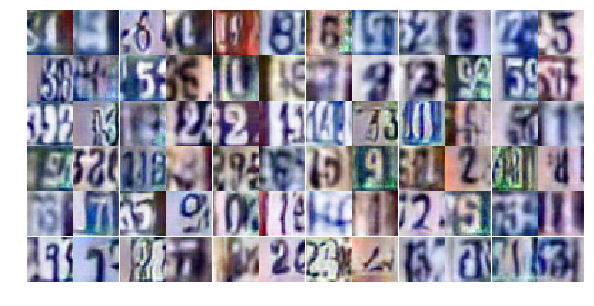

Epoch 21/25... Discriminator Loss: 0.7129... Generator Loss: 0.9733
Epoch 21/25... Discriminator Loss: 1.3484... Generator Loss: 0.4383
Epoch 21/25... Discriminator Loss: 0.5928... Generator Loss: 1.9170
Epoch 21/25... Discriminator Loss: 0.5852... Generator Loss: 1.2906
Epoch 21/25... Discriminator Loss: 0.6689... Generator Loss: 1.1157
Epoch 21/25... Discriminator Loss: 0.4893... Generator Loss: 1.6936
Epoch 21/25... Discriminator Loss: 1.0266... Generator Loss: 0.6843
Epoch 21/25... Discriminator Loss: 0.9656... Generator Loss: 0.6647
Epoch 21/25... Discriminator Loss: 0.6809... Generator Loss: 1.0186
Epoch 21/25... Discriminator Loss: 1.1656... Generator Loss: 0.5301


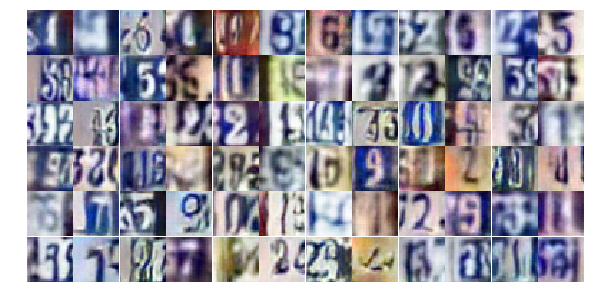

Epoch 21/25... Discriminator Loss: 0.3531... Generator Loss: 1.7038
Epoch 21/25... Discriminator Loss: 0.7102... Generator Loss: 0.9542
Epoch 21/25... Discriminator Loss: 2.2192... Generator Loss: 0.1780
Epoch 21/25... Discriminator Loss: 1.2679... Generator Loss: 0.8733
Epoch 21/25... Discriminator Loss: 0.6120... Generator Loss: 1.3578
Epoch 21/25... Discriminator Loss: 0.9045... Generator Loss: 0.7276
Epoch 21/25... Discriminator Loss: 1.0566... Generator Loss: 0.6455
Epoch 21/25... Discriminator Loss: 0.6615... Generator Loss: 1.0546
Epoch 21/25... Discriminator Loss: 0.4434... Generator Loss: 1.5262
Epoch 21/25... Discriminator Loss: 0.8165... Generator Loss: 0.8443


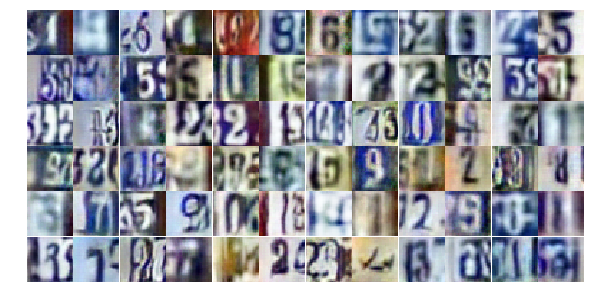

Epoch 21/25... Discriminator Loss: 0.9590... Generator Loss: 0.7506
Epoch 21/25... Discriminator Loss: 0.4344... Generator Loss: 1.4533
Epoch 21/25... Discriminator Loss: 1.2237... Generator Loss: 0.5022
Epoch 21/25... Discriminator Loss: 0.9202... Generator Loss: 0.7926
Epoch 21/25... Discriminator Loss: 0.6975... Generator Loss: 1.1058
Epoch 21/25... Discriminator Loss: 1.0823... Generator Loss: 0.6307
Epoch 21/25... Discriminator Loss: 0.6723... Generator Loss: 0.9818
Epoch 21/25... Discriminator Loss: 1.0750... Generator Loss: 0.5758
Epoch 21/25... Discriminator Loss: 1.2491... Generator Loss: 0.4771
Epoch 21/25... Discriminator Loss: 1.3245... Generator Loss: 0.5250


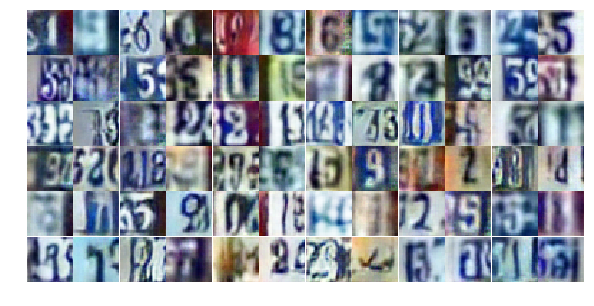

Epoch 21/25... Discriminator Loss: 0.8595... Generator Loss: 0.9210
Epoch 21/25... Discriminator Loss: 0.8384... Generator Loss: 0.9397
Epoch 21/25... Discriminator Loss: 1.2192... Generator Loss: 0.5439
Epoch 21/25... Discriminator Loss: 0.6117... Generator Loss: 1.1950
Epoch 21/25... Discriminator Loss: 0.5790... Generator Loss: 1.2267
Epoch 21/25... Discriminator Loss: 0.7346... Generator Loss: 0.9505
Epoch 21/25... Discriminator Loss: 0.9950... Generator Loss: 0.7098
Epoch 21/25... Discriminator Loss: 1.7573... Generator Loss: 0.2644
Epoch 21/25... Discriminator Loss: 0.7914... Generator Loss: 1.0180
Epoch 21/25... Discriminator Loss: 0.2940... Generator Loss: 2.3709


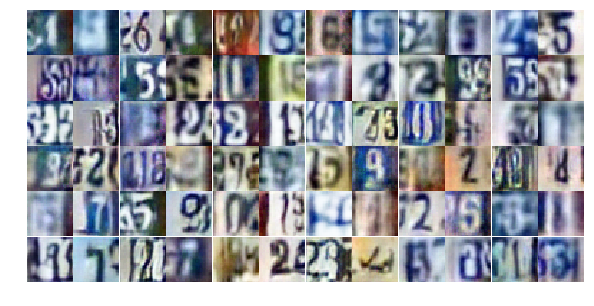

Epoch 21/25... Discriminator Loss: 0.6205... Generator Loss: 1.6996
Epoch 21/25... Discriminator Loss: 0.9959... Generator Loss: 0.7662
Epoch 21/25... Discriminator Loss: 0.6030... Generator Loss: 1.1806
Epoch 21/25... Discriminator Loss: 0.9734... Generator Loss: 0.7063
Epoch 21/25... Discriminator Loss: 0.4498... Generator Loss: 1.4811
Epoch 21/25... Discriminator Loss: 0.5467... Generator Loss: 1.2558
Epoch 21/25... Discriminator Loss: 1.2236... Generator Loss: 0.5059
Epoch 21/25... Discriminator Loss: 1.1198... Generator Loss: 0.5400
Epoch 21/25... Discriminator Loss: 1.0276... Generator Loss: 0.6922
Epoch 21/25... Discriminator Loss: 0.5768... Generator Loss: 1.1714


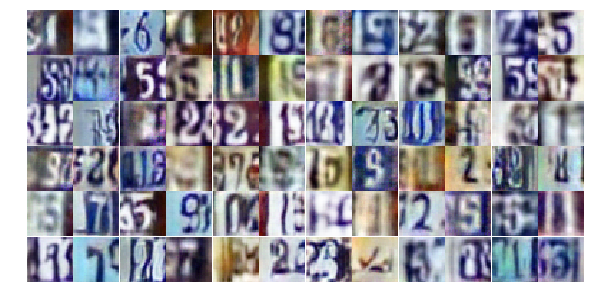

Epoch 21/25... Discriminator Loss: 0.5535... Generator Loss: 1.6614
Epoch 21/25... Discriminator Loss: 1.8054... Generator Loss: 0.2756
Epoch 21/25... Discriminator Loss: 0.5657... Generator Loss: 1.4696
Epoch 22/25... Discriminator Loss: 0.6783... Generator Loss: 1.6716
Epoch 22/25... Discriminator Loss: 0.8433... Generator Loss: 2.0332
Epoch 22/25... Discriminator Loss: 0.8204... Generator Loss: 0.8616
Epoch 22/25... Discriminator Loss: 0.4913... Generator Loss: 1.5861
Epoch 22/25... Discriminator Loss: 0.3775... Generator Loss: 1.5851
Epoch 22/25... Discriminator Loss: 1.0928... Generator Loss: 0.6066
Epoch 22/25... Discriminator Loss: 0.8594... Generator Loss: 0.7768


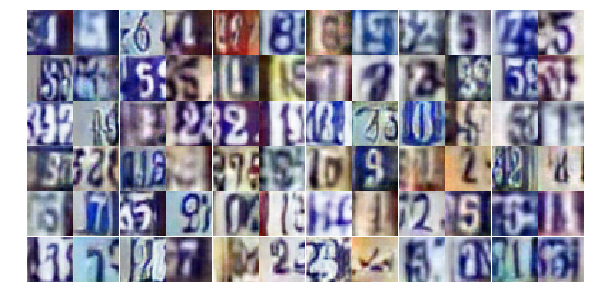

Epoch 22/25... Discriminator Loss: 0.6385... Generator Loss: 1.1569
Epoch 22/25... Discriminator Loss: 0.8428... Generator Loss: 0.9710
Epoch 22/25... Discriminator Loss: 1.2650... Generator Loss: 0.5555
Epoch 22/25... Discriminator Loss: 0.5651... Generator Loss: 1.2244
Epoch 22/25... Discriminator Loss: 0.6731... Generator Loss: 1.2206
Epoch 22/25... Discriminator Loss: 0.6069... Generator Loss: 2.4186
Epoch 22/25... Discriminator Loss: 0.7728... Generator Loss: 0.9706
Epoch 22/25... Discriminator Loss: 0.5357... Generator Loss: 1.3854
Epoch 22/25... Discriminator Loss: 1.4330... Generator Loss: 0.4728
Epoch 22/25... Discriminator Loss: 1.7968... Generator Loss: 0.2896


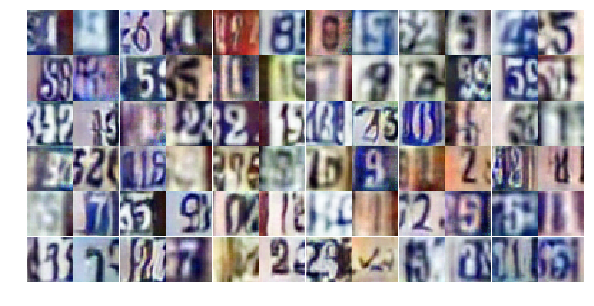

Epoch 22/25... Discriminator Loss: 0.5711... Generator Loss: 2.7041
Epoch 22/25... Discriminator Loss: 0.5767... Generator Loss: 1.5918
Epoch 22/25... Discriminator Loss: 1.0163... Generator Loss: 0.7019
Epoch 22/25... Discriminator Loss: 0.4155... Generator Loss: 1.9402
Epoch 22/25... Discriminator Loss: 0.5073... Generator Loss: 2.1007
Epoch 22/25... Discriminator Loss: 1.5177... Generator Loss: 0.3836
Epoch 22/25... Discriminator Loss: 0.5596... Generator Loss: 1.6964
Epoch 22/25... Discriminator Loss: 0.3916... Generator Loss: 1.5591
Epoch 22/25... Discriminator Loss: 0.5330... Generator Loss: 1.2069
Epoch 22/25... Discriminator Loss: 1.0159... Generator Loss: 0.7575


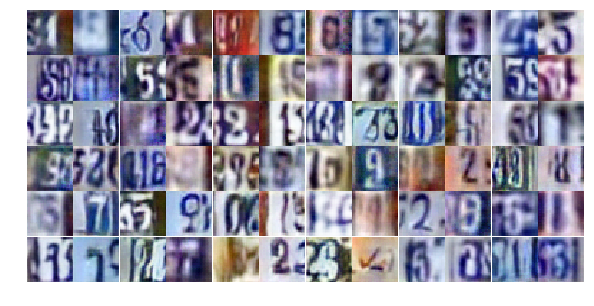

Epoch 22/25... Discriminator Loss: 0.5976... Generator Loss: 1.1377
Epoch 22/25... Discriminator Loss: 0.6778... Generator Loss: 1.0377
Epoch 22/25... Discriminator Loss: 1.0957... Generator Loss: 0.6654
Epoch 22/25... Discriminator Loss: 0.7603... Generator Loss: 0.8534
Epoch 22/25... Discriminator Loss: 0.7841... Generator Loss: 0.8891
Epoch 22/25... Discriminator Loss: 1.0725... Generator Loss: 0.5941
Epoch 22/25... Discriminator Loss: 1.4052... Generator Loss: 0.4910
Epoch 22/25... Discriminator Loss: 0.6643... Generator Loss: 2.0293
Epoch 22/25... Discriminator Loss: 0.9060... Generator Loss: 3.2689
Epoch 22/25... Discriminator Loss: 1.7731... Generator Loss: 0.3306


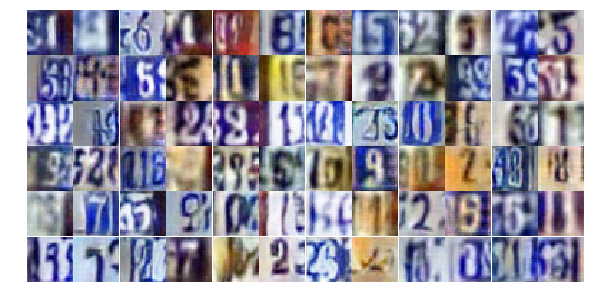

Epoch 22/25... Discriminator Loss: 1.0235... Generator Loss: 0.7516
Epoch 22/25... Discriminator Loss: 0.5102... Generator Loss: 1.3839
Epoch 22/25... Discriminator Loss: 0.4300... Generator Loss: 1.5250
Epoch 22/25... Discriminator Loss: 0.6027... Generator Loss: 1.2442
Epoch 22/25... Discriminator Loss: 0.5390... Generator Loss: 1.2499
Epoch 22/25... Discriminator Loss: 0.6023... Generator Loss: 1.2237
Epoch 22/25... Discriminator Loss: 0.7970... Generator Loss: 0.9301
Epoch 22/25... Discriminator Loss: 0.6082... Generator Loss: 1.5471
Epoch 22/25... Discriminator Loss: 0.8192... Generator Loss: 0.8919
Epoch 22/25... Discriminator Loss: 0.7196... Generator Loss: 0.9285


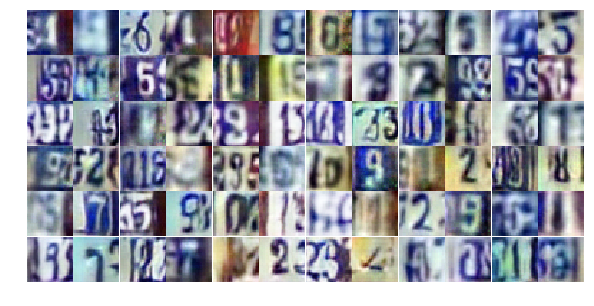

Epoch 22/25... Discriminator Loss: 0.8701... Generator Loss: 0.7584
Epoch 22/25... Discriminator Loss: 0.4926... Generator Loss: 1.3401
Epoch 22/25... Discriminator Loss: 0.6092... Generator Loss: 1.1165
Epoch 22/25... Discriminator Loss: 0.7083... Generator Loss: 1.3055
Epoch 22/25... Discriminator Loss: 0.6966... Generator Loss: 0.9751
Epoch 22/25... Discriminator Loss: 0.7906... Generator Loss: 1.0877
Epoch 22/25... Discriminator Loss: 0.7604... Generator Loss: 1.2681
Epoch 22/25... Discriminator Loss: 0.8143... Generator Loss: 0.8114
Epoch 22/25... Discriminator Loss: 1.1406... Generator Loss: 2.4311
Epoch 22/25... Discriminator Loss: 0.9500... Generator Loss: 0.8513


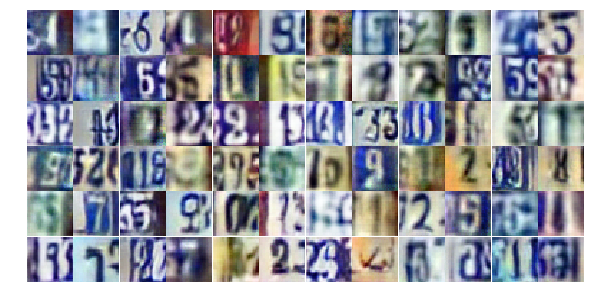

Epoch 23/25... Discriminator Loss: 0.4593... Generator Loss: 1.6649
Epoch 23/25... Discriminator Loss: 0.5943... Generator Loss: 1.1146
Epoch 23/25... Discriminator Loss: 0.6279... Generator Loss: 1.4085
Epoch 23/25... Discriminator Loss: 0.4886... Generator Loss: 1.3110
Epoch 23/25... Discriminator Loss: 0.7764... Generator Loss: 1.0629
Epoch 23/25... Discriminator Loss: 1.2053... Generator Loss: 0.5446
Epoch 23/25... Discriminator Loss: 0.8865... Generator Loss: 0.9264
Epoch 23/25... Discriminator Loss: 0.8371... Generator Loss: 0.7983
Epoch 23/25... Discriminator Loss: 0.5887... Generator Loss: 1.2855
Epoch 23/25... Discriminator Loss: 0.4403... Generator Loss: 1.4460


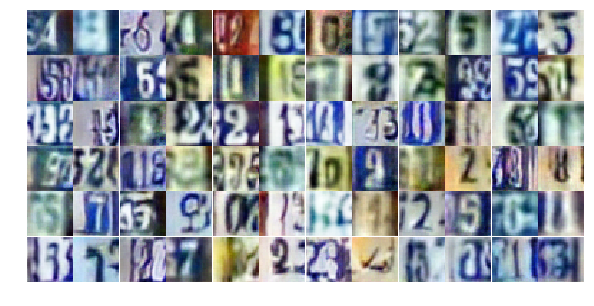

Epoch 23/25... Discriminator Loss: 0.5602... Generator Loss: 1.2312
Epoch 23/25... Discriminator Loss: 1.1858... Generator Loss: 0.5663
Epoch 23/25... Discriminator Loss: 0.7811... Generator Loss: 0.8910
Epoch 23/25... Discriminator Loss: 0.5380... Generator Loss: 1.4136
Epoch 23/25... Discriminator Loss: 0.4088... Generator Loss: 1.7686
Epoch 23/25... Discriminator Loss: 0.9746... Generator Loss: 2.5107
Epoch 23/25... Discriminator Loss: 0.8503... Generator Loss: 0.8904
Epoch 23/25... Discriminator Loss: 1.0790... Generator Loss: 0.7207
Epoch 23/25... Discriminator Loss: 1.2043... Generator Loss: 0.5380
Epoch 23/25... Discriminator Loss: 0.6092... Generator Loss: 1.2093


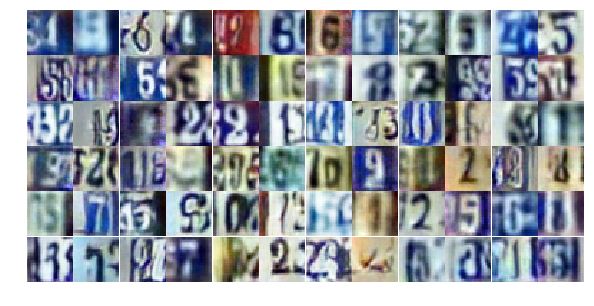

Epoch 23/25... Discriminator Loss: 0.9410... Generator Loss: 0.7690
Epoch 23/25... Discriminator Loss: 0.4525... Generator Loss: 1.8862
Epoch 23/25... Discriminator Loss: 1.7056... Generator Loss: 0.3877
Epoch 23/25... Discriminator Loss: 0.8990... Generator Loss: 0.7644
Epoch 23/25... Discriminator Loss: 0.6003... Generator Loss: 1.2340
Epoch 23/25... Discriminator Loss: 0.7151... Generator Loss: 1.1854
Epoch 23/25... Discriminator Loss: 1.0235... Generator Loss: 0.6702
Epoch 23/25... Discriminator Loss: 1.0736... Generator Loss: 0.6102
Epoch 23/25... Discriminator Loss: 0.5657... Generator Loss: 1.3393
Epoch 23/25... Discriminator Loss: 0.7650... Generator Loss: 1.2600


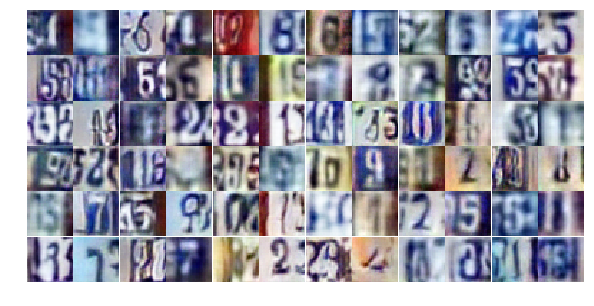

Epoch 23/25... Discriminator Loss: 0.6070... Generator Loss: 1.1354
Epoch 23/25... Discriminator Loss: 0.6025... Generator Loss: 1.2736
Epoch 23/25... Discriminator Loss: 0.7447... Generator Loss: 1.0064
Epoch 23/25... Discriminator Loss: 1.1473... Generator Loss: 0.5653
Epoch 23/25... Discriminator Loss: 1.1144... Generator Loss: 0.5829
Epoch 23/25... Discriminator Loss: 0.9196... Generator Loss: 0.7699
Epoch 23/25... Discriminator Loss: 1.0692... Generator Loss: 0.5672
Epoch 23/25... Discriminator Loss: 0.8274... Generator Loss: 0.8357
Epoch 23/25... Discriminator Loss: 0.3998... Generator Loss: 1.6430
Epoch 23/25... Discriminator Loss: 0.6745... Generator Loss: 1.0662


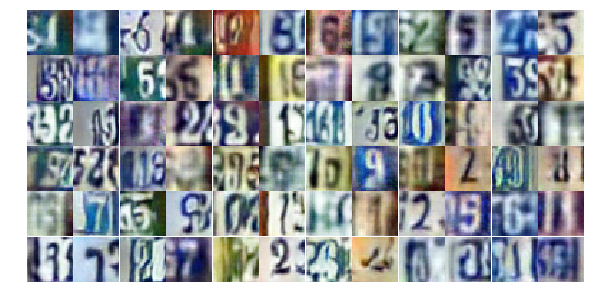

Epoch 23/25... Discriminator Loss: 0.9721... Generator Loss: 0.7232
Epoch 23/25... Discriminator Loss: 0.5960... Generator Loss: 1.4081
Epoch 23/25... Discriminator Loss: 0.6492... Generator Loss: 1.1393
Epoch 23/25... Discriminator Loss: 1.0370... Generator Loss: 0.6986
Epoch 23/25... Discriminator Loss: 1.4260... Generator Loss: 0.6253
Epoch 23/25... Discriminator Loss: 0.7399... Generator Loss: 2.9235
Epoch 23/25... Discriminator Loss: 0.7086... Generator Loss: 1.2108
Epoch 23/25... Discriminator Loss: 1.2517... Generator Loss: 0.4928
Epoch 23/25... Discriminator Loss: 0.5890... Generator Loss: 1.2911
Epoch 23/25... Discriminator Loss: 0.5819... Generator Loss: 1.3335


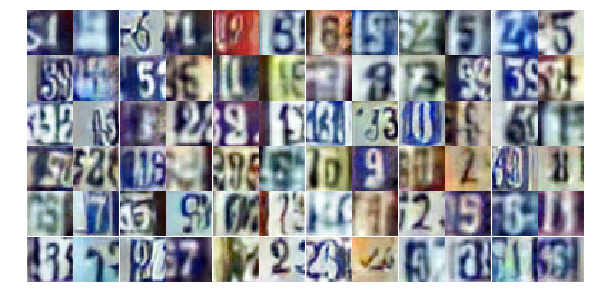

Epoch 23/25... Discriminator Loss: 0.8501... Generator Loss: 0.8401
Epoch 23/25... Discriminator Loss: 1.6004... Generator Loss: 0.4167
Epoch 23/25... Discriminator Loss: 0.9119... Generator Loss: 0.7503
Epoch 23/25... Discriminator Loss: 0.2833... Generator Loss: 2.1558
Epoch 23/25... Discriminator Loss: 1.0626... Generator Loss: 0.6643
Epoch 23/25... Discriminator Loss: 0.6552... Generator Loss: 1.9402
Epoch 23/25... Discriminator Loss: 1.2737... Generator Loss: 0.5213
Epoch 24/25... Discriminator Loss: 0.8090... Generator Loss: 0.8088
Epoch 24/25... Discriminator Loss: 0.9246... Generator Loss: 0.8479
Epoch 24/25... Discriminator Loss: 0.8420... Generator Loss: 1.5972


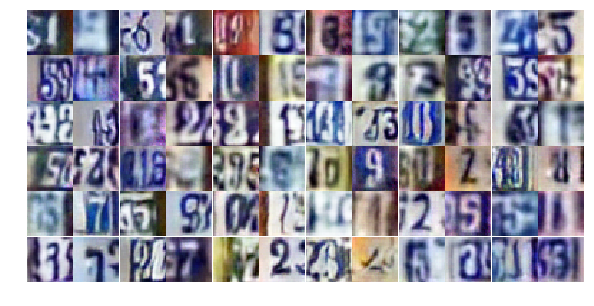

Epoch 24/25... Discriminator Loss: 0.5606... Generator Loss: 1.5061
Epoch 24/25... Discriminator Loss: 0.6703... Generator Loss: 0.9793
Epoch 24/25... Discriminator Loss: 0.6791... Generator Loss: 1.0266
Epoch 24/25... Discriminator Loss: 0.5584... Generator Loss: 2.0535
Epoch 24/25... Discriminator Loss: 0.5681... Generator Loss: 1.1590
Epoch 24/25... Discriminator Loss: 0.7622... Generator Loss: 0.8882
Epoch 24/25... Discriminator Loss: 0.5234... Generator Loss: 1.2912
Epoch 24/25... Discriminator Loss: 1.4994... Generator Loss: 0.3896
Epoch 24/25... Discriminator Loss: 0.2891... Generator Loss: 1.9602
Epoch 24/25... Discriminator Loss: 0.3837... Generator Loss: 2.1747


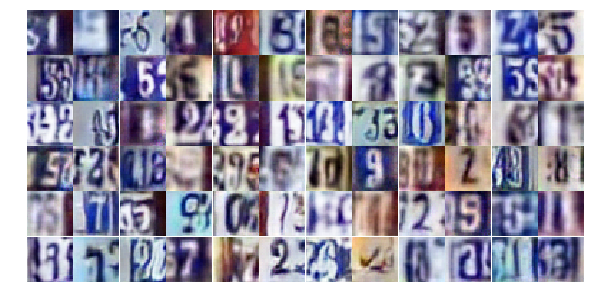

Epoch 24/25... Discriminator Loss: 1.1530... Generator Loss: 0.5797
Epoch 24/25... Discriminator Loss: 0.9094... Generator Loss: 0.7950
Epoch 24/25... Discriminator Loss: 0.7653... Generator Loss: 1.0632
Epoch 24/25... Discriminator Loss: 0.9053... Generator Loss: 0.7507
Epoch 24/25... Discriminator Loss: 0.9404... Generator Loss: 3.3957
Epoch 24/25... Discriminator Loss: 1.1823... Generator Loss: 2.5987
Epoch 24/25... Discriminator Loss: 0.4618... Generator Loss: 1.6739
Epoch 24/25... Discriminator Loss: 0.9710... Generator Loss: 0.7583
Epoch 24/25... Discriminator Loss: 1.0910... Generator Loss: 0.7317
Epoch 24/25... Discriminator Loss: 0.6883... Generator Loss: 1.1179


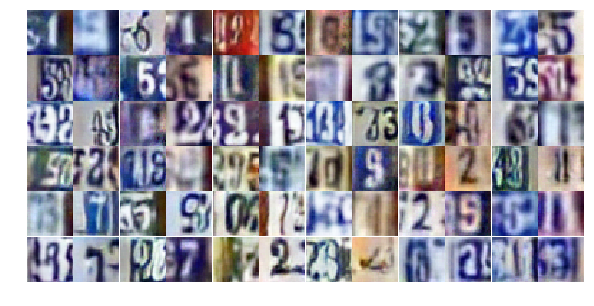

Epoch 24/25... Discriminator Loss: 1.0736... Generator Loss: 0.7410
Epoch 24/25... Discriminator Loss: 0.5934... Generator Loss: 1.1724
Epoch 24/25... Discriminator Loss: 0.5122... Generator Loss: 1.4582
Epoch 24/25... Discriminator Loss: 1.3441... Generator Loss: 0.5141
Epoch 24/25... Discriminator Loss: 0.6543... Generator Loss: 1.1074
Epoch 24/25... Discriminator Loss: 0.8570... Generator Loss: 0.9026
Epoch 24/25... Discriminator Loss: 0.4951... Generator Loss: 1.2604
Epoch 24/25... Discriminator Loss: 0.5655... Generator Loss: 1.4176
Epoch 24/25... Discriminator Loss: 0.8046... Generator Loss: 0.8322
Epoch 24/25... Discriminator Loss: 1.3863... Generator Loss: 0.5140


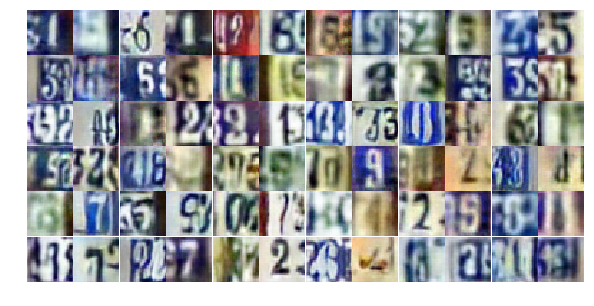

Epoch 24/25... Discriminator Loss: 0.6117... Generator Loss: 1.1173
Epoch 24/25... Discriminator Loss: 0.4270... Generator Loss: 1.9006
Epoch 24/25... Discriminator Loss: 0.6597... Generator Loss: 1.4092
Epoch 24/25... Discriminator Loss: 1.4074... Generator Loss: 0.4372
Epoch 24/25... Discriminator Loss: 1.2646... Generator Loss: 0.4719
Epoch 24/25... Discriminator Loss: 1.0492... Generator Loss: 0.6445
Epoch 24/25... Discriminator Loss: 1.1769... Generator Loss: 0.5357
Epoch 24/25... Discriminator Loss: 1.0117... Generator Loss: 0.5989
Epoch 24/25... Discriminator Loss: 1.0923... Generator Loss: 0.6316
Epoch 24/25... Discriminator Loss: 0.6455... Generator Loss: 1.4423


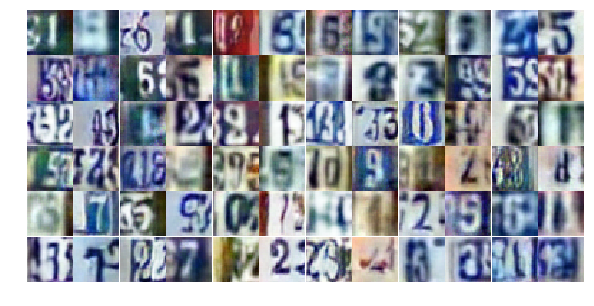

Epoch 24/25... Discriminator Loss: 0.6333... Generator Loss: 1.6553
Epoch 24/25... Discriminator Loss: 1.5765... Generator Loss: 1.2454
Epoch 24/25... Discriminator Loss: 1.7496... Generator Loss: 0.3245
Epoch 24/25... Discriminator Loss: 1.4283... Generator Loss: 0.4829
Epoch 24/25... Discriminator Loss: 1.2223... Generator Loss: 0.4922
Epoch 24/25... Discriminator Loss: 0.7100... Generator Loss: 0.9791
Epoch 24/25... Discriminator Loss: 1.1221... Generator Loss: 0.5634
Epoch 24/25... Discriminator Loss: 0.6735... Generator Loss: 1.0571
Epoch 24/25... Discriminator Loss: 0.4987... Generator Loss: 1.6682
Epoch 24/25... Discriminator Loss: 0.8858... Generator Loss: 0.7957


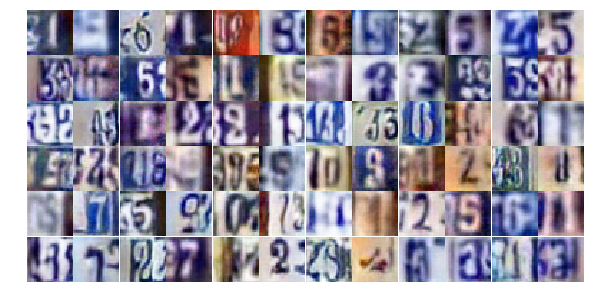

Epoch 24/25... Discriminator Loss: 1.0052... Generator Loss: 0.6781
Epoch 24/25... Discriminator Loss: 1.2747... Generator Loss: 0.4920
Epoch 24/25... Discriminator Loss: 0.7071... Generator Loss: 1.0037
Epoch 24/25... Discriminator Loss: 0.6650... Generator Loss: 1.4610
Epoch 24/25... Discriminator Loss: 1.5565... Generator Loss: 0.3805
Epoch 25/25... Discriminator Loss: 0.8093... Generator Loss: 1.0155
Epoch 25/25... Discriminator Loss: 0.5150... Generator Loss: 1.3210
Epoch 25/25... Discriminator Loss: 1.0833... Generator Loss: 0.6790
Epoch 25/25... Discriminator Loss: 0.8746... Generator Loss: 0.7879
Epoch 25/25... Discriminator Loss: 0.8458... Generator Loss: 0.9495


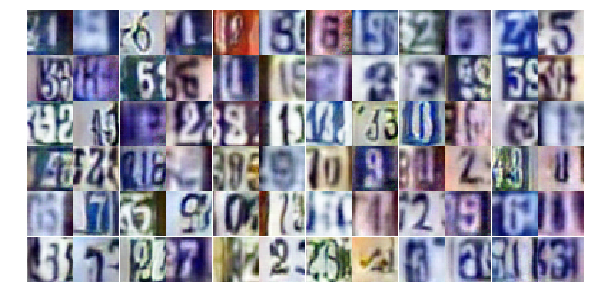

Epoch 25/25... Discriminator Loss: 0.7574... Generator Loss: 0.9522
Epoch 25/25... Discriminator Loss: 1.1486... Generator Loss: 0.5350
Epoch 25/25... Discriminator Loss: 0.9285... Generator Loss: 0.7375
Epoch 25/25... Discriminator Loss: 0.8866... Generator Loss: 0.8029
Epoch 25/25... Discriminator Loss: 0.8059... Generator Loss: 2.3092
Epoch 25/25... Discriminator Loss: 0.9142... Generator Loss: 0.7541
Epoch 25/25... Discriminator Loss: 0.7968... Generator Loss: 0.8468
Epoch 25/25... Discriminator Loss: 0.6194... Generator Loss: 1.1761
Epoch 25/25... Discriminator Loss: 0.4289... Generator Loss: 1.5552
Epoch 25/25... Discriminator Loss: 0.5943... Generator Loss: 1.1708


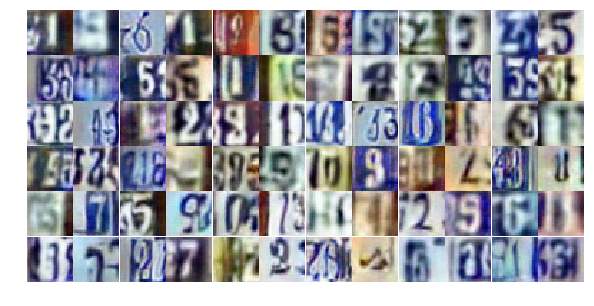

Epoch 25/25... Discriminator Loss: 0.7869... Generator Loss: 0.8691
Epoch 25/25... Discriminator Loss: 0.5320... Generator Loss: 1.3802
Epoch 25/25... Discriminator Loss: 0.6520... Generator Loss: 1.1118
Epoch 25/25... Discriminator Loss: 0.9634... Generator Loss: 0.8393
Epoch 25/25... Discriminator Loss: 0.5675... Generator Loss: 1.5046
Epoch 25/25... Discriminator Loss: 0.7031... Generator Loss: 1.2007
Epoch 25/25... Discriminator Loss: 3.3012... Generator Loss: 4.6537
Epoch 25/25... Discriminator Loss: 1.8025... Generator Loss: 0.3754
Epoch 25/25... Discriminator Loss: 0.8470... Generator Loss: 0.8387
Epoch 25/25... Discriminator Loss: 1.2177... Generator Loss: 0.5535


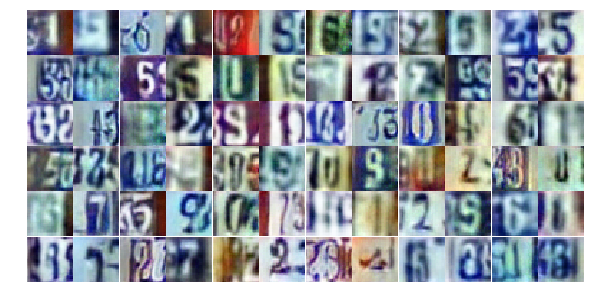

Epoch 25/25... Discriminator Loss: 0.9098... Generator Loss: 0.8132
Epoch 25/25... Discriminator Loss: 0.4741... Generator Loss: 1.3714
Epoch 25/25... Discriminator Loss: 0.7993... Generator Loss: 0.9208
Epoch 25/25... Discriminator Loss: 0.6671... Generator Loss: 1.1543
Epoch 25/25... Discriminator Loss: 1.2006... Generator Loss: 0.6014
Epoch 25/25... Discriminator Loss: 0.4832... Generator Loss: 1.4110
Epoch 25/25... Discriminator Loss: 0.7416... Generator Loss: 1.0223
Epoch 25/25... Discriminator Loss: 0.6988... Generator Loss: 1.0104
Epoch 25/25... Discriminator Loss: 1.0973... Generator Loss: 0.6230
Epoch 25/25... Discriminator Loss: 0.4802... Generator Loss: 1.5100


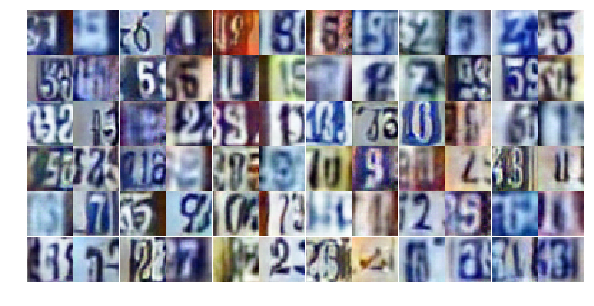

Epoch 25/25... Discriminator Loss: 0.9506... Generator Loss: 0.6869
Epoch 25/25... Discriminator Loss: 0.8208... Generator Loss: 0.8362
Epoch 25/25... Discriminator Loss: 0.5756... Generator Loss: 1.1460
Epoch 25/25... Discriminator Loss: 0.8779... Generator Loss: 0.7868
Epoch 25/25... Discriminator Loss: 0.9993... Generator Loss: 0.7900
Epoch 25/25... Discriminator Loss: 1.3848... Generator Loss: 0.4136
Epoch 25/25... Discriminator Loss: 0.4321... Generator Loss: 1.5134
Epoch 25/25... Discriminator Loss: 0.6803... Generator Loss: 0.9878
Epoch 25/25... Discriminator Loss: 1.4041... Generator Loss: 0.5185
Epoch 25/25... Discriminator Loss: 0.5755... Generator Loss: 1.1941


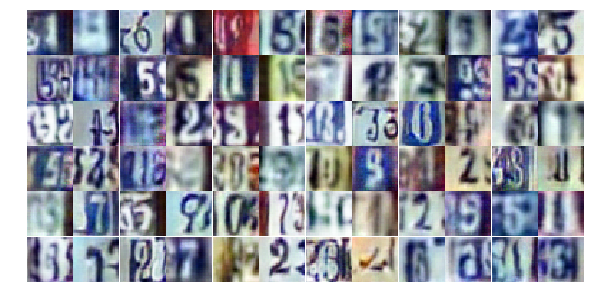

Epoch 25/25... Discriminator Loss: 0.7300... Generator Loss: 1.3388
Epoch 25/25... Discriminator Loss: 0.7692... Generator Loss: 0.9247
Epoch 25/25... Discriminator Loss: 0.8743... Generator Loss: 1.0256
Epoch 25/25... Discriminator Loss: 1.7623... Generator Loss: 0.3148
Epoch 25/25... Discriminator Loss: 1.4735... Generator Loss: 0.3852
Epoch 25/25... Discriminator Loss: 0.5389... Generator Loss: 2.1418
Epoch 25/25... Discriminator Loss: 2.0348... Generator Loss: 0.2154
Epoch 25/25... Discriminator Loss: 0.7631... Generator Loss: 0.8709
Epoch 25/25... Discriminator Loss: 0.6244... Generator Loss: 1.5314
Epoch 25/25... Discriminator Loss: 0.9391... Generator Loss: 0.7789


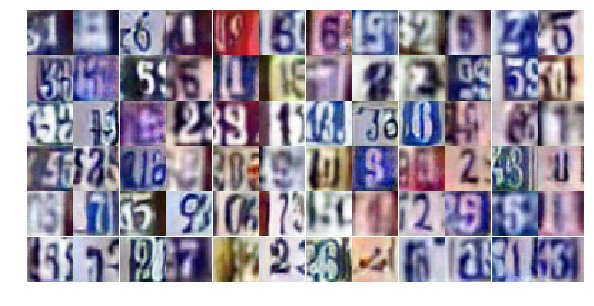

Epoch 25/25... Discriminator Loss: 0.5517... Generator Loss: 1.5679
Epoch 25/25... Discriminator Loss: 1.5341... Generator Loss: 0.3761


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))